In [96]:
import matplotlib.pylab as pylab
pylab.rcParams['figure.figsize'] = 30, 20  # that's default image size for this interactive session

$$\begin{eqnarray}
x_1^2 + x_2^2 + 1 - 0.1 \cos ( 16 \arctan (\frac{x_1}{x_2})) \ge 0 \\
\end{eqnarray}$$

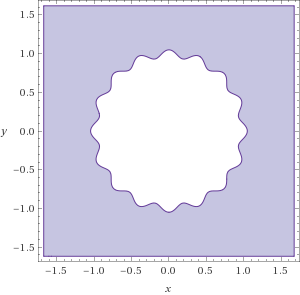

In [191]:
from IPython.display import Image
Image(filename='constraint1.jpg')

$$\begin{eqnarray}
(x_1 - 0.5)^2 + (x_2 - 0.5)^2 \le 0.5 \\
\end{eqnarray}$$

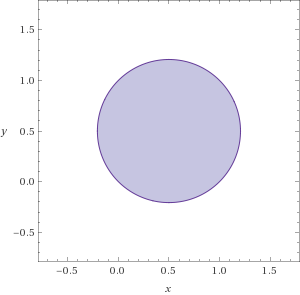

In [19]:
Image(filename='constraint2.jpg')

$$\begin{eqnarray}
0 \le x_1 , x_2 \le \pi \\
\end{eqnarray}$$

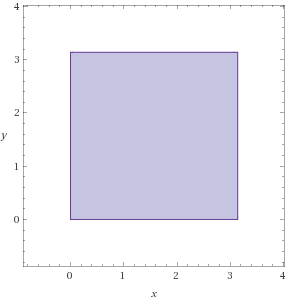

In [20]:
Image(filename='Bounds.jpg')

$$\begin{eqnarray}
0 \le x_1 , x_2 \le \pi \\
(x_1 - 0.5)^2 + (x_2 - 0.5)^2 \le 0.5 \\
\end{eqnarray}$$

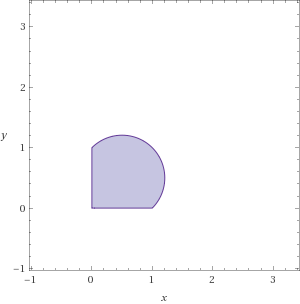

In [21]:
Image(filename='half_constraint.jpg')

$$\begin{eqnarray}
0 \le x_1 , x_2 \le \pi \\
(x_1 - 0.5)^2 + (x_2 - 0.5)^2 \le 0.5 \\
x_1^2 + x_2^2 + 1 - 0.1 \cos ( 16 \arctan (\frac{x_1}{x_2})) \ge 0 \\
\end{eqnarray}$$

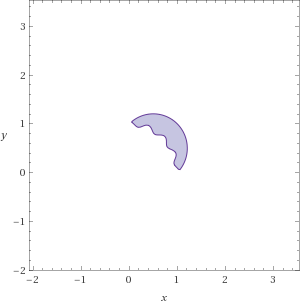

In [22]:
Image(filename='full_constraint.jpg')

In [23]:
from __future__ import division

import inspyred
import random
import matplotlib.pyplot as plt
import math

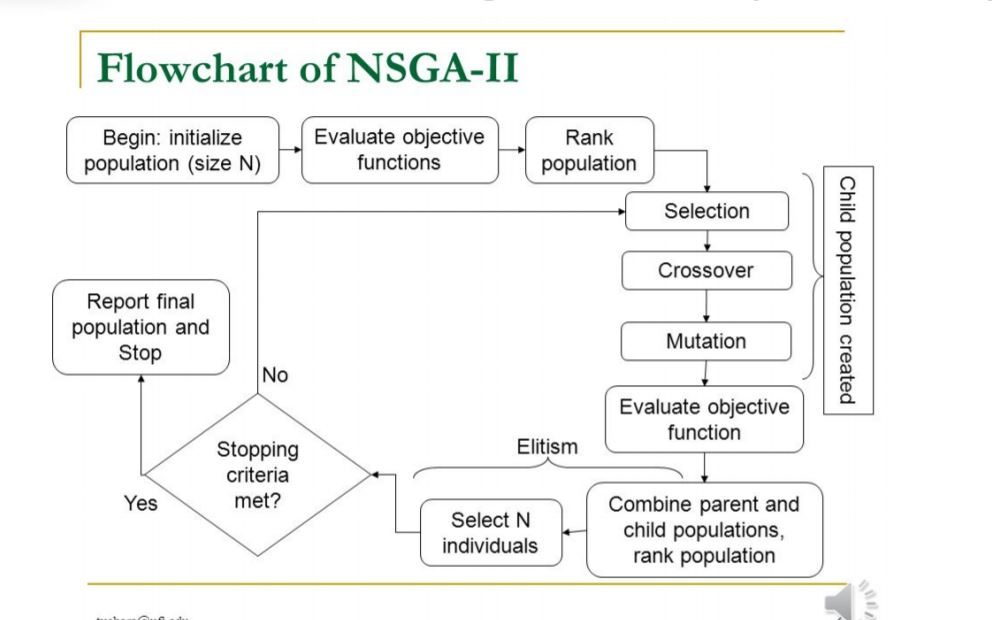

In [193]:
Image(filename='NSGA_flowchart.jpg')

In [24]:
def my_generator(random, args):
    return [random.uniform(1e-32, 3.14) for _ in range(2)]

In [25]:
@inspyred.ec.evaluators.evaluator
def my_evaluator(candidate, args):
    x1 = candidate[0]
    x2 = candidate[1]
    c1 = x1 ** 2 + x2 ** 2 - 1 - 0.1 * math.cos(16*math.atan(x1/x2))
    c2 = (x1 - 0.5) ** 2 + (x2 - 0.5) ** 2
    
    if c1 < 0:
        x1 += 3.14 + abs(c1)
        x2 += 3.14 + abs(c1)
    if c2 > 0.5:
        x1 += 3.14 + (c2 - 0.5)
        x2 += 3.14 + (c2 - 0.5)
    return inspyred.ec.emo.Pareto([x1, x2])

In [37]:
def NSGA2(pop):
    randseed = 12345
    prng = random.Random(randseed)
    ea = inspyred.ec.emo.NSGA2(prng)
    ea.variator = [inspyred.ec.variators.blend_crossover,
                   inspyred.ec.variators.gaussian_mutation]
    ea.terminator = inspyred.ec.terminators.evaluation_termination
    ea.observer = [inspyred.ec.observers.archive_observer]
    final_pop = ea.evolve(generator=my_generator,
                          evaluator=my_evaluator,
                          pop_size=pop,
                          maximize=False,
                          bounder=inspyred.ec.Bounder(1e-32, 3.14),
                          max_evaluations=5000)
    return ea

In [43]:
def display_graph(ea):
    final_arc = ea.archive
    x = []
    y = []
    for f in final_arc:
        x.append(f.fitness[0])
        y.append(f.fitness[1])
    _=plt.scatter(x, y, color='b')
    _=plt.xlabel("Function 1")
    _=plt.ylabel("Function 2")
    # Plot and save in pdf format
    # plt.savefig('pf.pdf',format='pdf')
    plt.show()

In [39]:
ea_10 = NSGA2(10)
ea_100 = NSGA2(100)
ea_1000 = NSGA2(1000)

----------------------------------------------------------------------------
                         Archive (    1 individuals)
----------------------------------------------------------------------------
[1.1568127049938137, 0.6080966360015332] : [1.1568127049938137, 0.6080966360015332]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (    1 individuals)
----------------------------------------------------------------------------
[1.1568127049938137, 0.6080966360015332] : [1.1568127049938137, 0.6080966360015332]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (    2 individuals)
----------------------------------------------------------------------------
[1.1568127049938137, 0.6080966360015332] : [1.15681270499

[0.9204548055773247, 0.45784682774018237] : [0.9204548055773247, 0.45784682774018237]
[0.9204664950346997, 0.4575366622881815] : [0.9204664950346997, 0.4575366622881815]
[0.9204547361686425, 0.45788287812156847] : [0.9204547361686425, 0.45788287812156847]
[0.8437940836349156, 0.5014283024973442] : [0.8437940836349156, 0.5014283024973442]
[0.8275630169281862, 0.5313418719236879] : [0.8275630169281862, 0.5313418719236879]
[0.9204618811178499, 0.45767823078691006] : [0.9204618811178499, 0.45767823078691006]
[0.8025668082395524, 0.6239072309708356] : [0.8025668082395524, 0.6239072309708356]
[0.8775105650379379, 0.487558737610143] : [0.8775105650379379, 0.487558737610143]
[0.9004068529233771, 0.4666242389568242] : [0.9004068529233771, 0.4666242389568242]
[0.8000089737909696, 0.6432870052509518] : [0.8000089737909696, 0.6432870052509518]
[0.9139777575313057, 0.4619244777892719] : [0.9139777575313057, 0.4619244777892719]
[0.8353692796330293, 0.509494337498632] : [0.8353692796330293, 0.5094943

----------------------------------------------------------------------------
[0.9170824352817372, 0.4546395489976081] : [0.9170824352817372, 0.4546395489976081]
[0.9119669345410526, 0.45834649761619106] : [0.9119669345410526, 0.45834649761619106]
[0.9107383988162248, 0.4606180666580682] : [0.9107383988162248, 0.4606180666580682]
[0.8153960135175313, 0.502329094082285] : [0.8153960135175313, 0.502329094082285]
[0.819010300272585, 0.5009556873096229] : [0.819010300272585, 0.5009556873096229]
[0.8373084502318687, 0.49323273015447405] : [0.8373084502318687, 0.49323273015447405]
[0.7990139762366485, 0.519334898331887] : [0.7990139762366485, 0.519334898331887]
[0.8389930018959784, 0.4912534675806388] : [0.8389930018959784, 0.4912534675806388]
[0.8660922478834211, 0.4806013863673968] : [0.8660922478834211, 0.4806013863673968]
[0.8258071810628032, 0.49639840541378494] : [0.8258071810628032, 0.49639840541378494]
[0.8962538081017568, 0.466055067234738] : [0.8962538081017568, 0.466055067234738]
[

[0.805361225160021, 0.513602083114502] : [0.805361225160021, 0.513602083114502]
[0.8489611818500487, 0.48680847983877296] : [0.8489611818500487, 0.48680847983877296]
[0.8771603116620762, 0.47565028798446934] : [0.8771603116620762, 0.47565028798446934]
[0.8868812273954272, 0.47020095145431173] : [0.8868812273954272, 0.47020095145431173]
[0.8999883406913458, 0.46413003125309454] : [0.8999883406913458, 0.46413003125309454]
[0.8472929966935637, 0.4868540259963886] : [0.8472929966935637, 0.4868540259963886]
[0.7958557650918101, 0.5212948065714536] : [0.7958557650918101, 0.5212948065714536]
[0.8175987114859466, 0.5020551786510142] : [0.8175987114859466, 0.5020551786510142]
[0.8498881380991505, 0.48610353511501714] : [0.8498881380991505, 0.48610353511501714]
[0.8204113864350424, 0.5008274598079466] : [0.8204113864350424, 0.5008274598079466]
[0.7948970299807844, 0.5228845758489347] : [0.7948970299807844, 0.5228845758489347]
[0.790586525478632, 0.5289742056102393] : [0.790586525478632, 0.528974

----------------------------------------------------------------------------
                         Archive (   48 individuals)
----------------------------------------------------------------------------
[0.9170824352817372, 0.4546395489976081] : [0.9170824352817372, 0.4546395489976081]
[0.9119669345410526, 0.45834649761619106] : [0.9119669345410526, 0.45834649761619106]
[0.9107383988162248, 0.4606180666580682] : [0.9107383988162248, 0.4606180666580682]
[0.8153960135175313, 0.502329094082285] : [0.8153960135175313, 0.502329094082285]
[0.819010300272585, 0.5009556873096229] : [0.819010300272585, 0.5009556873096229]
[0.8389930018959784, 0.4912534675806388] : [0.8389930018959784, 0.4912534675806388]
[0.8258071810628032, 0.49639840541378494] : [0.8258071810628032, 0.49639840541378494]
[0.8962538081017568, 0.466055067234738] : [0.8962538081017568, 0.466055067234738]
[0.8587641773657612, 0.48159125922956253] : [0.8587641773657612, 0.48159125922956253]
[0.9038590083874399, 0.46386605496573

[0.8587641773657612, 0.48159125922956253] : [0.8587641773657612, 0.48159125922956253]
[0.8913860011614403, 0.4693529617494284] : [0.8913860011614403, 0.4693529617494284]
[0.7832918487837189, 0.5461977694221195] : [0.7832918487837189, 0.5461977694221195]
[0.805361225160021, 0.513602083114502] : [0.805361225160021, 0.513602083114502]
[0.8489611818500487, 0.48680847983877296] : [0.8489611818500487, 0.48680847983877296]
[0.8771603116620762, 0.47565028798446934] : [0.8771603116620762, 0.47565028798446934]
[0.8868812273954272, 0.47020095145431173] : [0.8868812273954272, 0.47020095145431173]
[0.8999883406913458, 0.46413003125309454] : [0.8999883406913458, 0.46413003125309454]
[0.8472929966935637, 0.4868540259963886] : [0.8472929966935637, 0.4868540259963886]
[0.7958557650918101, 0.5212948065714536] : [0.7958557650918101, 0.5212948065714536]
[0.8175987114859466, 0.5020551786510142] : [0.8175987114859466, 0.5020551786510142]
[0.8498881380991505, 0.48610353511501714] : [0.8498881380991505, 0.486

[0.8913860011614403, 0.4693529617494284] : [0.8913860011614403, 0.4693529617494284]
[0.7832918487837189, 0.5461977694221195] : [0.7832918487837189, 0.5461977694221195]
[0.805361225160021, 0.513602083114502] : [0.805361225160021, 0.513602083114502]
[0.8489611818500487, 0.48680847983877296] : [0.8489611818500487, 0.48680847983877296]
[0.8771603116620762, 0.47565028798446934] : [0.8771603116620762, 0.47565028798446934]
[0.8868812273954272, 0.47020095145431173] : [0.8868812273954272, 0.47020095145431173]
[0.8999883406913458, 0.46413003125309454] : [0.8999883406913458, 0.46413003125309454]
[0.8472929966935637, 0.4868540259963886] : [0.8472929966935637, 0.4868540259963886]
[0.7958557650918101, 0.5212948065714536] : [0.7958557650918101, 0.5212948065714536]
[0.8175987114859466, 0.5020551786510142] : [0.8175987114859466, 0.5020551786510142]
[0.8498881380991505, 0.48610353511501714] : [0.8498881380991505, 0.48610353511501714]
[0.8204113864350424, 0.5008274598079466] : [0.8204113864350424, 0.5008

[0.8424889417167047, 0.4892621238295947] : [0.8424889417167047, 0.4892621238295947]
[0.8395766482174127, 0.489716775762769] : [0.8395766482174127, 0.489716775762769]
[0.8126494582641927, 0.5052943351094864] : [0.8126494582641927, 0.5052943351094864]
[0.83215667577492, 0.4937557998515896] : [0.83215667577492, 0.4937557998515896]
[0.9014379169917306, 0.4627506978113401] : [0.9014379169917306, 0.4627506978113401]
[0.8843875339799125, 0.4707628069294092] : [0.8843875339799125, 0.4707628069294092]
[0.7861749641014228, 0.5344392167546678] : [0.7861749641014228, 0.5344392167546678]
[0.8608529793464701, 0.4804087151332105] : [0.8608529793464701, 0.4804087151332105]
[0.7821887616334282, 0.5472810931562603] : [0.7821887616334282, 0.5472810931562603]
[0.9105643350986178, 0.46220638765371447] : [0.9105643350986178, 0.46220638765371447]
[0.8626514280825268, 0.47967693046225873] : [0.8626514280825268, 0.47967693046225873]
[0.7803695979646357, 0.5474794084046148] : [0.7803695979646357, 0.547479408404

[0.7948970299807844, 0.5228845758489347] : [0.7948970299807844, 0.5228845758489347]
[0.7834299146546165, 0.53667787345527] : [0.7834299146546165, 0.53667787345527]
[0.9120410683676656, 0.4573359608585932] : [0.9120410683676656, 0.4573359608585932]
[0.8524465486372034, 0.48406877747470206] : [0.8524465486372034, 0.48406877747470206]
[0.8344122043820176, 0.49239593034054185] : [0.8344122043820176, 0.49239593034054185]
[0.8988815860891467, 0.4650727728920255] : [0.8988815860891467, 0.4650727728920255]
[0.8236142038486686, 0.4973414810701063] : [0.8236142038486686, 0.4973414810701063]
[0.8332775904137294, 0.49260480642571136] : [0.8332775904137294, 0.49260480642571136]
[0.8087780933788695, 0.5067389342147922] : [0.8087780933788695, 0.5067389342147922]
[0.8005514327258119, 0.5166471577658003] : [0.8005514327258119, 0.5166471577658003]
[0.7903826136963635, 0.5262800609922114] : [0.7903826136963635, 0.5262800609922114]
[0.8789967203425487, 0.47306224070137975] : [0.8789967203425487, 0.4730622

[0.8065331077127842, 0.5093067314612028] : [0.8065331077127842, 0.5093067314612028]
[0.8054941158723032, 0.5096534170369881] : [0.8054941158723032, 0.5096534170369881]
[0.8568362231864373, 0.4819297278342927] : [0.8568362231864373, 0.4819297278342927]
[0.8659792059493486, 0.4783496909877285] : [0.8659792059493486, 0.4783496909877285]
[0.8728655980653843, 0.4760170792174648] : [0.8728655980653843, 0.4760170792174648]
[0.8451045758981887, 0.488119317900215] : [0.8451045758981887, 0.488119317900215]
[0.8921876361990858, 0.4675259008315732] : [0.8921876361990858, 0.4675259008315732]
[0.8384110819186877, 0.4902677088875355] : [0.8384110819186877, 0.4902677088875355]
[0.8424889417167047, 0.4892621238295947] : [0.8424889417167047, 0.4892621238295947]
[0.8395766482174127, 0.489716775762769] : [0.8395766482174127, 0.489716775762769]
[0.8126494582641927, 0.5052943351094864] : [0.8126494582641927, 0.5052943351094864]
[0.83215667577492, 0.4937557998515896] : [0.83215667577492, 0.4937557998515896]


[0.5494482716033096, 0.7826560621136496] : [0.5494482716033096, 0.7826560621136496]
[0.7437197382298112, 0.748550560265476] : [0.7437197382298112, 0.748550560265476]
[0.5222806830034368, 0.8371154095045865] : [0.5222806830034368, 0.8371154095045865]
[0.72792479173509, 0.760199451140686] : [0.72792479173509, 0.760199451140686]
[0.6911159650553221, 0.773012669842554] : [0.6911159650553221, 0.773012669842554]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (   88 individuals)
----------------------------------------------------------------------------
[0.9170824352817372, 0.4546395489976081] : [0.9170824352817372, 0.4546395489976081]
[0.9119669345410526, 0.45834649761619106] : [0.9119669345410526, 0.45834649761619106]
[0.9107383988162248, 0.4606180666580682] : [0.9107383988162248, 0.4606180666580682]
[0.8153960135175313, 0.502329094082285] : [0.8153960

[0.8005514327258119, 0.5166471577658003] : [0.8005514327258119, 0.5166471577658003]
[0.7903826136963635, 0.5262800609922114] : [0.7903826136963635, 0.5262800609922114]
[0.8789967203425487, 0.47306224070137975] : [0.8789967203425487, 0.47306224070137975]
[0.7969517109652245, 0.5175104834635633] : [0.7969517109652245, 0.5175104834635633]
[0.8065331077127842, 0.5093067314612028] : [0.8065331077127842, 0.5093067314612028]
[0.8054941158723032, 0.5096534170369881] : [0.8054941158723032, 0.5096534170369881]
[0.8568362231864373, 0.4819297278342927] : [0.8568362231864373, 0.4819297278342927]
[0.8659792059493486, 0.4783496909877285] : [0.8659792059493486, 0.4783496909877285]
[0.8728655980653843, 0.4760170792174648] : [0.8728655980653843, 0.4760170792174648]
[0.8451045758981887, 0.488119317900215] : [0.8451045758981887, 0.488119317900215]
[0.8921876361990858, 0.4675259008315732] : [0.8921876361990858, 0.4675259008315732]
[0.8384110819186877, 0.4902677088875355] : [0.8384110819186877, 0.4902677088

[0.7197466547107748, 0.7616241596959561] : [0.7197466547107748, 0.7616241596959561]
[0.5881909123618495, 0.7813964635827021] : [0.5881909123618495, 0.7813964635827021]
[0.5961835730080762, 0.7787069067768929] : [0.5961835730080762, 0.7787069067768929]
[0.7487261308067106, 0.7423142006273382] : [0.7487261308067106, 0.7423142006273382]
[0.776005600876732, 0.5736100808138107] : [0.776005600876732, 0.5736100808138107]
[0.770819346188392, 0.7158419849959976] : [0.770819346188392, 0.7158419849959976]
[0.7734950321809776, 0.6194507858870311] : [0.7734950321809776, 0.6194507858870311]
[0.9239710136296577, 0.45370679429067845] : [0.9239710136296577, 0.45370679429067845]
[0.5495818394600119, 0.7826559934595274] : [0.5495818394600119, 0.7826559934595274]
[0.7776161487550924, 0.5618830158523649] : [0.7776161487550924, 0.5618830158523649]
[0.5494482716033096, 0.7826560621136496] : [0.5494482716033096, 0.7826560621136496]
[0.7437197382298112, 0.748550560265476] : [0.7437197382298112, 0.7485505602654

[1.0105471399336166, 0.4268468424201918] : [1.0105471399336166, 0.4268468424201918]
[0.7762747096875111, 0.568545424838124] : [0.7762747096875111, 0.568545424838124]
[0.9379622651175415, 0.4415291900949766] : [0.9379622651175415, 0.4415291900949766]
[0.7789452096604588, 0.551289851618611] : [0.7789452096604588, 0.551289851618611]
[0.5938068367069174, 0.7792167480135516] : [0.5938068367069174, 0.7792167480135516]
[0.7488090821707819, 0.7371070440474474] : [0.7488090821707819, 0.7371070440474474]
[0.7725630702037092, 0.6579590608547273] : [0.7725630702037092, 0.6579590608547273]
[0.5977906933093781, 0.7784693171982515] : [0.5977906933093781, 0.7784693171982515]
[0.5611066440386141, 0.7810525362998901] : [0.5611066440386141, 0.7810525362998901]
[0.5209062918096656, 0.8219243254635665] : [0.5209062918096656, 0.8219243254635665]
[0.7748747273528448, 0.6122697989550738] : [0.7748747273528448, 0.6122697989550738]
----------------------------------------------------------------------------
---

[0.8395766482174127, 0.489716775762769] : [0.8395766482174127, 0.489716775762769]
[0.8126494582641927, 0.5052943351094864] : [0.8126494582641927, 0.5052943351094864]
[0.83215667577492, 0.4937557998515896] : [0.83215667577492, 0.4937557998515896]
[0.9014379169917306, 0.4627506978113401] : [0.9014379169917306, 0.4627506978113401]
[0.8843875339799125, 0.4707628069294092] : [0.8843875339799125, 0.4707628069294092]
[0.7861749641014228, 0.5344392167546678] : [0.7861749641014228, 0.5344392167546678]
[0.8608529793464701, 0.4804087151332105] : [0.8608529793464701, 0.4804087151332105]
[0.7821887616334282, 0.5472810931562603] : [0.7821887616334282, 0.5472810931562603]
[0.9105643350986178, 0.46220638765371447] : [0.9105643350986178, 0.46220638765371447]
[0.8626514280825268, 0.47967693046225873] : [0.8626514280825268, 0.47967693046225873]
[0.7803695979646357, 0.5474794084046148] : [0.7803695979646357, 0.5474794084046148]
[0.8281096474122072, 0.4954046584075919] : [0.8281096474122072, 0.495404658407

                         Archive (   99 individuals)
----------------------------------------------------------------------------
[0.9170824352817372, 0.4546395489976081] : [0.9170824352817372, 0.4546395489976081]
[0.9119669345410526, 0.45834649761619106] : [0.9119669345410526, 0.45834649761619106]
[0.9107383988162248, 0.4606180666580682] : [0.9107383988162248, 0.4606180666580682]
[0.8153960135175313, 0.502329094082285] : [0.8153960135175313, 0.502329094082285]
[0.819010300272585, 0.5009556873096229] : [0.819010300272585, 0.5009556873096229]
[0.8258071810628032, 0.49639840541378494] : [0.8258071810628032, 0.49639840541378494]
[0.8962538081017568, 0.466055067234738] : [0.8962538081017568, 0.466055067234738]
[0.8587641773657612, 0.48159125922956253] : [0.8587641773657612, 0.48159125922956253]
[0.8913860011614403, 0.4693529617494284] : [0.8913860011614403, 0.4693529617494284]
[0.7832918487837189, 0.5461977694221195] : [0.7832918487837189, 0.5461977694221195]
[0.805361225160021, 0.51360208

[0.5668154474143969, 0.7760403432769867] : [0.5668154474143969, 0.7760403432769867]
[0.7738382799952342, 0.5971918444151558] : [0.7738382799952342, 0.5971918444151558]
[0.7735962538149772, 0.611189049599122] : [0.7735962538149772, 0.611189049599122]
[0.7978478715313992, 0.5162032262744193] : [0.7978478715313992, 0.5162032262744193]
[0.9377641224634569, 0.4415097256008106] : [0.9377641224634569, 0.4415097256008106]
[0.6967551522810675, 0.7708618854172766] : [0.6967551522810675, 0.7708618854172766]
[0.5816789049684153, 0.7750085310981989] : [0.5816789049684153, 0.7750085310981989]
[0.7299670009437444, 0.7594180131734279] : [0.7299670009437444, 0.7594180131734279]
[0.5353820356947004, 0.7853622714187656] : [0.5353820356947004, 0.7853622714187656]
[0.9764056528046393, 0.38407279163114716] : [0.9764056528046393, 0.38407279163114716]
[0.6490141715658849, 0.774753948560659] : [0.6490141715658849, 0.774753948560659]
[0.9310196057013612, 0.4522282797876003] : [0.9310196057013612, 0.452228279787

[0.8116625354111231, 0.5092891323924376] : [0.8116625354111231, 0.5092891323924376]
[0.7528607260080321, 0.7363373080121846] : [0.7528607260080321, 0.7363373080121846]
[0.5093315978378057, 0.8074595037888442] : [0.5093315978378057, 0.8074595037888442]
[0.8742762560655208, 0.4755667105990422] : [0.8742762560655208, 0.4755667105990422]
[0.7262507716607869, 0.7606563362043492] : [0.7262507716607869, 0.7606563362043492]
[0.5630450450479015, 0.781176933447267] : [0.5630450450479015, 0.781176933447267]
[0.7015218437026457, 0.7651068911169504] : [0.7015218437026457, 0.7651068911169504]
[0.8603837292101046, 0.48599648914676263] : [0.8603837292101046, 0.48599648914676263]
[0.601588604854362, 0.7734668519724511] : [0.601588604854362, 0.7734668519724511]
[0.8156315375134652, 0.5090978731884022] : [0.8156315375134652, 0.5090978731884022]
[0.8055299075380526, 0.5094013381334607] : [0.8055299075380526, 0.5094013381334607]
[0.5141171710020832, 0.8030556505466911] : [0.5141171710020832, 0.803055650546

[0.9553872184824928, 0.15394215250406723] : [0.9553872184824928, 0.15394215250406723]
[0.9358624508977251, 0.1742851715070067] : [0.9358624508977251, 0.1742851715070067]
[0.9842441998476366, 0.12039823816542179] : [0.9842441998476366, 0.12039823816542179]
[0.9752211185172633, 0.129140525644339] : [0.9752211185172633, 0.129140525644339]
[0.09961434045767717, 0.9955708224094002] : [0.09961434045767717, 0.9955708224094002]
[0.11772600659921115, 0.9947664038741594] : [0.11772600659921115, 0.9947664038741594]
[0.9571703400216462, 0.14104150951322242] : [0.9571703400216462, 0.14104150951322242]
[0.781843384366614, 0.543846839040869] : [0.781843384366614, 0.543846839040869]
[0.4763891767637657, 0.9095004286857429] : [0.4763891767637657, 0.9095004286857429]
[0.4521685864808342, 0.9243328813393188] : [0.4521685864808342, 0.9243328813393188]
[0.9518300795947798, 0.161345910920759] : [0.9518300795947798, 0.161345910920759]
[0.14773029041538244, 0.9506456389576726] : [0.14773029041538244, 0.950645

[0.7162980100206688, 0.759956471725459] : [0.7162980100206688, 0.759956471725459]
[0.7888259277862393, 0.5356070793239817] : [0.7888259277862393, 0.5356070793239817]
[0.49190584050198866, 0.8405978104974181] : [0.49190584050198866, 0.8405978104974181]
[0.7752568505520899, 0.5836532697515777] : [0.7752568505520899, 0.5836532697515777]
[0.07438198169440725, 1.033701524159132] : [0.07438198169440725, 1.033701524159132]
[0.7378706785383998, 0.7552210036017765] : [0.7378706785383998, 0.7552210036017765]
[0.5343550441100914, 0.7865955899432361] : [0.5343550441100914, 0.7865955899432361]
[0.5049580601355652, 0.8117064549310875] : [0.5049580601355652, 0.8117064549310875]
[0.7887439204803712, 0.5380247322483108] : [0.7887439204803712, 0.5380247322483108]
[0.6803947460245712, 0.7707168964685341] : [0.6803947460245712, 0.7707168964685341]
[0.5840729817157678, 0.776698800939374] : [0.5840729817157678, 0.776698800939374]
[0.8337786614143268, 0.5037987464411294] : [0.8337786614143268, 0.503798746441

[0.781843384366614, 0.543846839040869] : [0.781843384366614, 0.543846839040869]
[0.4521685864808342, 0.9243328813393188] : [0.4521685864808342, 0.9243328813393188]
[0.14773029041538244, 0.9506456389576726] : [0.14773029041538244, 0.9506456389576726]
[0.08939486583450688, 1.012714870313925] : [0.08939486583450688, 1.012714870313925]
[0.8116625354111231, 0.5092891323924376] : [0.8116625354111231, 0.5092891323924376]
[0.7528607260080321, 0.7363373080121846] : [0.7528607260080321, 0.7363373080121846]
[0.5093315978378057, 0.8074595037888442] : [0.5093315978378057, 0.8074595037888442]
[0.8742762560655208, 0.4755667105990422] : [0.8742762560655208, 0.4755667105990422]
[0.601588604854362, 0.7734668519724511] : [0.601588604854362, 0.7734668519724511]
[0.8156315375134652, 0.5090978731884022] : [0.8156315375134652, 0.5090978731884022]
[0.8055299075380526, 0.5094013381334607] : [0.8055299075380526, 0.5094013381334607]
[0.5141171710020832, 0.8030556505466911] : [0.5141171710020832, 0.80305565054669

[0.22051095240366075, 0.9320875777565831] : [0.22051095240366075, 0.9320875777565831]
[0.8427697532732282, 0.5452139372401582] : [0.8427697532732282, 0.5452139372401582]
[0.17582010158223083, 1.0148980403537742] : [0.17582010158223083, 1.0148980403537742]
[0.9616615891149122, 0.4230459862286622] : [0.9616615891149122, 0.4230459862286622]
[0.7269517547584105, 0.7629847868656924] : [0.7269517547584105, 0.7629847868656924]
[0.5778490316967475, 0.803678648470773] : [0.5778490316967475, 0.803678648470773]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (   27 individuals)
----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[0.9950954124373881, 0.12403065527816202] : [0.9950954124373881, 0.12403065527816202]
[0.18709098460966397, 0.94682134594266

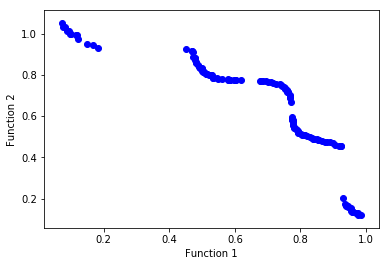

In [45]:
display_graph(ea_100)

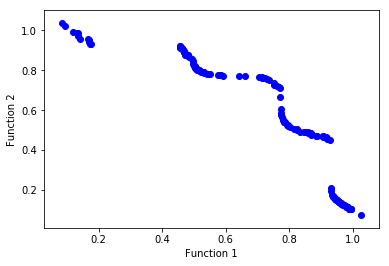

In [33]:
Image(filename='pareto.jpg')

In [91]:
def display_graph_3_subplot(ea_10,ea_100,ea_1000):
    final_arc = ea_10.archive
    x = []
    y = []
    for f in final_arc:
        x.append(f.fitness[0])
        y.append(f.fitness[1])
    plt.subplot(2,2,1)
    plt.scatter(x,y,color='b',s=22**2,label='10')
    plt.legend()
    final_arc = ea_100.archive
    x = []
    y = []
    for f in final_arc:
        x.append(f.fitness[0])
        y.append(f.fitness[1])
    plt.subplot(2,2,2)
    plt.scatter(x,y,color='b',s=22**2,label='100')
    plt.legend()
    final_arc = ea_1000.archive
    x = []
    y = []
    for f in final_arc:
        x.append(f.fitness[0])
        y.append(f.fitness[1])
    plt.subplot(2,2,3)
    plt.scatter(x,y,color='b',s=22**2,label='1000')
    # Plot and save in pdf format
    # plt.savefig('pf.pdf',format='pdf')
    plt.legend()
    plt.show()

In [92]:
import matplotlib.pylab as pylab
pylab.rcParams['figure.figsize'] = 60,40  # that's default image size for this interactive session
pylab.rcParams["font.size"] = "50"

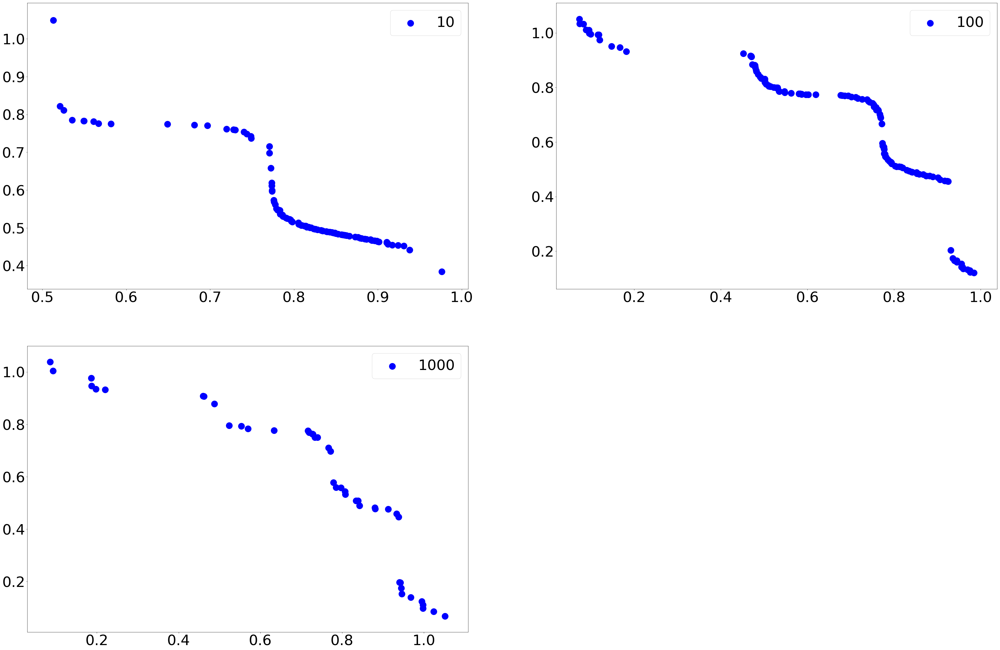

In [93]:
display_graph_3_subplot(ea_10,ea_100,ea_1000)

In [98]:
def display_graph_3(ea_10,ea_100,ea_1000):
    final_arc = ea_10.archive
    x = []
    y = []
    for f in final_arc:
        x.append(f.fitness[0])
        y.append(f.fitness[1])
    plt.scatter(x,y,color='b',s=22**2,label='population=10')
    final_arc = ea_100.archive
    x = []
    y = []
    for f in final_arc:
        x.append(f.fitness[0])
        y.append(f.fitness[1])
    plt.scatter(x,y,color='r',s=22**2,label='population=100')
    final_arc = ea_1000.archive
    x = []
    y = []
    for f in final_arc:
        x.append(f.fitness[0])
        y.append(f.fitness[1])
    plt.scatter(x,y,color='g',s=22**2,label='population=1000')
    plt.legend()
    # Plot and save in pdf format
    # plt.savefig('pf.pdf',format='pdf')
    plt.show()

In [99]:
pylab.rcParams['figure.figsize'] = 30, 20  # that's default image size for this interactive session

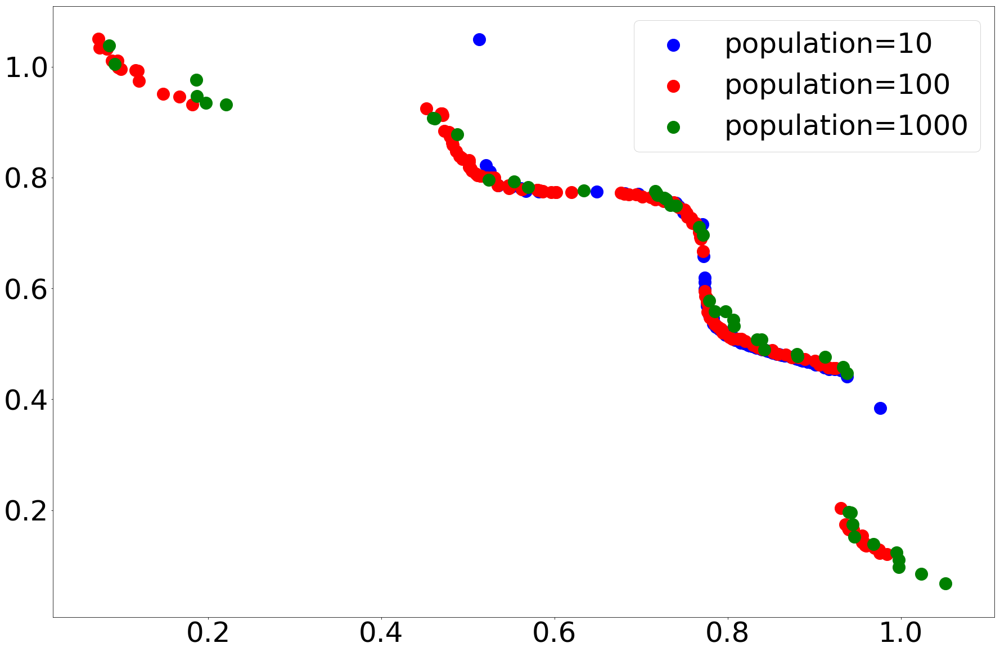

In [100]:
display_graph_3(ea_10,ea_100,ea_1000)

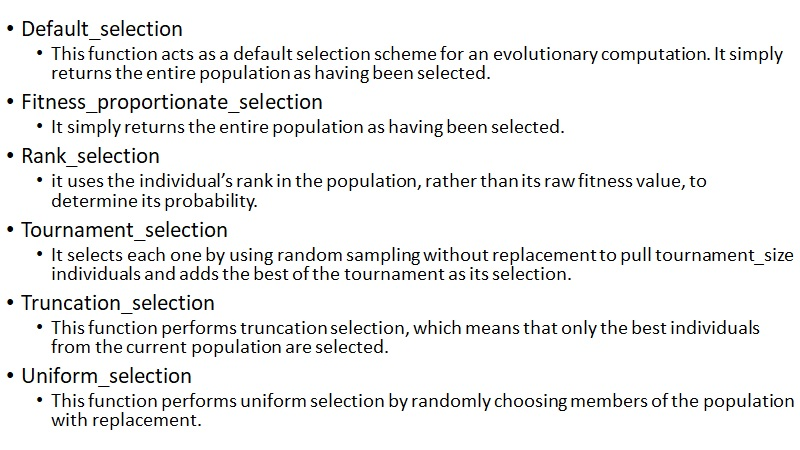

In [190]:
Image(filename='selection_criteria.jpg')

In [114]:
ea_default = NSGA2_default_selection()
#ea_fps = NSGA2_fitness_proportionate_selection()
ea_rank = NSGA2_rank_selection()
ea_tournament = NSGA2_tournament_selection()
ea_truncation = NSGA2_truncation_selection()
ea_uniform = NSGA2_uniform_selection()

----------------------------------------------------------------------------
                         Archive (    4 individuals)
----------------------------------------------------------------------------
[0.513525119953246, 0.9052484115321475] : [0.513525119953246, 0.9052484115321475]
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[0.23701886249269838, 0.9446481996535763] : [0.23701886249269838, 0.9446481996535763]
[1.0027542609032862, 0.12815013213354015] : [1.0027542609032862, 0.12815013213354015]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (    5 individuals)
----------------------------------------------------------------------------
[0.513525119953246, 0.9052484115321475] : [0.513525119953246, 0.9052484115321475]
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[

[0.7390476016680801, 0.7463542631413091] : [0.7390476016680801, 0.7463542631413091]
[0.5168182541213904, 0.8142203163616804] : [0.5168182541213904, 0.8142203163616804]
[0.7617635007346037, 0.7221927812183153] : [0.7617635007346037, 0.7221927812183153]
[0.15858220510787985, 0.949259928383246] : [0.15858220510787985, 0.949259928383246]
[0.4623602289067885, 0.928390547816236] : [0.4623602289067885, 0.928390547816236]
[0.8153450143970116, 0.5251681819143701] : [0.8153450143970116, 0.5251681819143701]
[0.7213774397185124, 0.7574733820371674] : [0.7213774397185124, 0.7574733820371674]
[0.735636983532344, 0.7478071480997445] : [0.735636983532344, 0.7478071480997445]
[0.6440042983670808, 0.7732780006544142] : [0.6440042983670808, 0.7732780006544142]
[0.46254755764990374, 0.9259297652448755] : [0.46254755764990374, 0.9259297652448755]
[0.7399036322459087, 0.7453429419613319] : [0.7399036322459087, 0.7453429419613319]
[0.7409646036909495, 0.7436478504151526] : [0.7409646036909495, 0.743647850415

[0.7719097816675785, 0.6727041938805454] : [0.7719097816675785, 0.6727041938805454]
[0.7563987539586663, 0.724859625275312] : [0.7563987539586663, 0.724859625275312]
[0.7853138317923248, 0.5355806202929799] : [0.7853138317923248, 0.5355806202929799]
[0.5306865424586236, 0.7902918420424361] : [0.5306865424586236, 0.7902918420424361]
[0.557621194694652, 0.7769206957212365] : [0.557621194694652, 0.7769206957212365]
[0.9388006739432873, 0.16388651501962997] : [0.9388006739432873, 0.16388651501962997]
[0.47511017629158986, 0.8923596758111211] : [0.47511017629158986, 0.8923596758111211]
[0.7406650703844905, 0.7434851147809053] : [0.7406650703844905, 0.7434851147809053]
[0.8758177814198426, 0.4884367346645635] : [0.8758177814198426, 0.4884367346645635]
[0.8075681993066276, 0.5236109167108608] : [0.8075681993066276, 0.5236109167108608]
[0.7781399245286442, 0.5758005903321913] : [0.7781399245286442, 0.5758005903321913]
[0.7563140458478099, 0.7284525026343198] : [0.7563140458478099, 0.7284525026

[0.5262505926188453, 0.789947888439578] : [0.5262505926188453, 0.789947888439578]
[0.7000625075632563, 0.765473316751546] : [0.7000625075632563, 0.765473316751546]
[0.7478708164880808, 0.737198896325368] : [0.7478708164880808, 0.737198896325368]
[0.20385978430896148, 0.9295971846144438] : [0.20385978430896148, 0.9295971846144438]
[1.0139748130637616, 0.08813834802624104] : [1.0139748130637616, 0.08813834802624104]
[0.5192095241941246, 0.7977568528840028] : [0.5192095241941246, 0.7977568528840028]
[0.7778805084842283, 0.5768616953402834] : [0.7778805084842283, 0.5768616953402834]
[0.4697592606038226, 0.9003027963698729] : [0.4697592606038226, 0.9003027963698729]
[1.0157402133957238, 0.08099472759248433] : [1.0157402133957238, 0.08099472759248433]
[0.47138625318656013, 0.8939769021206262] : [0.47138625318656013, 0.8939769021206262]
[0.7091091603689549, 0.7639152124519409] : [0.7091091603689549, 0.7639152124519409]
--------------------------------------------------------------------------

[0.7653999497244601, 0.7009661063573405] : [0.7653999497244601, 0.7009661063573405]
[0.8004025810562898, 0.5150065411369809] : [0.8004025810562898, 0.5150065411369809]
[0.7328351762857852, 0.7495458639179177] : [0.7328351762857852, 0.7495458639179177]
[0.7723743359403027, 0.6682657831668584] : [0.7723743359403027, 0.6682657831668584]
[0.7740670431111888, 0.5889163456556153] : [0.7740670431111888, 0.5889163456556153]
[0.11509327130419639, 0.9796072652268897] : [0.11509327130419639, 0.9796072652268897]
[0.7697020975640556, 0.6879678065344217] : [0.7697020975640556, 0.6879678065344217]
[0.7826988161034379, 0.5419572773526656] : [0.7826988161034379, 0.5419572773526656]
[0.46497153484369175, 0.9027379343567091] : [0.46497153484369175, 0.9027379343567091]
[0.1588662901018431, 0.9474968842909354] : [0.1588662901018431, 0.9474968842909354]
[0.7299152563628423, 0.7516011282801859] : [0.7299152563628423, 0.7516011282801859]
[0.199387649610597, 0.9306675534451806] : [0.199387649610597, 0.93066755

[0.2346960625732613, 1.0097763269956916] : [0.2346960625732613, 1.0097763269956916]
[0.993398051433521, 0.11858122631877296] : [0.993398051433521, 0.11858122631877296]
[0.8018399641701757, 0.536048205947805] : [0.8018399641701757, 0.536048205947805]
[0.5994999607796648, 0.802966000447918] : [0.5994999607796648, 0.802966000447918]
[0.5793853334299138, 0.8520892675118181] : [0.5793853334299138, 0.8520892675118181]
[0.7794300849403152, 0.6430357855977258] : [0.7794300849403152, 0.6430357855977258]
[0.7042968770765113, 0.7945739563398503] : [0.7042968770765113, 0.7945739563398503]
[0.7846773031288056, 0.6362178427902528] : [0.7846773031288056, 0.6362178427902528]
[0.9093413142458613, 0.505867642493755] : [0.9093413142458613, 0.505867642493755]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (   13 individuals)
-------------------------------------------

----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[0.23701886249269838, 0.9446481996535763] : [0.23701886249269838, 0.9446481996535763]
[0.2346960625732613, 1.0097763269956916] : [0.2346960625732613, 1.0097763269956916]
[0.993398051433521, 0.11858122631877296] : [0.993398051433521, 0.11858122631877296]
[0.8018399641701757, 0.536048205947805] : [0.8018399641701757, 0.536048205947805]
[0.7794300849403152, 0.6430357855977258] : [0.7794300849403152, 0.6430357855977258]
[0.7846773031288056, 0.6362178427902528] : [0.7846773031288056, 0.6362178427902528]
[0.9093413142458613, 0.505867642493755] : [0.9093413142458613, 0.505867642493755]
[0.7736444952209607, 0.7639556191460155] : [0.7736444952209607, 0.7639556191460155]
[0.9453864699037617, 0.44654398429304437] : [0.9453864699037617, 0.44654398429304437]
[0.7262831665975426, 0.7667679656275518] : [0.7262831665975426, 0.766767965627551

[0.8018399641701757, 0.536048205947805] : [0.8018399641701757, 0.536048205947805]
[0.9453864699037617, 0.44654398429304437] : [0.9453864699037617, 0.44654398429304437]
[0.7262831665975426, 0.7667679656275518] : [0.7262831665975426, 0.7667679656275518]
[0.6510717649970814, 0.7731187651177992] : [0.6510717649970814, 0.7731187651177992]
[0.7863769923424093, 0.5531188121085718] : [0.7863769923424093, 0.5531188121085718]
[0.6977279182415911, 0.7719295016654372] : [0.6977279182415911, 0.7719295016654372]
[0.46379524893804147, 0.9359789558327376] : [0.46379524893804147, 0.9359789558327376]
[0.4914356838857262, 0.8368116059968317] : [0.4914356838857262, 0.8368116059968317]
[0.5588726289402804, 0.7868748559412757] : [0.5588726289402804, 0.7868748559412757]
[0.5052050832888759, 0.8310154959929091] : [0.5052050832888759, 0.8310154959929091]
[1.0062948718896212, 0.11620061296249476] : [1.0062948718896212, 0.11620061296249476]
[0.5262849051347437, 0.8258997645568154] : [0.5262849051347437, 0.825899

[0.4864375632574192, 0.9157450975143951] : [0.4864375632574192, 0.9157450975143951]
[0.7751039028239746, 0.5943566979012858] : [0.7751039028239746, 0.5943566979012858]
[0.9222494972971598, 0.4638533029287787] : [0.9222494972971598, 0.4638533029287787]
[0.7742105979797961, 0.6432010198213525] : [0.7742105979797961, 0.6432010198213525]
[0.8800283728297668, 0.47395333839141063] : [0.8800283728297668, 0.47395333839141063]
[0.832515711108303, 0.5283473490374587] : [0.832515711108303, 0.5283473490374587]
[0.6486711113219441, 0.7747722920654174] : [0.6486711113219441, 0.7747722920654174]
[0.7637636275093334, 0.7087390208225159] : [0.7637636275093334, 0.7087390208225159]
[0.7751903990027385, 0.5663715150042652] : [0.7751903990027385, 0.5663715150042652]
[0.97874221217466, 0.1327909580048545] : [0.97874221217466, 0.1327909580048545]
[0.8786366810928676, 0.484930925333815] : [0.8786366810928676, 0.484930925333815]
[0.8500116113614751, 0.49434666223115337] : [0.8500116113614751, 0.494346662231153

[0.9222494972971598, 0.4638533029287787] : [0.9222494972971598, 0.4638533029287787]
[0.8800283728297668, 0.47395333839141063] : [0.8800283728297668, 0.47395333839141063]
[0.6486711113219441, 0.7747722920654174] : [0.6486711113219441, 0.7747722920654174]
[0.7637636275093334, 0.7087390208225159] : [0.7637636275093334, 0.7087390208225159]
[0.7751903990027385, 0.5663715150042652] : [0.7751903990027385, 0.5663715150042652]
[0.97874221217466, 0.1327909580048545] : [0.97874221217466, 0.1327909580048545]
[0.8786366810928676, 0.484930925333815] : [0.8786366810928676, 0.484930925333815]
[0.8500116113614751, 0.49434666223115337] : [0.8500116113614751, 0.49434666223115337]
[0.2279712218408556, 0.9568031777068594] : [0.2279712218408556, 0.9568031777068594]
[0.2277465419270446, 0.9727387364954981] : [0.2277465419270446, 0.9727387364954981]
[0.5460351637333936, 0.7953391917697938] : [0.5460351637333936, 0.7953391917697938]
[0.7751389097969454, 0.5784598063127914] : [0.7751389097969454, 0.578459806312

----------------------------------------------------------------------------
                         Archive (   47 individuals)
----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[0.23701886249269838, 0.9446481996535763] : [0.23701886249269838, 0.9446481996535763]
[0.993398051433521, 0.11858122631877296] : [0.993398051433521, 0.11858122631877296]
[0.9453864699037617, 0.44654398429304437] : [0.9453864699037617, 0.44654398429304437]
[0.7262831665975426, 0.7667679656275518] : [0.7262831665975426, 0.7667679656275518]
[0.6510717649970814, 0.7731187651177992] : [0.6510717649970814, 0.7731187651177992]
[0.7863769923424093, 0.5531188121085718] : [0.7863769923424093, 0.5531188121085718]
[0.6977279182415911, 0.7719295016654372] : [0.6977279182415911, 0.7719295016654372]
[0.46379524893804147, 0.9359789558327376] : [0.46379524893804147, 0.9359789558327376]
[0.4914356838857262, 0.836811

[0.49860815408319936, 0.8290523345081432] : [0.49860815408319936, 0.8290523345081432]
[0.7957755943337834, 0.5272042115049586] : [0.7957755943337834, 0.5272042115049586]
[0.6617203705789537, 0.7726530115427704] : [0.6617203705789537, 0.7726530115427704]
[0.4846577960603508, 0.8754998823388784] : [0.4846577960603508, 0.8754998823388784]
[0.21855487383848515, 0.9525510321154486] : [0.21855487383848515, 0.9525510321154486]
[0.22943634684139125, 0.9477030794035226] : [0.22943634684139125, 0.9477030794035226]
[0.7695125694282313, 0.7038186835630212] : [0.7695125694282313, 0.7038186835630212]
[0.7535372664342925, 0.7365981892537009] : [0.7535372664342925, 0.7365981892537009]
[0.4970073407542572, 0.8350346506958051] : [0.4970073407542572, 0.8350346506958051]
[0.8115888769090032, 0.5047304255338552] : [0.8115888769090032, 0.5047304255338552]
[0.5221683630380508, 0.8196106783343109] : [0.5221683630380508, 0.8196106783343109]
[0.7498602507308886, 0.7379826038041796] : [0.7498602507308886, 0.7379

[0.7556471362210992, 0.7254418042249134] : [0.7556471362210992, 0.7254418042249134]
[0.7735630554017644, 0.5958211900021808] : [0.7735630554017644, 0.5958211900021808]
[0.7949283286746845, 0.5391606144865027] : [0.7949283286746845, 0.5391606144865027]
[0.8493255436098198, 0.4968263235332567] : [0.8493255436098198, 0.4968263235332567]
[0.888277451484161, 0.4729354704486662] : [0.888277451484161, 0.4729354704486662]
[0.8759858176783581, 0.48850256437444606] : [0.8759858176783581, 0.48850256437444606]
[0.7713473188014176, 0.6766460100992806] : [0.7713473188014176, 0.6766460100992806]
[0.8292334940724754, 0.49734764843345775] : [0.8292334940724754, 0.49734764843345775]
[0.8101814699449171, 0.5120947130634855] : [0.8101814699449171, 0.5120947130634855]
[0.4722502503345965, 0.9114972308980861] : [0.4722502503345965, 0.9114972308980861]
[0.4799460092352832, 0.8810447538167485] : [0.4799460092352832, 0.8810447538167485]
[0.7727176351352102, 0.6559416027695831] : [0.7727176351352102, 0.65594160

[0.7556471362210992, 0.7254418042249134] : [0.7556471362210992, 0.7254418042249134]
[0.7735630554017644, 0.5958211900021808] : [0.7735630554017644, 0.5958211900021808]
[0.888277451484161, 0.4729354704486662] : [0.888277451484161, 0.4729354704486662]
[0.8759858176783581, 0.48850256437444606] : [0.8759858176783581, 0.48850256437444606]
[0.7713473188014176, 0.6766460100992806] : [0.7713473188014176, 0.6766460100992806]
[0.8292334940724754, 0.49734764843345775] : [0.8292334940724754, 0.49734764843345775]
[0.8101814699449171, 0.5120947130634855] : [0.8101814699449171, 0.5120947130634855]
[0.4722502503345965, 0.9114972308980861] : [0.4722502503345965, 0.9114972308980861]
[0.4799460092352832, 0.8810447538167485] : [0.4799460092352832, 0.8810447538167485]
[0.7727176351352102, 0.6559416027695831] : [0.7727176351352102, 0.6559416027695831]
[0.7993999407080135, 0.5160630324700671] : [0.7993999407080135, 0.5160630324700671]
[0.49860815408319936, 0.8290523345081432] : [0.49860815408319936, 0.829052

[0.7556471362210992, 0.7254418042249134] : [0.7556471362210992, 0.7254418042249134]
[0.7735630554017644, 0.5958211900021808] : [0.7735630554017644, 0.5958211900021808]
[0.888277451484161, 0.4729354704486662] : [0.888277451484161, 0.4729354704486662]
[0.8759858176783581, 0.48850256437444606] : [0.8759858176783581, 0.48850256437444606]
[0.7713473188014176, 0.6766460100992806] : [0.7713473188014176, 0.6766460100992806]
[0.8101814699449171, 0.5120947130634855] : [0.8101814699449171, 0.5120947130634855]
[0.4722502503345965, 0.9114972308980861] : [0.4722502503345965, 0.9114972308980861]
[0.4799460092352832, 0.8810447538167485] : [0.4799460092352832, 0.8810447538167485]
[0.7727176351352102, 0.6559416027695831] : [0.7727176351352102, 0.6559416027695831]
[0.7993999407080135, 0.5160630324700671] : [0.7993999407080135, 0.5160630324700671]
[0.49860815408319936, 0.8290523345081432] : [0.49860815408319936, 0.8290523345081432]
[0.6617203705789537, 0.7726530115427704] : [0.6617203705789537, 0.77265301

[0.9096325434100657, 0.4633136154227465] : [0.9096325434100657, 0.4633136154227465]
[0.19715801137989514, 0.9723906203012103] : [0.19715801137989514, 0.9723906203012103]
[0.21457081447987938, 0.9685127548998776] : [0.21457081447987938, 0.9685127548998776]
[0.48987202680373176, 0.8512724971263209] : [0.48987202680373176, 0.8512724971263209]
[0.8644408175123134, 0.4906956535481513] : [0.8644408175123134, 0.4906956535481513]
[0.7923610223812166, 0.5271588657271663] : [0.7923610223812166, 0.5271588657271663]
[0.5571085635412238, 0.7828604243953575] : [0.5571085635412238, 0.7828604243953575]
[0.7002525417310345, 0.7656868296780954] : [0.7002525417310345, 0.7656868296780954]
[0.7700869737966044, 0.7018324063156179] : [0.7700869737966044, 0.7018324063156179]
[0.23847384808059938, 0.9431933597042286] : [0.23847384808059938, 0.9431933597042286]
[0.6880835631575002, 0.7714331031565822] : [0.6880835631575002, 0.7714331031565822]
[0.7905399234633849, 0.5357729229576933] : [0.7905399234633849, 0.53

[0.4970073407542572, 0.8350346506958051] : [0.4970073407542572, 0.8350346506958051]
[0.8115888769090032, 0.5047304255338552] : [0.8115888769090032, 0.5047304255338552]
[0.7498602507308886, 0.7379826038041796] : [0.7498602507308886, 0.7379826038041796]
[0.9023140576358692, 0.47020071175311856] : [0.9023140576358692, 0.47020071175311856]
[0.5030471719481884, 0.8258978000917128] : [0.5030471719481884, 0.8258978000917128]
[0.7705150231311679, 0.701271023297089] : [0.7705150231311679, 0.701271023297089]
[0.2275472888600111, 0.9445398108562361] : [0.2275472888600111, 0.9445398108562361]
[0.7731916658545211, 0.6256340283769727] : [0.7731916658545211, 0.6256340283769727]
[0.24258450014859131, 0.9426798321526529] : [0.24258450014859131, 0.9426798321526529]
[0.4830193169331007, 0.8619787223228451] : [0.4830193169331007, 0.8619787223228451]
[0.7071321523069887, 0.7651308816894733] : [0.7071321523069887, 0.7651308816894733]
[0.9096325434100657, 0.4633136154227465] : [0.9096325434100657, 0.46331361

[0.24258450014859131, 0.9426798321526529] : [0.24258450014859131, 0.9426798321526529]
[0.4830193169331007, 0.8619787223228451] : [0.4830193169331007, 0.8619787223228451]
[0.7071321523069887, 0.7651308816894733] : [0.7071321523069887, 0.7651308816894733]
[0.9096325434100657, 0.4633136154227465] : [0.9096325434100657, 0.4633136154227465]
[0.19715801137989514, 0.9723906203012103] : [0.19715801137989514, 0.9723906203012103]
[0.21457081447987938, 0.9685127548998776] : [0.21457081447987938, 0.9685127548998776]
[0.48987202680373176, 0.8512724971263209] : [0.48987202680373176, 0.8512724971263209]
[0.7923610223812166, 0.5271588657271663] : [0.7923610223812166, 0.5271588657271663]
[0.5571085635412238, 0.7828604243953575] : [0.5571085635412238, 0.7828604243953575]
[0.7002525417310345, 0.7656868296780954] : [0.7002525417310345, 0.7656868296780954]
[0.7700869737966044, 0.7018324063156179] : [0.7700869737966044, 0.7018324063156179]
[0.23847384808059938, 0.9431933597042286] : [0.23847384808059938, 0.

[1.0062948718896212, 0.11620061296249476] : [1.0062948718896212, 0.11620061296249476]
[0.7751039028239746, 0.5943566979012858] : [0.7751039028239746, 0.5943566979012858]
[0.8800283728297668, 0.47395333839141063] : [0.8800283728297668, 0.47395333839141063]
[0.6486711113219441, 0.7747722920654174] : [0.6486711113219441, 0.7747722920654174]
[0.7751903990027385, 0.5663715150042652] : [0.7751903990027385, 0.5663715150042652]
[0.97874221217466, 0.1327909580048545] : [0.97874221217466, 0.1327909580048545]
[0.5460351637333936, 0.7953391917697938] : [0.5460351637333936, 0.7953391917697938]
[0.7751389097969454, 0.5784598063127914] : [0.7751389097969454, 0.5784598063127914]
[0.7556471362210992, 0.7254418042249134] : [0.7556471362210992, 0.7254418042249134]
[0.7735630554017644, 0.5958211900021808] : [0.7735630554017644, 0.5958211900021808]
[0.888277451484161, 0.4729354704486662] : [0.888277451484161, 0.4729354704486662]
[0.8759858176783581, 0.48850256437444606] : [0.8759858176783581, 0.48850256437

[0.4970073407542572, 0.8350346506958051] : [0.4970073407542572, 0.8350346506958051]
[0.8115888769090032, 0.5047304255338552] : [0.8115888769090032, 0.5047304255338552]
[0.7498602507308886, 0.7379826038041796] : [0.7498602507308886, 0.7379826038041796]
[0.9023140576358692, 0.47020071175311856] : [0.9023140576358692, 0.47020071175311856]
[0.5030471719481884, 0.8258978000917128] : [0.5030471719481884, 0.8258978000917128]
[0.7705150231311679, 0.701271023297089] : [0.7705150231311679, 0.701271023297089]
[0.2275472888600111, 0.9445398108562361] : [0.2275472888600111, 0.9445398108562361]
[0.7731916658545211, 0.6256340283769727] : [0.7731916658545211, 0.6256340283769727]
[0.24258450014859131, 0.9426798321526529] : [0.24258450014859131, 0.9426798321526529]
[0.4830193169331007, 0.8619787223228451] : [0.4830193169331007, 0.8619787223228451]
[0.7071321523069887, 0.7651308816894733] : [0.7071321523069887, 0.7651308816894733]
[0.9096325434100657, 0.4633136154227465] : [0.9096325434100657, 0.46331361

[0.19715801137989514, 0.9723906203012103] : [0.19715801137989514, 0.9723906203012103]
[0.21457081447987938, 0.9685127548998776] : [0.21457081447987938, 0.9685127548998776]
[0.48987202680373176, 0.8512724971263209] : [0.48987202680373176, 0.8512724971263209]
[0.7923610223812166, 0.5271588657271663] : [0.7923610223812166, 0.5271588657271663]
[0.7002525417310345, 0.7656868296780954] : [0.7002525417310345, 0.7656868296780954]
[0.23847384808059938, 0.9431933597042286] : [0.23847384808059938, 0.9431933597042286]
[0.7905399234633849, 0.5357729229576933] : [0.7905399234633849, 0.5357729229576933]
[0.7636397948916773, 0.7062955391448161] : [0.7636397948916773, 0.7062955391448161]
[0.7607423599826881, 0.7188497845674753] : [0.7607423599826881, 0.7188497845674753]
[0.7851889842536849, 0.5494117959175622] : [0.7851889842536849, 0.5494117959175622]
[0.8271273977258525, 0.496785928548772] : [0.8271273977258525, 0.496785928548772]
[0.8438674965571205, 0.4935474732504166] : [0.8438674965571205, 0.4935

[0.4705386013657806, 0.9131131869024759] : [0.4705386013657806, 0.9131131869024759]
[0.5086139800166927, 0.8122804420678557] : [0.5086139800166927, 0.8122804420678557]
[0.7861735087091848, 0.5385172329652014] : [0.7861735087091848, 0.5385172329652014]
[0.808044733429554, 0.5105983670614257] : [0.808044733429554, 0.5105983670614257]
[0.877361835483287, 0.48418654690292623] : [0.877361835483287, 0.48418654690292623]
[0.755993514584654, 0.7247371569496839] : [0.755993514584654, 0.7247371569496839]
[0.7954378731300541, 0.5241223913248307] : [0.7954378731300541, 0.5241223913248307]
[0.23089190703028734, 0.9439495185298229] : [0.23089190703028734, 0.9439495185298229]
[0.7873580952066475, 0.53677546551272] : [0.7873580952066475, 0.53677546551272]
[0.7878220315747252, 0.535833435358099] : [0.7878220315747252, 0.535833435358099]
[0.4788904535891061, 0.8970798991122282] : [0.4788904535891061, 0.8970798991122282]
[0.674577525606651, 0.7711476511108415] : [0.674577525606651, 0.7711476511108415]
[0

[0.542078584151497, 0.7888399843925004] : [0.542078584151497, 0.7888399843925004]
[0.76814327187198, 0.6921624988599508] : [0.76814327187198, 0.6921624988599508]
[0.5687824715818541, 0.7759041049482971] : [0.5687824715818541, 0.7759041049482971]
[0.5566891330010997, 0.7781047698903585] : [0.5566891330010997, 0.7781047698903585]
[0.7629398414371411, 0.7085619889123206] : [0.7629398414371411, 0.7085619889123206]
[0.6338461829867266, 0.7754099653265795] : [0.6338461829867266, 0.7754099653265795]
[0.7669904347156871, 0.6977041902289645] : [0.7669904347156871, 0.6977041902289645]
[0.7797183422122158, 0.5496776099181304] : [0.7797183422122158, 0.5496776099181304]
[0.5627522919558333, 0.7760221677663769] : [0.5627522919558333, 0.7760221677663769]
[0.5327841417463195, 0.792212331840636] : [0.5327841417463195, 0.792212331840636]
[0.8530796101515332, 0.4872346490940619] : [0.8530796101515332, 0.4872346490940619]
[0.7793119294195585, 0.5571643195043818] : [0.7793119294195585, 0.5571643195043818]


[0.5716342464766793, 0.7757882239051948] : [0.5716342464766793, 0.7757882239051948]
[0.8901924328946678, 0.47145601750560967] : [0.8901924328946678, 0.47145601750560967]
[0.6732842447285906, 0.7711809872637957] : [0.6732842447285906, 0.7711809872637957]
[0.22574539462822615, 0.9512587407031742] : [0.22574539462822615, 0.9512587407031742]
[0.7782700841293309, 0.5603744842065684] : [0.7782700841293309, 0.5603744842065684]
[0.23809200175269268, 0.9434961873396511] : [0.23809200175269268, 0.9434961873396511]
[0.7210476229554992, 0.7588556025456282] : [0.7210476229554992, 0.7588556025456282]
[0.7435762032561113, 0.7403922593141865] : [0.7435762032561113, 0.7403922593141865]
[0.734783581695529, 0.7501617447448968] : [0.734783581695529, 0.7501617447448968]
[0.7705717836566858, 0.6853289454937941] : [0.7705717836566858, 0.6853289454937941]
[0.9213137982862036, 0.4575234866202811] : [0.9213137982862036, 0.4575234866202811]
[0.7968368149085747, 0.5212058685659773] : [0.7968368149085747, 0.521205

[0.8661574254594444, 0.4821329017510554] : [0.8661574254594444, 0.4821329017510554]
[1.0496558915085452, 0.10893573029657472] : [1.0496558915085452, 0.10893573029657472]
[0.7178117006457542, 0.7608737601782589] : [0.7178117006457542, 0.7608737601782589]
[0.7837730683710485, 0.5390971237114076] : [0.7837730683710485, 0.5390971237114076]
[0.8611863931864125, 0.48393675336056297] : [0.8611863931864125, 0.48393675336056297]
[0.7872869782349539, 0.5318059667219581] : [0.7872869782349539, 0.5318059667219581]
[0.7884058081846627, 0.5308493813308801] : [0.7884058081846627, 0.5308493813308801]
[0.7767033379194032, 0.5584020846886787] : [0.7767033379194032, 0.5584020846886787]
[0.7736868780451376, 0.5956990914814879] : [0.7736868780451376, 0.5956990914814879]
[0.7738759606302947, 0.5939808759665117] : [0.7738759606302947, 0.5939808759665117]
[0.8477481560504294, 0.48891254115700444] : [0.8477481560504294, 0.48891254115700444]
[0.1967637813345643, 0.9523879935407591] : [0.1967637813345643, 0.9523

[0.8800283728297668, 0.47395333839141063] : [0.8800283728297668, 0.47395333839141063]
[0.7751903990027385, 0.5663715150042652] : [0.7751903990027385, 0.5663715150042652]
[0.97874221217466, 0.1327909580048545] : [0.97874221217466, 0.1327909580048545]
[0.7751389097969454, 0.5784598063127914] : [0.7751389097969454, 0.5784598063127914]
[0.7556471362210992, 0.7254418042249134] : [0.7556471362210992, 0.7254418042249134]
[0.7735630554017644, 0.5958211900021808] : [0.7735630554017644, 0.5958211900021808]
[0.888277451484161, 0.4729354704486662] : [0.888277451484161, 0.4729354704486662]
[0.7713473188014176, 0.6766460100992806] : [0.7713473188014176, 0.6766460100992806]
[0.4722502503345965, 0.9114972308980861] : [0.4722502503345965, 0.9114972308980861]
[0.7727176351352102, 0.6559416027695831] : [0.7727176351352102, 0.6559416027695831]
[0.7993999407080135, 0.5160630324700671] : [0.7993999407080135, 0.5160630324700671]
[0.49860815408319936, 0.8290523345081432] : [0.49860815408319936, 0.829052334508

[0.8611863931864125, 0.48393675336056297] : [0.8611863931864125, 0.48393675336056297]
[0.7884058081846627, 0.5308493813308801] : [0.7884058081846627, 0.5308493813308801]
[0.7767033379194032, 0.5584020846886787] : [0.7767033379194032, 0.5584020846886787]
[0.7736868780451376, 0.5956990914814879] : [0.7736868780451376, 0.5956990914814879]
[0.7738759606302947, 0.5939808759665117] : [0.7738759606302947, 0.5939808759665117]
[0.8477481560504294, 0.48891254115700444] : [0.8477481560504294, 0.48891254115700444]
[0.1967637813345643, 0.9523879935407591] : [0.1967637813345643, 0.9523879935407591]
[0.7732563429618304, 0.6040292538743478] : [0.7732563429618304, 0.6040292538743478]
[0.7846948652903073, 0.5345283699937009] : [0.7846948652903073, 0.5345283699937009]
[0.7743759471653345, 0.5901521511407226] : [0.7743759471653345, 0.5901521511407226]
[0.7703574744908567, 0.6860051157133134] : [0.7703574744908567, 0.6860051157133134]
[0.7734796096019161, 0.6036579156727634] : [0.7734796096019161, 0.603657

[0.7629398414371411, 0.7085619889123206] : [0.7629398414371411, 0.7085619889123206]
[0.7669904347156871, 0.6977041902289645] : [0.7669904347156871, 0.6977041902289645]
[0.7797183422122158, 0.5496776099181304] : [0.7797183422122158, 0.5496776099181304]
[0.5627522919558333, 0.7760221677663769] : [0.5627522919558333, 0.7760221677663769]
[0.8530796101515332, 0.4872346490940619] : [0.8530796101515332, 0.4872346490940619]
[0.7803773446445454, 0.5462158951014021] : [0.7803773446445454, 0.5462158951014021]
[0.7891486167622703, 0.5273104728646928] : [0.7891486167622703, 0.5273104728646928]
[0.945437842671808, 0.1985431254197387] : [0.945437842671808, 0.1985431254197387]
[0.4740911250996659, 0.8756917927525951] : [0.4740911250996659, 0.8756917927525951]
[0.7828139711613472, 0.5452731632327859] : [0.7828139711613472, 0.5452731632327859]
[0.5425766439492127, 0.7860679149744083] : [0.5425766439492127, 0.7860679149744083]
[0.7762689148603878, 0.5619172479528516] : [0.7762689148603878, 0.561917247952

[0.7797183422122158, 0.5496776099181304] : [0.7797183422122158, 0.5496776099181304]
[0.5627522919558333, 0.7760221677663769] : [0.5627522919558333, 0.7760221677663769]
[0.8530796101515332, 0.4872346490940619] : [0.8530796101515332, 0.4872346490940619]
[0.7803773446445454, 0.5462158951014021] : [0.7803773446445454, 0.5462158951014021]
[0.7891486167622703, 0.5273104728646928] : [0.7891486167622703, 0.5273104728646928]
[0.945437842671808, 0.1985431254197387] : [0.945437842671808, 0.1985431254197387]
[0.4740911250996659, 0.8756917927525951] : [0.4740911250996659, 0.8756917927525951]
[0.7828139711613472, 0.5452731632327859] : [0.7828139711613472, 0.5452731632327859]
[0.5425766439492127, 0.7860679149744083] : [0.5425766439492127, 0.7860679149744083]
[0.7762689148603878, 0.5619172479528516] : [0.7762689148603878, 0.5619172479528516]
[0.791110690030077, 0.5250573865887909] : [0.791110690030077, 0.5250573865887909]
[0.8661574254594444, 0.4821329017510554] : [0.8661574254594444, 0.48213290175105

[0.6136242415157755, 0.7738155651932946] : [0.6136242415157755, 0.7738155651932946]
[0.8049030917653953, 0.5105298318749014] : [0.8049030917653953, 0.5105298318749014]
[0.7735587674306906, 0.5969111318771102] : [0.7735587674306906, 0.5969111318771102]
[0.7767018312752254, 0.5591946493667893] : [0.7767018312752254, 0.5591946493667893]
[0.7777322228057022, 0.5562684626007214] : [0.7777322228057022, 0.5562684626007214]
[0.7794947787799776, 0.5519374732595942] : [0.7794947787799776, 0.5519374732595942]
[0.7569984503240932, 0.7216848997555811] : [0.7569984503240932, 0.7216848997555811]
[0.7865760848407735, 0.5308527477992967] : [0.7865760848407735, 0.5308527477992967]
[0.5248633029636933, 0.7916651398965782] : [0.5248633029636933, 0.7916651398965782]
[0.6997125905478708, 0.7690562031942473] : [0.6997125905478708, 0.7690562031942473]
[0.8299542746114222, 0.49414193433684556] : [0.8299542746114222, 0.49414193433684556]
[0.5567441548522049, 0.7772976338011419] : [0.5567441548522049, 0.77729763

[0.7178117006457542, 0.7608737601782589] : [0.7178117006457542, 0.7608737601782589]
[0.8611863931864125, 0.48393675336056297] : [0.8611863931864125, 0.48393675336056297]
[0.7884058081846627, 0.5308493813308801] : [0.7884058081846627, 0.5308493813308801]
[0.7767033379194032, 0.5584020846886787] : [0.7767033379194032, 0.5584020846886787]
[0.7736868780451376, 0.5956990914814879] : [0.7736868780451376, 0.5956990914814879]
[0.7738759606302947, 0.5939808759665117] : [0.7738759606302947, 0.5939808759665117]
[0.8477481560504294, 0.48891254115700444] : [0.8477481560504294, 0.48891254115700444]
[0.1967637813345643, 0.9523879935407591] : [0.1967637813345643, 0.9523879935407591]
[0.7732563429618304, 0.6040292538743478] : [0.7732563429618304, 0.6040292538743478]
[0.7846948652903073, 0.5345283699937009] : [0.7846948652903073, 0.5345283699937009]
[0.7743759471653345, 0.5901521511407226] : [0.7743759471653345, 0.5901521511407226]
[0.7703574744908567, 0.6860051157133134] : [0.7703574744908567, 0.686005

[0.7071321523069887, 0.7651308816894733] : [0.7071321523069887, 0.7651308816894733]
[0.9096325434100657, 0.4633136154227465] : [0.9096325434100657, 0.4633136154227465]
[0.48987202680373176, 0.8512724971263209] : [0.48987202680373176, 0.8512724971263209]
[0.7002525417310345, 0.7656868296780954] : [0.7002525417310345, 0.7656868296780954]
[0.7636397948916773, 0.7062955391448161] : [0.7636397948916773, 0.7062955391448161]
[0.8271273977258525, 0.496785928548772] : [0.8271273977258525, 0.496785928548772]
[0.8438674965571205, 0.4935474732504166] : [0.8438674965571205, 0.4935474732504166]
[0.7625971934128378, 0.7088730171239757] : [0.7625971934128378, 0.7088730171239757]
[0.9365164002404848, 0.23245930102831008] : [0.9365164002404848, 0.23245930102831008]
[0.8187359415461817, 0.5034598064701187] : [0.8187359415461817, 0.5034598064701187]
[0.4705386013657806, 0.9131131869024759] : [0.4705386013657806, 0.9131131869024759]
[0.755993514584654, 0.7247371569496839] : [0.755993514584654, 0.7247371569

[0.7569984503240932, 0.7216848997555811] : [0.7569984503240932, 0.7216848997555811]
[0.7865760848407735, 0.5308527477992967] : [0.7865760848407735, 0.5308527477992967]
[0.5248633029636933, 0.7916651398965782] : [0.5248633029636933, 0.7916651398965782]
[0.6997125905478708, 0.7690562031942473] : [0.6997125905478708, 0.7690562031942473]
[0.8299542746114222, 0.49414193433684556] : [0.8299542746114222, 0.49414193433684556]
[0.5567441548522049, 0.7772976338011419] : [0.5567441548522049, 0.7772976338011419]
[0.7848958366921338, 0.534393847033016] : [0.7848958366921338, 0.534393847033016]
[0.7614090383680856, 0.7122167828846879] : [0.7614090383680856, 0.7122167828846879]
[0.5211972176709719, 0.7937802037489458] : [0.5211972176709719, 0.7937802037489458]
[0.7981824300706114, 0.5210470104872515] : [0.7981824300706114, 0.5210470104872515]
[0.23720621229912905, 0.9426632787053392] : [0.23720621229912905, 0.9426632787053392]
[0.7737028009380734, 0.5918506328286945] : [0.7737028009380734, 0.59185063

[0.2275472888600111, 0.9445398108562361] : [0.2275472888600111, 0.9445398108562361]
[0.7731916658545211, 0.6256340283769727] : [0.7731916658545211, 0.6256340283769727]
[0.4830193169331007, 0.8619787223228451] : [0.4830193169331007, 0.8619787223228451]
[0.7071321523069887, 0.7651308816894733] : [0.7071321523069887, 0.7651308816894733]
[0.9096325434100657, 0.4633136154227465] : [0.9096325434100657, 0.4633136154227465]
[0.48987202680373176, 0.8512724971263209] : [0.48987202680373176, 0.8512724971263209]
[0.7002525417310345, 0.7656868296780954] : [0.7002525417310345, 0.7656868296780954]
[0.7636397948916773, 0.7062955391448161] : [0.7636397948916773, 0.7062955391448161]
[0.8271273977258525, 0.496785928548772] : [0.8271273977258525, 0.496785928548772]
[0.8438674965571205, 0.4935474732504166] : [0.8438674965571205, 0.4935474732504166]
[0.7625971934128378, 0.7088730171239757] : [0.7625971934128378, 0.7088730171239757]
[0.9365164002404848, 0.23245930102831008] : [0.9365164002404848, 0.232459301

[0.7968368149085747, 0.5212058685659773] : [0.7968368149085747, 0.5212058685659773]
[0.9426640229632834, 0.19890160725661354] : [0.9426640229632834, 0.19890160725661354]
[0.76814327187198, 0.6921624988599508] : [0.76814327187198, 0.6921624988599508]
[0.5687824715818541, 0.7759041049482971] : [0.5687824715818541, 0.7759041049482971]
[0.5566891330010997, 0.7781047698903585] : [0.5566891330010997, 0.7781047698903585]
[0.7629398414371411, 0.7085619889123206] : [0.7629398414371411, 0.7085619889123206]
[0.7669904347156871, 0.6977041902289645] : [0.7669904347156871, 0.6977041902289645]
[0.7797183422122158, 0.5496776099181304] : [0.7797183422122158, 0.5496776099181304]
[0.5627522919558333, 0.7760221677663769] : [0.5627522919558333, 0.7760221677663769]
[0.8530796101515332, 0.4872346490940619] : [0.8530796101515332, 0.4872346490940619]
[0.7803773446445454, 0.5462158951014021] : [0.7803773446445454, 0.5462158951014021]
[0.7891486167622703, 0.5273104728646928] : [0.7891486167622703, 0.527310472864

[0.5687824715818541, 0.7759041049482971] : [0.5687824715818541, 0.7759041049482971]
[0.5566891330010997, 0.7781047698903585] : [0.5566891330010997, 0.7781047698903585]
[0.7629398414371411, 0.7085619889123206] : [0.7629398414371411, 0.7085619889123206]
[0.7669904347156871, 0.6977041902289645] : [0.7669904347156871, 0.6977041902289645]
[0.7797183422122158, 0.5496776099181304] : [0.7797183422122158, 0.5496776099181304]
[0.5627522919558333, 0.7760221677663769] : [0.5627522919558333, 0.7760221677663769]
[0.8530796101515332, 0.4872346490940619] : [0.8530796101515332, 0.4872346490940619]
[0.7803773446445454, 0.5462158951014021] : [0.7803773446445454, 0.5462158951014021]
[0.7891486167622703, 0.5273104728646928] : [0.7891486167622703, 0.5273104728646928]
[0.945437842671808, 0.1985431254197387] : [0.945437842671808, 0.1985431254197387]
[0.4740911250996659, 0.8756917927525951] : [0.4740911250996659, 0.8756917927525951]
[0.7828139711613472, 0.5452731632327859] : [0.7828139711613472, 0.545273163232

[0.4722502503345965, 0.9114972308980861] : [0.4722502503345965, 0.9114972308980861]
[0.7727176351352102, 0.6559416027695831] : [0.7727176351352102, 0.6559416027695831]
[0.7993999407080135, 0.5160630324700671] : [0.7993999407080135, 0.5160630324700671]
[0.49860815408319936, 0.8290523345081432] : [0.49860815408319936, 0.8290523345081432]
[0.6617203705789537, 0.7726530115427704] : [0.6617203705789537, 0.7726530115427704]
[0.4970073407542572, 0.8350346506958051] : [0.4970073407542572, 0.8350346506958051]
[0.8115888769090032, 0.5047304255338552] : [0.8115888769090032, 0.5047304255338552]
[0.7498602507308886, 0.7379826038041796] : [0.7498602507308886, 0.7379826038041796]
[0.9023140576358692, 0.47020071175311856] : [0.9023140576358692, 0.47020071175311856]
[0.5030471719481884, 0.8258978000917128] : [0.5030471719481884, 0.8258978000917128]
[0.2275472888600111, 0.9445398108562361] : [0.2275472888600111, 0.9445398108562361]
[0.7731916658545211, 0.6256340283769727] : [0.7731916658545211, 0.625634

[0.7767033379194032, 0.5584020846886787] : [0.7767033379194032, 0.5584020846886787]
[0.7736868780451376, 0.5956990914814879] : [0.7736868780451376, 0.5956990914814879]
[0.8477481560504294, 0.48891254115700444] : [0.8477481560504294, 0.48891254115700444]
[0.1967637813345643, 0.9523879935407591] : [0.1967637813345643, 0.9523879935407591]
[0.7732563429618304, 0.6040292538743478] : [0.7732563429618304, 0.6040292538743478]
[0.7846948652903073, 0.5345283699937009] : [0.7846948652903073, 0.5345283699937009]
[0.7703574744908567, 0.6860051157133134] : [0.7703574744908567, 0.6860051157133134]
[0.7671180087367652, 0.6945944466204805] : [0.7671180087367652, 0.6945944466204805]
[0.7836344502627253, 0.5372959102577555] : [0.7836344502627253, 0.5372959102577555]
[0.758711459837302, 0.7206876237994534] : [0.758711459837302, 0.7206876237994534]
[0.8135641464977976, 0.5036357046675535] : [0.8135641464977976, 0.5036357046675535]
[0.7691584528255794, 0.686164950707822] : [0.7691584528255794, 0.68616495070

[0.4914356838857262, 0.8368116059968317] : [0.4914356838857262, 0.8368116059968317]
[1.0062948718896212, 0.11620061296249476] : [1.0062948718896212, 0.11620061296249476]
[0.8800283728297668, 0.47395333839141063] : [0.8800283728297668, 0.47395333839141063]
[0.7751903990027385, 0.5663715150042652] : [0.7751903990027385, 0.5663715150042652]
[0.97874221217466, 0.1327909580048545] : [0.97874221217466, 0.1327909580048545]
[0.7751389097969454, 0.5784598063127914] : [0.7751389097969454, 0.5784598063127914]
[0.7556471362210992, 0.7254418042249134] : [0.7556471362210992, 0.7254418042249134]
[0.7735630554017644, 0.5958211900021808] : [0.7735630554017644, 0.5958211900021808]
[0.888277451484161, 0.4729354704486662] : [0.888277451484161, 0.4729354704486662]
[0.7713473188014176, 0.6766460100992806] : [0.7713473188014176, 0.6766460100992806]
[0.4722502503345965, 0.9114972308980861] : [0.4722502503345965, 0.9114972308980861]
[0.7727176351352102, 0.6559416027695831] : [0.7727176351352102, 0.655941602769

[0.6617203705789537, 0.7726530115427704] : [0.6617203705789537, 0.7726530115427704]
[0.4970073407542572, 0.8350346506958051] : [0.4970073407542572, 0.8350346506958051]
[0.8115888769090032, 0.5047304255338552] : [0.8115888769090032, 0.5047304255338552]
[0.7498602507308886, 0.7379826038041796] : [0.7498602507308886, 0.7379826038041796]
[0.9023140576358692, 0.47020071175311856] : [0.9023140576358692, 0.47020071175311856]
[0.5030471719481884, 0.8258978000917128] : [0.5030471719481884, 0.8258978000917128]
[0.2275472888600111, 0.9445398108562361] : [0.2275472888600111, 0.9445398108562361]
[0.7731916658545211, 0.6256340283769727] : [0.7731916658545211, 0.6256340283769727]
[0.4830193169331007, 0.8619787223228451] : [0.4830193169331007, 0.8619787223228451]
[0.7071321523069887, 0.7651308816894733] : [0.7071321523069887, 0.7651308816894733]
[0.9096325434100657, 0.4633136154227465] : [0.9096325434100657, 0.4633136154227465]
[0.48987202680373176, 0.8512724971263209] : [0.48987202680373176, 0.851272

[0.9572948629249184, 0.2576143361433857] : [0.9572948629249184, 0.2576143361433857]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (   10 individuals)
----------------------------------------------------------------------------
[0.513525119953246, 0.9052484115321475] : [0.513525119953246, 0.9052484115321475]
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[0.23701886249269838, 0.9446481996535763] : [0.23701886249269838, 0.9446481996535763]
[1.0027542609032862, 0.12815013213354015] : [1.0027542609032862, 0.12815013213354015]
[0.9940779086608862, 0.1319702346616637] : [0.9940779086608862, 0.1319702346616637]
[0.9872782780481106, 0.14318114552117112] : [0.9872782780481106, 0.14318114552117112]
[0.5181448504485628, 0.8068550505638954] : [0.5181448504485628, 0.8068550505638954]
[1.0562696569338546, 0.127338132681464

[1.0364839320883974, 0.10631897389440377] : [1.0364839320883974, 0.10631897389440377]
[0.9044148745210909, 0.46592909215452427] : [0.9044148745210909, 0.46592909215452427]
[0.56600665151736, 0.7873217556341853] : [0.56600665151736, 0.7873217556341853]
[0.9563756914291822, 0.1391748649813662] : [0.9563756914291822, 0.1391748649813662]
[0.9741074138869643, 0.12854140057335728] : [0.9741074138869643, 0.12854140057335728]
[0.9427951998083712, 0.19511331119222175] : [0.9427951998083712, 0.19511331119222175]
[0.793529520434515, 0.5996129905199162] : [0.793529520434515, 0.5996129905199162]
[0.9672033289504919, 0.13659265061256282] : [0.9672033289504919, 0.13659265061256282]
[0.886065322222171, 0.4775594417984014] : [0.886065322222171, 0.4775594417984014]
[0.8433489883641045, 0.517687809430305] : [0.8433489883641045, 0.517687809430305]
[1.0061506318128723, 0.11528954923448549] : [1.0061506318128723, 0.11528954923448549]
--------------------------------------------------------------------------

[0.4631050697091216, 0.9144679146839036] : [0.4631050697091216, 0.9144679146839036]
[0.9435320012825912, 0.1676808580412204] : [0.9435320012825912, 0.1676808580412204]
[0.9629661031021342, 0.130810105895683] : [0.9629661031021342, 0.130810105895683]
[0.7926875432444509, 0.5429849640500835] : [0.7926875432444509, 0.5429849640500835]
[0.9519273225405694, 0.14750588123610986] : [0.9519273225405694, 0.14750588123610986]
[0.9685271798818021, 0.12625891172973921] : [0.9685271798818021, 0.12625891172973921]
[0.779476436808202, 0.648984590112547] : [0.779476436808202, 0.648984590112547]
[0.7925717722893473, 0.5523009767154502] : [0.7925717722893473, 0.5523009767154502]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (   35 individuals)
----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : [0

[0.8239477363864007, 0.5174701214650229] : [0.8239477363864007, 0.5174701214650229]
[0.5469417737385747, 0.8063735172405705] : [0.5469417737385747, 0.8063735172405705]
[0.7779720598513781, 0.5847729393261809] : [0.7779720598513781, 0.5847729393261809]
[0.824092927518145, 0.5047342118930584] : [0.824092927518145, 0.5047342118930584]
[0.9869561023666245, 0.11805992621172143] : [0.9869561023666245, 0.11805992621172143]
[0.784704311422317, 0.5404565589470728] : [0.784704311422317, 0.5404565589470728]
[0.49567189410874646, 0.8449914734610389] : [0.49567189410874646, 0.8449914734610389]
[0.1324611130764476, 1.0316066172562595] : [0.1324611130764476, 1.0316066172562595]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (   36 individuals)
----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : 

[0.9540026985098125, 0.14432410638282855] : [0.9540026985098125, 0.14432410638282855]
[0.8495196892071321, 0.4907540458452065] : [0.8495196892071321, 0.4907540458452065]
[0.6324689663148466, 0.7852122904575933] : [0.6324689663148466, 0.7852122904575933]
[0.9042290969849994, 0.47158302395751894] : [0.9042290969849994, 0.47158302395751894]
[0.19483989953605263, 0.985920414262019] : [0.19483989953605263, 0.985920414262019]
[0.9356307390247763, 0.17077700853279923] : [0.9356307390247763, 0.17077700853279923]
[0.9720930679046745, 0.12250819244583348] : [0.9720930679046745, 0.12250819244583348]
[0.4726257860626168, 0.9050513115551] : [0.4726257860626168, 0.9050513115551]
[0.7738679618004469, 0.5878089817638413] : [0.7738679618004469, 0.5878089817638413]
[0.7457579591816267, 0.755485107607513] : [0.7457579591816267, 0.755485107607513]
[0.7341121598445174, 0.7672050816908854] : [0.7341121598445174, 0.7672050816908854]
[0.4951787019822323, 0.8608574242773607] : [0.4951787019822323, 0.8608574242

[0.9356307390247763, 0.17077700853279923] : [0.9356307390247763, 0.17077700853279923]
[0.9720930679046745, 0.12250819244583348] : [0.9720930679046745, 0.12250819244583348]
[0.4726257860626168, 0.9050513115551] : [0.4726257860626168, 0.9050513115551]
[0.7738679618004469, 0.5878089817638413] : [0.7738679618004469, 0.5878089817638413]
[0.7457579591816267, 0.755485107607513] : [0.7457579591816267, 0.755485107607513]
[0.7341121598445174, 0.7672050816908854] : [0.7341121598445174, 0.7672050816908854]
[0.4951787019822323, 0.8608574242773607] : [0.4951787019822323, 0.8608574242773607]
[0.950458236097592, 0.14675954900333762] : [0.950458236097592, 0.14675954900333762]
[0.4789910695046944, 0.9005820247666301] : [0.4789910695046944, 0.9005820247666301]
[0.969535434519654, 0.12488182200709662] : [0.969535434519654, 0.12488182200709662]
[1.0292413596962888, 0.10253263230056059] : [1.0292413596962888, 0.10253263230056059]
[0.7738484132519866, 0.6439184400455611] : [0.7738484132519866, 0.643918440045

[0.9893867042781297, 0.10629311833015231] : [0.9893867042781297, 0.10629311833015231]
[0.565528271907457, 0.7866167353452621] : [0.565528271907457, 0.7866167353452621]
[0.5322480242699189, 0.7936497770955608] : [0.5322480242699189, 0.7936497770955608]
[0.6053110286947647, 0.7746629774064232] : [0.6053110286947647, 0.7746629774064232]
[0.16132460701718487, 0.9800461433763924] : [0.16132460701718487, 0.9800461433763924]
[0.9458293379569012, 0.1526558176279152] : [0.9458293379569012, 0.1526558176279152]
[0.9499900151457811, 0.1477504311773782] : [0.9499900151457811, 0.1477504311773782]
[0.7306343454498125, 0.7727666909915039] : [0.7306343454498125, 0.7727666909915039]
[0.7598693881114256, 0.7298879565590847] : [0.7598693881114256, 0.7298879565590847]
[0.12960059023915724, 1.0222926530901937] : [0.12960059023915724, 1.0222926530901937]
[0.9589676608583416, 0.13818499634531956] : [0.9589676608583416, 0.13818499634531956]
[1.036448287170521, 0.0917357910090753] : [1.036448287170521, 0.091735

[0.8239477363864007, 0.5174701214650229] : [0.8239477363864007, 0.5174701214650229]
[0.7779720598513781, 0.5847729393261809] : [0.7779720598513781, 0.5847729393261809]
[0.824092927518145, 0.5047342118930584] : [0.824092927518145, 0.5047342118930584]
[0.9869561023666245, 0.11805992621172143] : [0.9869561023666245, 0.11805992621172143]
[0.784704311422317, 0.5404565589470728] : [0.784704311422317, 0.5404565589470728]
[0.49567189410874646, 0.8449914734610389] : [0.49567189410874646, 0.8449914734610389]
[0.48970873386154457, 0.8784643784462944] : [0.48970873386154457, 0.8784643784462944]
[0.949816536479039, 0.15080906339824618] : [0.949816536479039, 0.15080906339824618]
[0.9540026985098125, 0.14432410638282855] : [0.9540026985098125, 0.14432410638282855]
[0.8495196892071321, 0.4907540458452065] : [0.8495196892071321, 0.4907540458452065]
[0.9042290969849994, 0.47158302395751894] : [0.9042290969849994, 0.47158302395751894]
[0.9356307390247763, 0.17077700853279923] : [0.9356307390247763, 0.170

[0.1898794161930315, 0.9506031267386882] : [0.1898794161930315, 0.9506031267386882]
[0.5038973057634868, 0.8133008966636578] : [0.5038973057634868, 0.8133008966636578]
[0.7963276145914848, 0.5245965627583606] : [0.7963276145914848, 0.5245965627583606]
[0.7733790912916645, 0.7041415076196202] : [0.7733790912916645, 0.7041415076196202]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (   73 individuals)
----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[0.23701886249269838, 0.9446481996535763] : [0.23701886249269838, 0.9446481996535763]
[0.5181448504485628, 0.8068550505638954] : [0.5181448504485628, 0.8068550505638954]
[0.9446766425048546, 0.1552156731413402] : [0.9446766425048546, 0.1552156731413402]
[0.6359159837694814, 0.773958418105087] 

[0.5484580076778668, 0.7823347468992851] : [0.5484580076778668, 0.7823347468992851]
[0.18360052059225734, 0.954745283955642] : [0.18360052059225734, 0.954745283955642]
[0.1898794161930315, 0.9506031267386882] : [0.1898794161930315, 0.9506031267386882]
[0.5038973057634868, 0.8133008966636578] : [0.5038973057634868, 0.8133008966636578]
[0.7963276145914848, 0.5245965627583606] : [0.7963276145914848, 0.5245965627583606]
[0.7733790912916645, 0.7041415076196202] : [0.7733790912916645, 0.7041415076196202]
[0.5055284401568257, 0.8115045236090657] : [0.5055284401568257, 0.8115045236090657]
[0.9330537079357243, 0.2070675749520614] : [0.9330537079357243, 0.2070675749520614]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (   74 individuals)
----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : 

[0.9499900151457811, 0.1477504311773782] : [0.9499900151457811, 0.1477504311773782]
[0.7598693881114256, 0.7298879565590847] : [0.7598693881114256, 0.7298879565590847]
[0.12960059023915724, 1.0222926530901937] : [0.12960059023915724, 1.0222926530901937]
[0.9589676608583416, 0.13818499634531956] : [0.9589676608583416, 0.13818499634531956]
[1.036448287170521, 0.0917357910090753] : [1.036448287170521, 0.0917357910090753]
[0.9499281727308392, 0.14999716618573136] : [0.9499281727308392, 0.14999716618573136]
[0.9043918993918851, 0.4696774000014828] : [0.9043918993918851, 0.4696774000014828]
[0.7040181451443231, 0.7648753374730456] : [0.7040181451443231, 0.7648753374730456]
[0.14251137603399755, 0.9563235559072146] : [0.14251137603399755, 0.9563235559072146]
[0.4570445623511165, 0.921225817581277] : [0.4570445623511165, 0.921225817581277]
[0.46888166422455313, 0.8911162584286141] : [0.46888166422455313, 0.8911162584286141]
[0.9282365673547597, 0.4482820192466724] : [0.9282365673547597, 0.4482

[0.6359159837694814, 0.773958418105087] : [0.6359159837694814, 0.773958418105087]
[0.9044148745210909, 0.46592909215452427] : [0.9044148745210909, 0.46592909215452427]
[0.9563756914291822, 0.1391748649813662] : [0.9563756914291822, 0.1391748649813662]
[0.886065322222171, 0.4775594417984014] : [0.886065322222171, 0.4775594417984014]
[0.9949996666297514, 0.1025903301755402] : [0.9949996666297514, 0.1025903301755402]
[0.9344606549839003, 0.17349011639945522] : [0.9344606549839003, 0.17349011639945522]
[0.8667937932703573, 0.4830112478422478] : [0.8667937932703573, 0.4830112478422478]
[0.9713522101872003, 0.12475173185718222] : [0.9713522101872003, 0.12475173185718222]
[0.9629661031021342, 0.130810105895683] : [0.9629661031021342, 0.130810105895683]
[0.9685271798818021, 0.12625891172973921] : [0.9685271798818021, 0.12625891172973921]
[0.7524889339765513, 0.7535523247409964] : [0.7524889339765513, 0.7535523247409964]
[0.824092927518145, 0.5047342118930584] : [0.824092927518145, 0.5047342118

----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[0.5181448504485628, 0.8068550505638954] : [0.5181448504485628, 0.8068550505638954]
[0.9446766425048546, 0.1552156731413402] : [0.9446766425048546, 0.1552156731413402]
[0.6359159837694814, 0.773958418105087] : [0.6359159837694814, 0.773958418105087]
[0.9044148745210909, 0.46592909215452427] : [0.9044148745210909, 0.46592909215452427]
[0.9563756914291822, 0.1391748649813662] : [0.9563756914291822, 0.1391748649813662]
[0.886065322222171, 0.4775594417984014] : [0.886065322222171, 0.4775594417984014]
[0.9949996666297514, 0.1025903301755402] : [0.9949996666297514, 0.1025903301755402]
[0.9344606549839003, 0.17349011639945522] : [0.9344606549839003, 0.17349011639945522]
[0.8667937932703573, 0.4830112478422478] : [0.8667937932703573, 0.4830112478422478]
[0.9713522101872003, 0.12475173185718222] : [0.9713522101872003, 0.12475173185718

[0.9446766425048546, 0.1552156731413402] : [0.9446766425048546, 0.1552156731413402]
[0.6359159837694814, 0.773958418105087] : [0.6359159837694814, 0.773958418105087]
[0.9044148745210909, 0.46592909215452427] : [0.9044148745210909, 0.46592909215452427]
[0.9563756914291822, 0.1391748649813662] : [0.9563756914291822, 0.1391748649813662]
[0.886065322222171, 0.4775594417984014] : [0.886065322222171, 0.4775594417984014]
[0.9949996666297514, 0.1025903301755402] : [0.9949996666297514, 0.1025903301755402]
[0.9344606549839003, 0.17349011639945522] : [0.9344606549839003, 0.17349011639945522]
[0.8667937932703573, 0.4830112478422478] : [0.8667937932703573, 0.4830112478422478]
[0.9713522101872003, 0.12475173185718222] : [0.9713522101872003, 0.12475173185718222]
[0.9629661031021342, 0.130810105895683] : [0.9629661031021342, 0.130810105895683]
[0.9685271798818021, 0.12625891172973921] : [0.9685271798818021, 0.12625891172973921]
[0.7524889339765513, 0.7535523247409964] : [0.7524889339765513, 0.75355232

[0.9394389987095466, 0.16421254964541432] : [0.9394389987095466, 0.16421254964541432]
[0.9875147391093336, 0.10621495282313109] : [0.9875147391093336, 0.10621495282313109]
[0.9852282188788863, 0.1128522535784658] : [0.9852282188788863, 0.1128522535784658]
[0.924604827634795, 0.4555428244001445] : [0.924604827634795, 0.4555428244001445]
[0.8683652784876569, 0.4776568782458468] : [0.8683652784876569, 0.4776568782458468]
[0.13414473005834698, 0.9872883615947192] : [0.13414473005834698, 0.9872883615947192]
[0.9570576727868733, 0.13737115561829513] : [0.9570576727868733, 0.13737115561829513]
[0.5307660118571339, 0.800195139504285] : [0.5307660118571339, 0.800195139504285]
[0.5945980297312583, 0.7750965452197958] : [0.5945980297312583, 0.7750965452197958]
[0.478657046567775, 0.8780601256865272] : [0.478657046567775, 0.8780601256865272]
[0.9140527944801479, 0.4641162196266698] : [0.9140527944801479, 0.4641162196266698]
[0.16879547299425046, 0.940187008106012] : [0.16879547299425046, 0.9401870

[0.886065322222171, 0.4775594417984014] : [0.886065322222171, 0.4775594417984014]
[0.9949996666297514, 0.1025903301755402] : [0.9949996666297514, 0.1025903301755402]
[0.9344606549839003, 0.17349011639945522] : [0.9344606549839003, 0.17349011639945522]
[0.8667937932703573, 0.4830112478422478] : [0.8667937932703573, 0.4830112478422478]
[0.9713522101872003, 0.12475173185718222] : [0.9713522101872003, 0.12475173185718222]
[0.9629661031021342, 0.130810105895683] : [0.9629661031021342, 0.130810105895683]
[0.9685271798818021, 0.12625891172973921] : [0.9685271798818021, 0.12625891172973921]
[0.824092927518145, 0.5047342118930584] : [0.824092927518145, 0.5047342118930584]
[0.784704311422317, 0.5404565589470728] : [0.784704311422317, 0.5404565589470728]
[0.49567189410874646, 0.8449914734610389] : [0.49567189410874646, 0.8449914734610389]
[0.949816536479039, 0.15080906339824618] : [0.949816536479039, 0.15080906339824618]
[0.8495196892071321, 0.4907540458452065] : [0.8495196892071321, 0.4907540458

[0.5205013617250782, 0.7947025306254502] : [0.5205013617250782, 0.7947025306254502]
[0.9623328308928549, 0.13173233956247643] : [0.9623328308928549, 0.13173233956247643]
[0.7521653932800553, 0.7352693905758099] : [0.7521653932800553, 0.7352693905758099]
[0.9941616556350943, 0.1043306051566504] : [0.9941616556350943, 0.1043306051566504]
[0.9888346201279585, 0.10530495381645325] : [0.9888346201279585, 0.10530495381645325]
[0.9523754870501644, 0.14581845541903415] : [0.9523754870501644, 0.14581845541903415]
[0.9534475280200626, 0.14430660784231897] : [0.9534475280200626, 0.14430660784231897]
[0.944895462924092, 0.15430558501208644] : [0.944895462924092, 0.15430558501208644]
[0.8470805842582544, 0.5018239088338854] : [0.8470805842582544, 0.5018239088338854]
[0.46687943316433755, 0.9008704590090979] : [0.46687943316433755, 0.9008704590090979]
----------------------------------------------------------------------------
-------------------------------------------------------------------------

[0.9661456331799091, 0.12965402650408156] : [0.9661456331799091, 0.12965402650408156]
[0.8208894135222109, 0.5104973784546766] : [0.8208894135222109, 0.5104973784546766]
[0.18693919895611422, 0.9350947038383778] : [0.18693919895611422, 0.9350947038383778]
[0.9394389987095466, 0.16421254964541432] : [0.9394389987095466, 0.16421254964541432]
[0.9875147391093336, 0.10621495282313109] : [0.9875147391093336, 0.10621495282313109]
[0.9852282188788863, 0.1128522535784658] : [0.9852282188788863, 0.1128522535784658]
[0.924604827634795, 0.4555428244001445] : [0.924604827634795, 0.4555428244001445]
[0.8683652784876569, 0.4776568782458468] : [0.8683652784876569, 0.4776568782458468]
[0.13414473005834698, 0.9872883615947192] : [0.13414473005834698, 0.9872883615947192]
[0.9570576727868733, 0.13737115561829513] : [0.9570576727868733, 0.13737115561829513]
[0.5945980297312583, 0.7750965452197958] : [0.5945980297312583, 0.7750965452197958]
[0.478657046567775, 0.8780601256865272] : [0.478657046567775, 0.87

[0.924604827634795, 0.4555428244001445] : [0.924604827634795, 0.4555428244001445]
[0.8683652784876569, 0.4776568782458468] : [0.8683652784876569, 0.4776568782458468]
[0.13414473005834698, 0.9872883615947192] : [0.13414473005834698, 0.9872883615947192]
[0.9570576727868733, 0.13737115561829513] : [0.9570576727868733, 0.13737115561829513]
[0.5945980297312583, 0.7750965452197958] : [0.5945980297312583, 0.7750965452197958]
[0.478657046567775, 0.8780601256865272] : [0.478657046567775, 0.8780601256865272]
[0.9140527944801479, 0.4641162196266698] : [0.9140527944801479, 0.4641162196266698]
[0.16879547299425046, 0.940187008106012] : [0.16879547299425046, 0.940187008106012]
[0.7815913206039058, 0.5426445147875497] : [0.7815913206039058, 0.5426445147875497]
[0.464240678233725, 0.9022504864905279] : [0.464240678233725, 0.9022504864905279]
[1.0245820554604936, 0.07306302884628209] : [1.0245820554604936, 0.07306302884628209]
[0.7972218854638855, 0.5182950089638007] : [0.7972218854638855, 0.5182950089

[0.8667937932703573, 0.4830112478422478] : [0.8667937932703573, 0.4830112478422478]
[0.9713522101872003, 0.12475173185718222] : [0.9713522101872003, 0.12475173185718222]
[0.9629661031021342, 0.130810105895683] : [0.9629661031021342, 0.130810105895683]
[0.9685271798818021, 0.12625891172973921] : [0.9685271798818021, 0.12625891172973921]
[0.824092927518145, 0.5047342118930584] : [0.824092927518145, 0.5047342118930584]
[0.784704311422317, 0.5404565589470728] : [0.784704311422317, 0.5404565589470728]
[0.49567189410874646, 0.8449914734610389] : [0.49567189410874646, 0.8449914734610389]
[0.8495196892071321, 0.4907540458452065] : [0.8495196892071321, 0.4907540458452065]
[0.9356307390247763, 0.17077700853279923] : [0.9356307390247763, 0.17077700853279923]
[0.9720930679046745, 0.12250819244583348] : [0.9720930679046745, 0.12250819244583348]
[0.7738679618004469, 0.5878089817638413] : [0.7738679618004469, 0.5878089817638413]
[0.4951787019822323, 0.8608574242773607] : [0.4951787019822323, 0.860857

[0.12960059023915724, 1.0222926530901937] : [0.12960059023915724, 1.0222926530901937]
[0.9043918993918851, 0.4696774000014828] : [0.9043918993918851, 0.4696774000014828]
[0.7040181451443231, 0.7648753374730456] : [0.7040181451443231, 0.7648753374730456]
[0.14251137603399755, 0.9563235559072146] : [0.14251137603399755, 0.9563235559072146]
[0.4570445623511165, 0.921225817581277] : [0.4570445623511165, 0.921225817581277]
[0.46888166422455313, 0.8911162584286141] : [0.46888166422455313, 0.8911162584286141]
[0.9282365673547597, 0.4482820192466724] : [0.9282365673547597, 0.4482820192466724]
[0.952621117210831, 0.14480038866728934] : [0.952621117210831, 0.14480038866728934]
[0.9217683960324068, 0.45763329895481425] : [0.9217683960324068, 0.45763329895481425]
[0.9170340940082132, 0.46028065757056985] : [0.9170340940082132, 0.46028065757056985]
[0.9042266663893731, 0.47149251396777164] : [0.9042266663893731, 0.47149251396777164]
[0.5484580076778668, 0.7823347468992851] : [0.5484580076778668, 0.

[0.8667937932703573, 0.4830112478422478] : [0.8667937932703573, 0.4830112478422478]
[0.9713522101872003, 0.12475173185718222] : [0.9713522101872003, 0.12475173185718222]
[0.9629661031021342, 0.130810105895683] : [0.9629661031021342, 0.130810105895683]
[0.9685271798818021, 0.12625891172973921] : [0.9685271798818021, 0.12625891172973921]
[0.824092927518145, 0.5047342118930584] : [0.824092927518145, 0.5047342118930584]
[0.784704311422317, 0.5404565589470728] : [0.784704311422317, 0.5404565589470728]
[0.49567189410874646, 0.8449914734610389] : [0.49567189410874646, 0.8449914734610389]
[0.8495196892071321, 0.4907540458452065] : [0.8495196892071321, 0.4907540458452065]
[0.9356307390247763, 0.17077700853279923] : [0.9356307390247763, 0.17077700853279923]
[0.9720930679046745, 0.12250819244583348] : [0.9720930679046745, 0.12250819244583348]
[0.7738679618004469, 0.5878089817638413] : [0.7738679618004469, 0.5878089817638413]
[0.4951787019822323, 0.8608574242773607] : [0.4951787019822323, 0.860857

[0.8027360807111844, 0.5140361020661318] : [0.8027360807111844, 0.5140361020661318]
[0.7665505132178452, 0.7156470434559445] : [0.7665505132178452, 0.7156470434559445]
[0.9661456331799091, 0.12965402650408156] : [0.9661456331799091, 0.12965402650408156]
[0.18693919895611422, 0.9350947038383778] : [0.18693919895611422, 0.9350947038383778]
[0.9394389987095466, 0.16421254964541432] : [0.9394389987095466, 0.16421254964541432]
[0.9875147391093336, 0.10621495282313109] : [0.9875147391093336, 0.10621495282313109]
[0.9852282188788863, 0.1128522535784658] : [0.9852282188788863, 0.1128522535784658]
[0.924604827634795, 0.4555428244001445] : [0.924604827634795, 0.4555428244001445]
[0.8683652784876569, 0.4776568782458468] : [0.8683652784876569, 0.4776568782458468]
[0.13414473005834698, 0.9872883615947192] : [0.13414473005834698, 0.9872883615947192]
[0.9570576727868733, 0.13737115561829513] : [0.9570576727868733, 0.13737115561829513]
[0.5945980297312583, 0.7750965452197958] : [0.5945980297312583, 0.

[0.4609802589695281, 0.9106789577265867] : [0.4609802589695281, 0.9106789577265867]
[0.9713989613352009, 0.12421598556285686] : [0.9713989613352009, 0.12421598556285686]
[0.5205013617250782, 0.7947025306254502] : [0.5205013617250782, 0.7947025306254502]
[0.9623328308928549, 0.13173233956247643] : [0.9623328308928549, 0.13173233956247643]
[0.7521653932800553, 0.7352693905758099] : [0.7521653932800553, 0.7352693905758099]
[0.9941616556350943, 0.1043306051566504] : [0.9941616556350943, 0.1043306051566504]
[0.9888346201279585, 0.10530495381645325] : [0.9888346201279585, 0.10530495381645325]
[0.9523754870501644, 0.14581845541903415] : [0.9523754870501644, 0.14581845541903415]
[0.9534475280200626, 0.14430660784231897] : [0.9534475280200626, 0.14430660784231897]
[0.944895462924092, 0.15430558501208644] : [0.944895462924092, 0.15430558501208644]
[0.46687943316433755, 0.9008704590090979] : [0.46687943316433755, 0.9008704590090979]
[0.443492294642308, 0.9346574960151777] : [0.443492294642308, 0.

[0.924604827634795, 0.4555428244001445] : [0.924604827634795, 0.4555428244001445]
[0.8683652784876569, 0.4776568782458468] : [0.8683652784876569, 0.4776568782458468]
[0.13414473005834698, 0.9872883615947192] : [0.13414473005834698, 0.9872883615947192]
[0.9570576727868733, 0.13737115561829513] : [0.9570576727868733, 0.13737115561829513]
[0.478657046567775, 0.8780601256865272] : [0.478657046567775, 0.8780601256865272]
[0.9140527944801479, 0.4641162196266698] : [0.9140527944801479, 0.4641162196266698]
[0.16879547299425046, 0.940187008106012] : [0.16879547299425046, 0.940187008106012]
[0.7815913206039058, 0.5426445147875497] : [0.7815913206039058, 0.5426445147875497]
[0.464240678233725, 0.9022504864905279] : [0.464240678233725, 0.9022504864905279]
[1.0245820554604936, 0.07306302884628209] : [1.0245820554604936, 0.07306302884628209]
[0.7972218854638855, 0.5182950089638007] : [0.7972218854638855, 0.5182950089638007]
[0.9137888208003817, 0.46412886307249845] : [0.9137888208003817, 0.464128863

[0.4951787019822323, 0.8608574242773607] : [0.4951787019822323, 0.8608574242773607]
[0.950458236097592, 0.14675954900333762] : [0.950458236097592, 0.14675954900333762]
[0.969535434519654, 0.12488182200709662] : [0.969535434519654, 0.12488182200709662]
[0.7738484132519866, 0.6439184400455611] : [0.7738484132519866, 0.6439184400455611]
[0.9307653016044772, 0.211174082642426] : [0.9307653016044772, 0.211174082642426]
[0.9372140469459367, 0.16671415028349734] : [0.9372140469459367, 0.16671415028349734]
[0.5322480242699189, 0.7936497770955608] : [0.5322480242699189, 0.7936497770955608]
[0.9458293379569012, 0.1526558176279152] : [0.9458293379569012, 0.1526558176279152]
[0.12960059023915724, 1.0222926530901937] : [0.12960059023915724, 1.0222926530901937]
[0.9043918993918851, 0.4696774000014828] : [0.9043918993918851, 0.4696774000014828]
[0.7040181451443231, 0.7648753374730456] : [0.7040181451443231, 0.7648753374730456]
[0.14251137603399755, 0.9563235559072146] : [0.14251137603399755, 0.956323

[0.4674758152965456, 0.8949471948203596] : [0.4674758152965456, 0.8949471948203596]
[0.791573996578404, 0.5275242670990842] : [0.791573996578404, 0.5275242670990842]
[0.5066581792361652, 0.8103645423042913] : [0.5066581792361652, 0.8103645423042913]
[0.517494737899282, 0.8024823698096338] : [0.517494737899282, 0.8024823698096338]
[0.9550440908590394, 0.14025145532600863] : [0.9550440908590394, 0.14025145532600863]
[0.17579623307759107, 0.9332134858820662] : [0.17579623307759107, 0.9332134858820662]
[0.5414269138808483, 0.789526273537772] : [0.5414269138808483, 0.789526273537772]
[0.5916056672941956, 0.7738152183973106] : [0.5916056672941956, 0.7738152183973106]
[0.8852576499082098, 0.4716273358494029] : [0.8852576499082098, 0.4716273358494029]
[0.9479177419627902, 0.14982715798086668] : [0.9479177419627902, 0.14982715798086668]
[0.5106459070466522, 0.8042058820325516] : [0.5106459070466522, 0.8042058820325516]
[0.17441351533371643, 0.9346824250758785] : [0.17441351533371643, 0.93468242

[0.9661456331799091, 0.12965402650408156] : [0.9661456331799091, 0.12965402650408156]
[0.9394389987095466, 0.16421254964541432] : [0.9394389987095466, 0.16421254964541432]
[0.9875147391093336, 0.10621495282313109] : [0.9875147391093336, 0.10621495282313109]
[0.9852282188788863, 0.1128522535784658] : [0.9852282188788863, 0.1128522535784658]
[0.924604827634795, 0.4555428244001445] : [0.924604827634795, 0.4555428244001445]
[0.8683652784876569, 0.4776568782458468] : [0.8683652784876569, 0.4776568782458468]
[0.13414473005834698, 0.9872883615947192] : [0.13414473005834698, 0.9872883615947192]
[0.9570576727868733, 0.13737115561829513] : [0.9570576727868733, 0.13737115561829513]
[0.478657046567775, 0.8780601256865272] : [0.478657046567775, 0.8780601256865272]
[0.9140527944801479, 0.4641162196266698] : [0.9140527944801479, 0.4641162196266698]
[0.16879547299425046, 0.940187008106012] : [0.16879547299425046, 0.940187008106012]
[0.7815913206039058, 0.5426445147875497] : [0.7815913206039058, 0.5426

[0.9140527944801479, 0.4641162196266698] : [0.9140527944801479, 0.4641162196266698]
[0.16879547299425046, 0.940187008106012] : [0.16879547299425046, 0.940187008106012]
[0.7815913206039058, 0.5426445147875497] : [0.7815913206039058, 0.5426445147875497]
[0.464240678233725, 0.9022504864905279] : [0.464240678233725, 0.9022504864905279]
[1.0245820554604936, 0.07306302884628209] : [1.0245820554604936, 0.07306302884628209]
[0.7972218854638855, 0.5182950089638007] : [0.7972218854638855, 0.5182950089638007]
[0.9137888208003817, 0.46412886307249845] : [0.9137888208003817, 0.46412886307249845]
[0.7777553984621094, 0.5705324854187978] : [0.7777553984621094, 0.5705324854187978]
[0.4569866818890793, 0.9221035896427298] : [0.4569866818890793, 0.9221035896427298]
[0.7572682905135804, 0.728614712304887] : [0.7572682905135804, 0.728614712304887]
[0.4576488160544343, 0.9129759563268355] : [0.4576488160544343, 0.9129759563268355]
[0.4609802589695281, 0.9106789577265867] : [0.4609802589695281, 0.9106789577

[0.17441351533371643, 0.9346824250758785] : [0.17441351533371643, 0.9346824250758785]
[0.541907527894786, 0.78311775159517] : [0.541907527894786, 0.78311775159517]
[0.5026307691334927, 0.8221327071995923] : [0.5026307691334927, 0.8221327071995923]
[0.4968391783415034, 0.829701179052359] : [0.4968391783415034, 0.829701179052359]
[0.46813201632646984, 0.8932169320917953] : [0.46813201632646984, 0.8932169320917953]
[0.4667072802001328, 0.8996703098438064] : [0.4667072802001328, 0.8996703098438064]
[0.9312639356337636, 0.1964701159666623] : [0.9312639356337636, 0.1964701159666623]
[0.48125730606742384, 0.8771984643912276] : [0.48125730606742384, 0.8771984643912276]
[0.5850780918137926, 0.7774464739105766] : [0.5850780918137926, 0.7774464739105766]
[0.5831022330949099, 0.7777237634206656] : [0.5831022330949099, 0.7777237634206656]
[0.8478308355083479, 0.490547404239522] : [0.8478308355083479, 0.490547404239522]
[0.5237235715423636, 0.7946468696852033] : [0.5237235715423636, 0.79464686968520

[0.9043918993918851, 0.4696774000014828] : [0.9043918993918851, 0.4696774000014828]
[0.7040181451443231, 0.7648753374730456] : [0.7040181451443231, 0.7648753374730456]
[0.14251137603399755, 0.9563235559072146] : [0.14251137603399755, 0.9563235559072146]
[0.4570445623511165, 0.921225817581277] : [0.4570445623511165, 0.921225817581277]
[0.46888166422455313, 0.8911162584286141] : [0.46888166422455313, 0.8911162584286141]
[0.9282365673547597, 0.4482820192466724] : [0.9282365673547597, 0.4482820192466724]
[0.952621117210831, 0.14480038866728934] : [0.952621117210831, 0.14480038866728934]
[0.9217683960324068, 0.45763329895481425] : [0.9217683960324068, 0.45763329895481425]
[0.9170340940082132, 0.46028065757056985] : [0.9170340940082132, 0.46028065757056985]
[0.9042266663893731, 0.47149251396777164] : [0.9042266663893731, 0.47149251396777164]
[0.5484580076778668, 0.7823347468992851] : [0.5484580076778668, 0.7823347468992851]
[0.5038973057634868, 0.8133008966636578] : [0.5038973057634868, 0.81

[0.824092927518145, 0.5047342118930584] : [0.824092927518145, 0.5047342118930584]
[0.784704311422317, 0.5404565589470728] : [0.784704311422317, 0.5404565589470728]
[0.49567189410874646, 0.8449914734610389] : [0.49567189410874646, 0.8449914734610389]
[0.9356307390247763, 0.17077700853279923] : [0.9356307390247763, 0.17077700853279923]
[0.9720930679046745, 0.12250819244583348] : [0.9720930679046745, 0.12250819244583348]
[0.7738679618004469, 0.5878089817638413] : [0.7738679618004469, 0.5878089817638413]
[0.950458236097592, 0.14675954900333762] : [0.950458236097592, 0.14675954900333762]
[0.969535434519654, 0.12488182200709662] : [0.969535434519654, 0.12488182200709662]
[0.9307653016044772, 0.211174082642426] : [0.9307653016044772, 0.211174082642426]
[0.9372140469459367, 0.16671415028349734] : [0.9372140469459367, 0.16671415028349734]
[0.9458293379569012, 0.1526558176279152] : [0.9458293379569012, 0.1526558176279152]
[0.12960059023915724, 1.0222926530901937] : [0.12960059023915724, 1.022292

[0.4609802589695281, 0.9106789577265867] : [0.4609802589695281, 0.9106789577265867]
[0.9713989613352009, 0.12421598556285686] : [0.9713989613352009, 0.12421598556285686]
[0.5205013617250782, 0.7947025306254502] : [0.5205013617250782, 0.7947025306254502]
[0.9623328308928549, 0.13173233956247643] : [0.9623328308928549, 0.13173233956247643]
[0.7521653932800553, 0.7352693905758099] : [0.7521653932800553, 0.7352693905758099]
[0.9941616556350943, 0.1043306051566504] : [0.9941616556350943, 0.1043306051566504]
[0.9888346201279585, 0.10530495381645325] : [0.9888346201279585, 0.10530495381645325]
[0.9523754870501644, 0.14581845541903415] : [0.9523754870501644, 0.14581845541903415]
[0.9534475280200626, 0.14430660784231897] : [0.9534475280200626, 0.14430660784231897]
[0.944895462924092, 0.15430558501208644] : [0.944895462924092, 0.15430558501208644]
[0.4731618451152314, 0.8788259756568726] : [0.4731618451152314, 0.8788259756568726]
[0.9491293198484623, 0.1473517046574529] : [0.9491293198484623, 0.

[0.7732753613387405, 0.6947155709663773] : [0.7732753613387405, 0.6947155709663773]
[0.5282489693524541, 0.7915552527161651] : [0.5282489693524541, 0.7915552527161651]
[0.7801796521506843, 0.5492992577333138] : [0.7801796521506843, 0.5492992577333138]
[0.8877959451593312, 0.4715742412610852] : [0.8877959451593312, 0.4715742412610852]
[0.8595530440998205, 0.4857695413765986] : [0.8595530440998205, 0.4857695413765986]
[0.6411020607952123, 0.7732255643439475] : [0.6411020607952123, 0.7732255643439475]
[0.5200930097326132, 0.7965163495007009] : [0.5200930097326132, 0.7965163495007009]
[0.13097568643828997, 1.015510549099618] : [0.13097568643828997, 1.015510549099618]
[0.1310610139225229, 0.9889446407981358] : [0.1310610139225229, 0.9889446407981358]
[0.16629345462192222, 0.9562055451320189] : [0.16629345462192222, 0.9562055451320189]
[0.7232039246726956, 0.7611093411981237] : [0.7232039246726956, 0.7611093411981237]
[0.5072915562061978, 0.8099910804699183] : [0.5072915562061978, 0.80999108

[0.5205013617250782, 0.7947025306254502] : [0.5205013617250782, 0.7947025306254502]
[0.9623328308928549, 0.13173233956247643] : [0.9623328308928549, 0.13173233956247643]
[0.7521653932800553, 0.7352693905758099] : [0.7521653932800553, 0.7352693905758099]
[0.9941616556350943, 0.1043306051566504] : [0.9941616556350943, 0.1043306051566504]
[0.9888346201279585, 0.10530495381645325] : [0.9888346201279585, 0.10530495381645325]
[0.9523754870501644, 0.14581845541903415] : [0.9523754870501644, 0.14581845541903415]
[0.9534475280200626, 0.14430660784231897] : [0.9534475280200626, 0.14430660784231897]
[0.944895462924092, 0.15430558501208644] : [0.944895462924092, 0.15430558501208644]
[0.4731618451152314, 0.8788259756568726] : [0.4731618451152314, 0.8788259756568726]
[0.9491293198484623, 0.1473517046574529] : [0.9491293198484623, 0.1473517046574529]
[0.7154205564996576, 0.762668348316895] : [0.7154205564996576, 0.762668348316895]
[0.4800233773115863, 0.8777674473716456] : [0.4800233773115863, 0.8777

[0.950458236097592, 0.14675954900333762] : [0.950458236097592, 0.14675954900333762]
[0.969535434519654, 0.12488182200709662] : [0.969535434519654, 0.12488182200709662]
[0.9307653016044772, 0.211174082642426] : [0.9307653016044772, 0.211174082642426]
[0.9372140469459367, 0.16671415028349734] : [0.9372140469459367, 0.16671415028349734]
[0.9458293379569012, 0.1526558176279152] : [0.9458293379569012, 0.1526558176279152]
[0.9043918993918851, 0.4696774000014828] : [0.9043918993918851, 0.4696774000014828]
[0.7040181451443231, 0.7648753374730456] : [0.7040181451443231, 0.7648753374730456]
[0.14251137603399755, 0.9563235559072146] : [0.14251137603399755, 0.9563235559072146]
[0.4570445623511165, 0.921225817581277] : [0.4570445623511165, 0.921225817581277]
[0.46888166422455313, 0.8911162584286141] : [0.46888166422455313, 0.8911162584286141]
[0.9282365673547597, 0.4482820192466724] : [0.9282365673547597, 0.4482820192466724]
[0.952621117210831, 0.14480038866728934] : [0.952621117210831, 0.144800388

[0.9491293198484623, 0.1473517046574529] : [0.9491293198484623, 0.1473517046574529]
[0.7154205564996576, 0.762668348316895] : [0.7154205564996576, 0.762668348316895]
[0.4800233773115863, 0.8777674473716456] : [0.4800233773115863, 0.8777674473716456]
[0.6591235073648215, 0.7721248293715859] : [0.6591235073648215, 0.7721248293715859]
[0.9790136761480177, 0.11542817732165468] : [0.9790136761480177, 0.11542817732165468]
[0.7174886797858341, 0.7624144372420861] : [0.7174886797858341, 0.7624144372420861]
[0.9924747105275389, 0.1044063337100748] : [0.9924747105275389, 0.1044063337100748]
[0.7292274380671189, 0.7549064053013187] : [0.7292274380671189, 0.7549064053013187]
[0.8583380894578342, 0.4892537419404215] : [0.8583380894578342, 0.4892537419404215]
[0.9615103910746385, 0.13431197709704118] : [0.9615103910746385, 0.13431197709704118]
[0.5504357157433584, 0.7796817475248545] : [0.5504357157433584, 0.7796817475248545]
[0.575613856034545, 0.7782960307139654] : [0.575613856034545, 0.7782960307

[0.4706375404189532, 0.8862037568138784] : [0.4706375404189532, 0.8862037568138784]
[0.7137786609293708, 0.7642373076243704] : [0.7137786609293708, 0.7642373076243704]
[0.9558732648565109, 0.1391130019793375] : [0.9558732648565109, 0.1391130019793375]
[0.7809055463328269, 0.5484066971200942] : [0.7809055463328269, 0.5484066971200942]
[0.4674758152965456, 0.8949471948203596] : [0.4674758152965456, 0.8949471948203596]
[0.791573996578404, 0.5275242670990842] : [0.791573996578404, 0.5275242670990842]
[0.5066581792361652, 0.8103645423042913] : [0.5066581792361652, 0.8103645423042913]
[0.9550440908590394, 0.14025145532600863] : [0.9550440908590394, 0.14025145532600863]
[0.17579623307759107, 0.9332134858820662] : [0.17579623307759107, 0.9332134858820662]
[0.5916056672941956, 0.7738152183973106] : [0.5916056672941956, 0.7738152183973106]
[0.8852576499082098, 0.4716273358494029] : [0.8852576499082098, 0.4716273358494029]
[0.9479177419627902, 0.14982715798086668] : [0.9479177419627902, 0.1498271

[0.5850780918137926, 0.7774464739105766] : [0.5850780918137926, 0.7774464739105766]
[0.5831022330949099, 0.7777237634206656] : [0.5831022330949099, 0.7777237634206656]
[0.8478308355083479, 0.490547404239522] : [0.8478308355083479, 0.490547404239522]
[0.5306329002517193, 0.7891899337698236] : [0.5306329002517193, 0.7891899337698236]
[0.5151816761942143, 0.8005901710209989] : [0.5151816761942143, 0.8005901710209989]
[0.8339890043693455, 0.4920050122194509] : [0.8339890043693455, 0.4920050122194509]
[0.4932993536221148, 0.854632155226382] : [0.4932993536221148, 0.854632155226382]
[0.530768857083667, 0.7874431460713187] : [0.530768857083667, 0.7874431460713187]
[0.7735661088859777, 0.6084227974623264] : [0.7735661088859777, 0.6084227974623264]
[0.7732753613387405, 0.6947155709663773] : [0.7732753613387405, 0.6947155709663773]
[0.5282489693524541, 0.7915552527161651] : [0.5282489693524541, 0.7915552527161651]
[0.7801796521506843, 0.5492992577333138] : [0.7801796521506843, 0.5492992577333138

[0.4674758152965456, 0.8949471948203596] : [0.4674758152965456, 0.8949471948203596]
[0.791573996578404, 0.5275242670990842] : [0.791573996578404, 0.5275242670990842]
[0.5066581792361652, 0.8103645423042913] : [0.5066581792361652, 0.8103645423042913]
[0.9550440908590394, 0.14025145532600863] : [0.9550440908590394, 0.14025145532600863]
[0.17579623307759107, 0.9332134858820662] : [0.17579623307759107, 0.9332134858820662]
[0.5916056672941956, 0.7738152183973106] : [0.5916056672941956, 0.7738152183973106]
[0.8852576499082098, 0.4716273358494029] : [0.8852576499082098, 0.4716273358494029]
[0.9479177419627902, 0.14982715798086668] : [0.9479177419627902, 0.14982715798086668]
[0.5106459070466522, 0.8042058820325516] : [0.5106459070466522, 0.8042058820325516]
[0.17441351533371643, 0.9346824250758785] : [0.17441351533371643, 0.9346824250758785]
[0.541907527894786, 0.78311775159517] : [0.541907527894786, 0.78311775159517]
[0.5026307691334927, 0.8221327071995923] : [0.5026307691334927, 0.8221327071

[0.9790136761480177, 0.11542817732165468] : [0.9790136761480177, 0.11542817732165468]
[0.7174886797858341, 0.7624144372420861] : [0.7174886797858341, 0.7624144372420861]
[0.9924747105275389, 0.1044063337100748] : [0.9924747105275389, 0.1044063337100748]
[0.7292274380671189, 0.7549064053013187] : [0.7292274380671189, 0.7549064053013187]
[0.8583380894578342, 0.4892537419404215] : [0.8583380894578342, 0.4892537419404215]
[0.9615103910746385, 0.13431197709704118] : [0.9615103910746385, 0.13431197709704118]
[0.5504357157433584, 0.7796817475248545] : [0.5504357157433584, 0.7796817475248545]
[0.575613856034545, 0.7782960307139654] : [0.575613856034545, 0.7782960307139654]
[0.8457975412467094, 0.49108929531237866] : [0.8457975412467094, 0.49108929531237866]
[0.4961073185516436, 0.8412919275185643] : [0.4961073185516436, 0.8412919275185643]
[0.761646540794984, 0.7227220862313667] : [0.761646540794984, 0.7227220862313667]
[0.8139238770419757, 0.5078648185747024] : [0.8139238770419757, 0.50786481

                         Archive (   25 individuals)
----------------------------------------------------------------------------
[0.513525119953246, 0.9052484115321475] : [0.513525119953246, 0.9052484115321475]
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[0.23701886249269838, 0.9446481996535763] : [0.23701886249269838, 0.9446481996535763]
[1.0027542609032862, 0.12815013213354015] : [1.0027542609032862, 0.12815013213354015]
[0.1439628287741287, 1.027513792309601] : [0.1439628287741287, 1.027513792309601]
[0.5325292826579408, 0.8170976443960959] : [0.5325292826579408, 0.8170976443960959]
[0.7232066369138714, 0.7624576423328044] : [0.7232066369138714, 0.7624576423328044]
[0.8023676125139241, 0.5248858167219861] : [0.8023676125139241, 0.5248858167219861]
[0.464125383571396, 0.9116156209681031] : [0.464125383571396, 0.9116156209681031]
[0.5348754269349169, 0.8010526903434607] : [0.5348754269349169, 0.8010526903434607]
[0.9613242392630785, 0.2033116

[0.7694109848859656, 0.7183930796794722] : [0.7694109848859656, 0.7183930796794722]
[0.851869291519834, 0.49344653922930215] : [0.851869291519834, 0.49344653922930215]
[1.060247058314974, 0.12684790754371442] : [1.060247058314974, 0.12684790754371442]
[0.5497256760426001, 0.7858472895815181] : [0.5497256760426001, 0.7858472895815181]
[0.1655576866639274, 0.9786260450861095] : [0.1655576866639274, 0.9786260450861095]
[0.17705908122606007, 0.968629542551506] : [0.17705908122606007, 0.968629542551506]
[0.7777032306972265, 0.5659284030477822] : [0.7777032306972265, 0.5659284030477822]
[0.0830220383627474, 1.011966749930828] : [0.0830220383627474, 1.011966749930828]
[0.9665842704181515, 0.16856638430740672] : [0.9665842704181515, 0.16856638430740672]
[0.7081040860063827, 0.7715157400180441] : [0.7081040860063827, 0.7715157400180441]
[0.937771360595937, 0.22889992085028488] : [0.937771360595937, 0.22889992085028488]
[0.5647226701690525, 0.7773352414212892] : [0.5647226701690525, 0.7773352414

[0.4712932021305371, 0.8982645814807408] : [0.4712932021305371, 0.8982645814807408]
[0.48918985020813743, 0.8615610824390921] : [0.48918985020813743, 0.8615610824390921]
[0.5077614941512391, 0.8203963452949391] : [0.5077614941512391, 0.8203963452949391]
[0.7645039771822713, 0.7210733502771693] : [0.7645039771822713, 0.7210733502771693]
[0.7765400008184936, 0.6518094035999255] : [0.7765400008184936, 0.6518094035999255]
[0.7766294544500721, 0.5775882568527985] : [0.7766294544500721, 0.5775882568527985]
[0.8015191862378496, 0.515994363163836] : [0.8015191862378496, 0.515994363163836]
[0.459934454349032, 0.9239426529271274] : [0.459934454349032, 0.9239426529271274]
[1.0158323042447406, 0.10853636347731446] : [1.0158323042447406, 0.10853636347731446]
[0.8909414718279685, 0.48161616679172436] : [0.8909414718279685, 0.48161616679172436]
[0.16483900787928568, 0.9776419501909493] : [0.16483900787928568, 0.9776419501909493]
[0.17008296229746406, 0.9760198712301954] : [0.17008296229746406, 0.9760

                         Archive (   44 individuals)
----------------------------------------------------------------------------
[0.23701886249269838, 0.9446481996535763] : [0.23701886249269838, 0.9446481996535763]
[1.0027542609032862, 0.12815013213354015] : [1.0027542609032862, 0.12815013213354015]
[0.7232066369138714, 0.7624576423328044] : [0.7232066369138714, 0.7624576423328044]
[0.464125383571396, 0.9116156209681031] : [0.464125383571396, 0.9116156209681031]
[0.5348754269349169, 0.8010526903434607] : [0.5348754269349169, 0.8010526903434607]
[0.7694109848859656, 0.7183930796794722] : [0.7694109848859656, 0.7183930796794722]
[0.7777032306972265, 0.5659284030477822] : [0.7777032306972265, 0.5659284030477822]
[0.0830220383627474, 1.011966749930828] : [0.0830220383627474, 1.011966749930828]
[0.9665842704181515, 0.16856638430740672] : [0.9665842704181515, 0.16856638430740672]
[0.5647226701690525, 0.7773352414212892] : [0.5647226701690525, 0.7773352414212892]
[0.5162297480061478, 0.80232

[0.8909414718279685, 0.48161616679172436] : [0.8909414718279685, 0.48161616679172436]
[0.16483900787928568, 0.9776419501909493] : [0.16483900787928568, 0.9776419501909493]
[0.17008296229746406, 0.9760198712301954] : [0.17008296229746406, 0.9760198712301954]
[0.5985247846249798, 0.7761113511659068] : [0.5985247846249798, 0.7761113511659068]
[0.14474465935806646, 0.9862189004122575] : [0.14474465935806646, 0.9862189004122575]
[0.6935452192563198, 0.7674209334182445] : [0.6935452192563198, 0.7674209334182445]
[0.9451979041271434, 0.19949129783121552] : [0.9451979041271434, 0.19949129783121552]
[0.7551204146954762, 0.7352375254364965] : [0.7551204146954762, 0.7352375254364965]
[0.7049876682180802, 0.7665675712036043] : [0.7049876682180802, 0.7665675712036043]
[0.17234040139207937, 0.9562619774387573] : [0.17234040139207937, 0.9562619774387573]
[0.7374835677775893, 0.7476974604655253] : [0.7374835677775893, 0.7476974604655253]
[0.620322831518372, 0.7731882246345059] : [0.620322831518372, 0.

[0.7733502051617133, 0.6409262242064657] : [0.7733502051617133, 0.6409262242064657]
[0.476827962771622, 0.8783238711775256] : [0.476827962771622, 0.8783238711775256]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (   54 individuals)
----------------------------------------------------------------------------
[0.23701886249269838, 0.9446481996535763] : [0.23701886249269838, 0.9446481996535763]
[0.7232066369138714, 0.7624576423328044] : [0.7232066369138714, 0.7624576423328044]
[0.464125383571396, 0.9116156209681031] : [0.464125383571396, 0.9116156209681031]
[0.5348754269349169, 0.8010526903434607] : [0.5348754269349169, 0.8010526903434607]
[0.7694109848859656, 0.7183930796794722] : [0.7694109848859656, 0.7183930796794722]
[0.7777032306972265, 0.5659284030477822] : [0.7777032306972265, 0.5659284030477822]
[0.0830220383627474, 1.011966749930828] : [0.0

[0.775754787529073, 0.568987320483931] : [0.775754787529073, 0.568987320483931]
[0.49693990252312337, 0.8301021001401916] : [0.49693990252312337, 0.8301021001401916]
[0.5954941841543994, 0.7735882428686007] : [0.5954941841543994, 0.7735882428686007]
[0.7733502051617133, 0.6409262242064657] : [0.7733502051617133, 0.6409262242064657]
[0.476827962771622, 0.8783238711775256] : [0.476827962771622, 0.8783238711775256]
[0.7726499477421469, 0.6673929234939948] : [0.7726499477421469, 0.6673929234939948]
[0.4622397106192939, 0.9132934522605758] : [0.4622397106192939, 0.9132934522605758]
[0.7776684521535505, 0.5573483015548265] : [0.7776684521535505, 0.5573483015548265]
[0.9314194025775024, 0.4731173308539294] : [0.9314194025775024, 0.4731173308539294]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (   56 individuals)
-----------------------------------------

[0.9594404961499053, 0.1724742607551643] : [0.9594404961499053, 0.1724742607551643]
[0.7810607738654799, 0.5471792736527397] : [0.7810607738654799, 0.5471792736527397]
[0.9429928706613273, 0.20414995138774994] : [0.9429928706613273, 0.20414995138774994]
[0.835164396834306, 0.49701699183211506] : [0.835164396834306, 0.49701699183211506]
[0.7354312212761964, 0.75283760071622] : [0.7354312212761964, 0.75283760071622]
[0.4712932021305371, 0.8982645814807408] : [0.4712932021305371, 0.8982645814807408]
[0.48918985020813743, 0.8615610824390921] : [0.48918985020813743, 0.8615610824390921]
[0.7645039771822713, 0.7210733502771693] : [0.7645039771822713, 0.7210733502771693]
[0.8015191862378496, 0.515994363163836] : [0.8015191862378496, 0.515994363163836]
[1.0158323042447406, 0.10853636347731446] : [1.0158323042447406, 0.10853636347731446]
[0.8909414718279685, 0.48161616679172436] : [0.8909414718279685, 0.48161616679172436]
[0.16483900787928568, 0.9776419501909493] : [0.16483900787928568, 0.977641

[0.464125383571396, 0.9116156209681031] : [0.464125383571396, 0.9116156209681031]
[0.5348754269349169, 0.8010526903434607] : [0.5348754269349169, 0.8010526903434607]
[0.0830220383627474, 1.011966749930828] : [0.0830220383627474, 1.011966749930828]
[0.9665842704181515, 0.16856638430740672] : [0.9665842704181515, 0.16856638430740672]
[0.5162297480061478, 0.8023244498997578] : [0.5162297480061478, 0.8023244498997578]
[0.9594404961499053, 0.1724742607551643] : [0.9594404961499053, 0.1724742607551643]
[0.7810607738654799, 0.5471792736527397] : [0.7810607738654799, 0.5471792736527397]
[0.9429928706613273, 0.20414995138774994] : [0.9429928706613273, 0.20414995138774994]
[0.835164396834306, 0.49701699183211506] : [0.835164396834306, 0.49701699183211506]
[0.7354312212761964, 0.75283760071622] : [0.7354312212761964, 0.75283760071622]
[0.4712932021305371, 0.8982645814807408] : [0.4712932021305371, 0.8982645814807408]
[0.48918985020813743, 0.8615610824390921] : [0.48918985020813743, 0.861561082439

[0.7726499477421469, 0.6673929234939948] : [0.7726499477421469, 0.6673929234939948]
[0.4622397106192939, 0.9132934522605758] : [0.4622397106192939, 0.9132934522605758]
[0.7776684521535505, 0.5573483015548265] : [0.7776684521535505, 0.5573483015548265]
[0.446725843858931, 0.9298693673351717] : [0.446725843858931, 0.9298693673351717]
[0.7862469265102503, 0.5363531221629987] : [0.7862469265102503, 0.5363531221629987]
[0.7623320089233405, 0.7328555527716484] : [0.7623320089233405, 0.7328555527716484]
[0.7663151861633355, 0.7120706579349471] : [0.7663151861633355, 0.7120706579349471]
[0.6813601554476424, 0.7700260702342981] : [0.6813601554476424, 0.7700260702342981]
[0.7276747992563933, 0.7612398476999778] : [0.7276747992563933, 0.7612398476999778]
[0.85724848434139, 0.48517600639037295] : [0.85724848434139, 0.48517600639037295]
[0.48388470970927167, 0.8687168586753725] : [0.48388470970927167, 0.8687168586753725]
[0.5865936387304616, 0.7752369659662284] : [0.5865936387304616, 0.775236965966

[0.7702104161637443, 0.7022644723366878] : [0.7702104161637443, 0.7022644723366878]
[0.5047462934868854, 0.813395978594109] : [0.5047462934868854, 0.813395978594109]
[0.5122757640287703, 0.8038732194425413] : [0.5122757640287703, 0.8038732194425413]
[0.7702738316940664, 0.7018191736766404] : [0.7702738316940664, 0.7018191736766404]
[0.5038869822215418, 0.8213169370336802] : [0.5038869822215418, 0.8213169370336802]
[0.4917753694783502, 0.8405525324063279] : [0.4917753694783502, 0.8405525324063279]
[0.5001017142230144, 0.8270569376727357] : [0.5001017142230144, 0.8270569376727357]
[0.7745462477109122, 0.5761411383969717] : [0.7745462477109122, 0.5761411383969717]
[0.775754787529073, 0.568987320483931] : [0.775754787529073, 0.568987320483931]
[0.49693990252312337, 0.8301021001401916] : [0.49693990252312337, 0.8301021001401916]
[0.5954941841543994, 0.7735882428686007] : [0.5954941841543994, 0.7735882428686007]
[0.7733502051617133, 0.6409262242064657] : [0.7733502051617133, 0.64092622420646

[0.457757716290252, 0.9239125749787226] : [0.457757716290252, 0.9239125749787226]
[1.0002714097591574, 0.1219015147593193] : [1.0002714097591574, 0.1219015147593193]
[0.5606496454529886, 0.7767521515557056] : [0.5606496454529886, 0.7767521515557056]
[0.7702104161637443, 0.7022644723366878] : [0.7702104161637443, 0.7022644723366878]
[0.5047462934868854, 0.813395978594109] : [0.5047462934868854, 0.813395978594109]
[0.5122757640287703, 0.8038732194425413] : [0.5122757640287703, 0.8038732194425413]
[0.7702738316940664, 0.7018191736766404] : [0.7702738316940664, 0.7018191736766404]
[0.5038869822215418, 0.8213169370336802] : [0.5038869822215418, 0.8213169370336802]
[0.4917753694783502, 0.8405525324063279] : [0.4917753694783502, 0.8405525324063279]
[0.5001017142230144, 0.8270569376727357] : [0.5001017142230144, 0.8270569376727357]
[0.7745462477109122, 0.5761411383969717] : [0.7745462477109122, 0.5761411383969717]
[0.775754787529073, 0.568987320483931] : [0.775754787529073, 0.568987320483931]


[0.5386624605190752, 0.7858222432038525] : [0.5386624605190752, 0.7858222432038525]
[0.8369641167372321, 0.49233030179296455] : [0.8369641167372321, 0.49233030179296455]
[0.6120294566047773, 0.7732565375503901] : [0.6120294566047773, 0.7732565375503901]
[0.457757716290252, 0.9239125749787226] : [0.457757716290252, 0.9239125749787226]
[1.0002714097591574, 0.1219015147593193] : [1.0002714097591574, 0.1219015147593193]
[0.5606496454529886, 0.7767521515557056] : [0.5606496454529886, 0.7767521515557056]
[0.7702104161637443, 0.7022644723366878] : [0.7702104161637443, 0.7022644723366878]
[0.5047462934868854, 0.813395978594109] : [0.5047462934868854, 0.813395978594109]
[0.5122757640287703, 0.8038732194425413] : [0.5122757640287703, 0.8038732194425413]
[0.7702738316940664, 0.7018191736766404] : [0.7702738316940664, 0.7018191736766404]
[0.5038869822215418, 0.8213169370336802] : [0.5038869822215418, 0.8213169370336802]
[0.4917753694783502, 0.8405525324063279] : [0.4917753694783502, 0.840552532406

[0.464125383571396, 0.9116156209681031] : [0.464125383571396, 0.9116156209681031]
[0.5348754269349169, 0.8010526903434607] : [0.5348754269349169, 0.8010526903434607]
[0.0830220383627474, 1.011966749930828] : [0.0830220383627474, 1.011966749930828]
[0.5162297480061478, 0.8023244498997578] : [0.5162297480061478, 0.8023244498997578]
[0.7810607738654799, 0.5471792736527397] : [0.7810607738654799, 0.5471792736527397]
[0.835164396834306, 0.49701699183211506] : [0.835164396834306, 0.49701699183211506]
[0.4712932021305371, 0.8982645814807408] : [0.4712932021305371, 0.8982645814807408]
[0.8015191862378496, 0.515994363163836] : [0.8015191862378496, 0.515994363163836]
[1.0158323042447406, 0.10853636347731446] : [1.0158323042447406, 0.10853636347731446]
[0.16483900787928568, 0.9776419501909493] : [0.16483900787928568, 0.9776419501909493]
[0.17008296229746406, 0.9760198712301954] : [0.17008296229746406, 0.9760198712301954]
[0.14474465935806646, 0.9862189004122575] : [0.14474465935806646, 0.98621890

[0.5954941841543994, 0.7735882428686007] : [0.5954941841543994, 0.7735882428686007]
[0.7733502051617133, 0.6409262242064657] : [0.7733502051617133, 0.6409262242064657]
[0.476827962771622, 0.8783238711775256] : [0.476827962771622, 0.8783238711775256]
[0.7726499477421469, 0.6673929234939948] : [0.7726499477421469, 0.6673929234939948]
[0.4622397106192939, 0.9132934522605758] : [0.4622397106192939, 0.9132934522605758]
[0.7776684521535505, 0.5573483015548265] : [0.7776684521535505, 0.5573483015548265]
[0.446725843858931, 0.9298693673351717] : [0.446725843858931, 0.9298693673351717]
[0.7862469265102503, 0.5363531221629987] : [0.7862469265102503, 0.5363531221629987]
[0.7663151861633355, 0.7120706579349471] : [0.7663151861633355, 0.7120706579349471]
[0.6813601554476424, 0.7700260702342981] : [0.6813601554476424, 0.7700260702342981]
[0.7276747992563933, 0.7612398476999778] : [0.7276747992563933, 0.7612398476999778]
[0.85724848434139, 0.48517600639037295] : [0.85724848434139, 0.48517600639037295

[0.9336698748583041, 0.1811505559606187] : [0.9336698748583041, 0.1811505559606187]
[0.9728066490752485, 0.12673430788772128] : [0.9728066490752485, 0.12673430788772128]
[0.5592799953991554, 0.7789637422929818] : [0.5592799953991554, 0.7789637422929818]
[0.4865927304419699, 0.8513651796326066] : [0.4865927304419699, 0.8513651796326066]
[0.9533929554028879, 0.1514628049341246] : [0.9533929554028879, 0.1514628049341246]
[0.7590913293488636, 0.7187094980210579] : [0.7590913293488636, 0.7187094980210579]
[0.48040031448400017, 0.8661775162375323] : [0.48040031448400017, 0.8661775162375323]
[0.5114821631909945, 0.805974416522194] : [0.5114821631909945, 0.805974416522194]
[0.8205624404927195, 0.5038449521070437] : [0.8205624404927195, 0.5038449521070437]
[0.7304744234011606, 0.7523508962686632] : [0.7304744234011606, 0.7523508962686632]
[0.8399606424939767, 0.49072847288165056] : [0.8399606424939767, 0.49072847288165056]
[0.11437505461310113, 0.9888728553079079] : [0.11437505461310113, 0.9888

[0.5865936387304616, 0.7752369659662284] : [0.5865936387304616, 0.7752369659662284]
[0.46719980685538687, 0.9056793972108165] : [0.46719980685538687, 0.9056793972108165]
[0.5420116785776354, 0.784860316807762] : [0.5420116785776354, 0.784860316807762]
[0.66393768997473, 0.7728843056224763] : [0.66393768997473, 0.7728843056224763]
[0.7276186827612838, 0.7621976827539841] : [0.7276186827612838, 0.7621976827539841]
[0.18262955252725308, 0.9390192351415385] : [0.18262955252725308, 0.9390192351415385]
[0.866181839456706, 0.4845035762576337] : [0.866181839456706, 0.4845035762576337]
[0.8748054333302135, 0.480094257678726] : [0.8748054333302135, 0.480094257678726]
[0.9336698748583041, 0.1811505559606187] : [0.9336698748583041, 0.1811505559606187]
[0.9728066490752485, 0.12673430788772128] : [0.9728066490752485, 0.12673430788772128]
[0.5592799953991554, 0.7789637422929818] : [0.5592799953991554, 0.7789637422929818]
[0.4865927304419699, 0.8513651796326066] : [0.4865927304419699, 0.85136517963260

[0.0830220383627474, 1.011966749930828] : [0.0830220383627474, 1.011966749930828]
[0.5162297480061478, 0.8023244498997578] : [0.5162297480061478, 0.8023244498997578]
[0.7810607738654799, 0.5471792736527397] : [0.7810607738654799, 0.5471792736527397]
[0.4712932021305371, 0.8982645814807408] : [0.4712932021305371, 0.8982645814807408]
[0.8015191862378496, 0.515994363163836] : [0.8015191862378496, 0.515994363163836]
[1.0158323042447406, 0.10853636347731446] : [1.0158323042447406, 0.10853636347731446]
[0.16483900787928568, 0.9776419501909493] : [0.16483900787928568, 0.9776419501909493]
[0.6935452192563198, 0.7674209334182445] : [0.6935452192563198, 0.7674209334182445]
[0.7551204146954762, 0.7352375254364965] : [0.7551204146954762, 0.7352375254364965]
[0.17234040139207937, 0.9562619774387573] : [0.17234040139207937, 0.9562619774387573]
[0.7374835677775893, 0.7476974604655253] : [0.7374835677775893, 0.7476974604655253]
[0.620322831518372, 0.7731882246345059] : [0.620322831518372, 0.7731882246

[0.7663151861633355, 0.7120706579349471] : [0.7663151861633355, 0.7120706579349471]
[0.6813601554476424, 0.7700260702342981] : [0.6813601554476424, 0.7700260702342981]
[0.85724848434139, 0.48517600639037295] : [0.85724848434139, 0.48517600639037295]
[0.5865936387304616, 0.7752369659662284] : [0.5865936387304616, 0.7752369659662284]
[0.46719980685538687, 0.9056793972108165] : [0.46719980685538687, 0.9056793972108165]
[0.5420116785776354, 0.784860316807762] : [0.5420116785776354, 0.784860316807762]
[0.66393768997473, 0.7728843056224763] : [0.66393768997473, 0.7728843056224763]
[0.18262955252725308, 0.9390192351415385] : [0.18262955252725308, 0.9390192351415385]
[0.866181839456706, 0.4845035762576337] : [0.866181839456706, 0.4845035762576337]
[0.8748054333302135, 0.480094257678726] : [0.8748054333302135, 0.480094257678726]
[0.9336698748583041, 0.1811505559606187] : [0.9336698748583041, 0.1811505559606187]
[0.9728066490752485, 0.12673430788772128] : [0.9728066490752485, 0.12673430788772128

[0.8053723456487906, 0.5095441394548225] : [0.8053723456487906, 0.5095441394548225]
[0.8319738703827603, 0.49884286692226354] : [0.8319738703827603, 0.49884286692226354]
[0.9144670992786459, 0.45631781938117344] : [0.9144670992786459, 0.45631781938117344]
[0.814641553534784, 0.5050419455598132] : [0.814641553534784, 0.5050419455598132]
[0.8332014148014251, 0.49519267606736483] : [0.8332014148014251, 0.49519267606736483]
[0.7192479038979764, 0.7590239954166466] : [0.7192479038979764, 0.7590239954166466]
[0.7568226447210512, 0.7338998298342055] : [0.7568226447210512, 0.7338998298342055]
[0.455303337559187, 0.918741179149964] : [0.455303337559187, 0.918741179149964]
[0.5570282089789474, 0.7795274073684935] : [0.5570282089789474, 0.7795274073684935]
[0.7411891111588531, 0.7458054939796501] : [0.7411891111588531, 0.7458054939796501]
[0.1446723758237295, 0.9523765891066996] : [0.1446723758237295, 0.9523765891066996]
[0.9219162672562414, 0.4530189068141156] : [0.9219162672562414, 0.4530189068

[0.9144670992786459, 0.45631781938117344] : [0.9144670992786459, 0.45631781938117344]
[0.814641553534784, 0.5050419455598132] : [0.814641553534784, 0.5050419455598132]
[0.8332014148014251, 0.49519267606736483] : [0.8332014148014251, 0.49519267606736483]
[0.7192479038979764, 0.7590239954166466] : [0.7192479038979764, 0.7590239954166466]
[0.7568226447210512, 0.7338998298342055] : [0.7568226447210512, 0.7338998298342055]
[0.455303337559187, 0.918741179149964] : [0.455303337559187, 0.918741179149964]
[0.5570282089789474, 0.7795274073684935] : [0.5570282089789474, 0.7795274073684935]
[0.7411891111588531, 0.7458054939796501] : [0.7411891111588531, 0.7458054939796501]
[0.1446723758237295, 0.9523765891066996] : [0.1446723758237295, 0.9523765891066996]
[0.9219162672562414, 0.4530189068141156] : [0.9219162672562414, 0.4530189068141156]
[0.7455115792609392, 0.740860599170908] : [0.7455115792609392, 0.740860599170908]
[0.7474030115505679, 0.739248664626766] : [0.7474030115505679, 0.739248664626766

[0.7411891111588531, 0.7458054939796501] : [0.7411891111588531, 0.7458054939796501]
[0.1446723758237295, 0.9523765891066996] : [0.1446723758237295, 0.9523765891066996]
[0.9219162672562414, 0.4530189068141156] : [0.9219162672562414, 0.4530189068141156]
[0.7455115792609392, 0.740860599170908] : [0.7455115792609392, 0.740860599170908]
[0.7474030115505679, 0.739248664626766] : [0.7474030115505679, 0.739248664626766]
[0.7517185926459281, 0.7370800267474] : [0.7517185926459281, 0.7370800267474]
[1.0034008901659999, 0.1060416785960382] : [1.0034008901659999, 0.1060416785960382]
[0.1434711598571467, 0.9660065150764714] : [0.1434711598571467, 0.9660065150764714]
[0.6996725799530218, 0.7658765670373897] : [0.6996725799530218, 0.7658765670373897]
[0.4579277428738596, 0.9165647396930597] : [0.4579277428738596, 0.9165647396930597]
[0.7830656935376936, 0.5456246577124019] : [0.7830656935376936, 0.5456246577124019]
[0.7577397789727677, 0.7333440346273606] : [0.7577397789727677, 0.7333440346273606]
[0

[0.9219162672562414, 0.4530189068141156] : [0.9219162672562414, 0.4530189068141156]
[0.7455115792609392, 0.740860599170908] : [0.7455115792609392, 0.740860599170908]
[0.7474030115505679, 0.739248664626766] : [0.7474030115505679, 0.739248664626766]
[0.7517185926459281, 0.7370800267474] : [0.7517185926459281, 0.7370800267474]
[1.0034008901659999, 0.1060416785960382] : [1.0034008901659999, 0.1060416785960382]
[0.1434711598571467, 0.9660065150764714] : [0.1434711598571467, 0.9660065150764714]
[0.6996725799530218, 0.7658765670373897] : [0.6996725799530218, 0.7658765670373897]
[0.4579277428738596, 0.9165647396930597] : [0.4579277428738596, 0.9165647396930597]
[0.7830656935376936, 0.5456246577124019] : [0.7830656935376936, 0.5456246577124019]
[0.7577397789727677, 0.7333440346273606] : [0.7577397789727677, 0.7333440346273606]
[0.09029535151690557, 1.0065207887910868] : [0.09029535151690557, 1.0065207887910868]
[0.7144879322463649, 0.7619314881461188] : [0.7144879322463649, 0.7619314881461188]


[0.446725843858931, 0.9298693673351717] : [0.446725843858931, 0.9298693673351717]
[0.7862469265102503, 0.5363531221629987] : [0.7862469265102503, 0.5363531221629987]
[0.7663151861633355, 0.7120706579349471] : [0.7663151861633355, 0.7120706579349471]
[0.6813601554476424, 0.7700260702342981] : [0.6813601554476424, 0.7700260702342981]
[0.85724848434139, 0.48517600639037295] : [0.85724848434139, 0.48517600639037295]
[0.5865936387304616, 0.7752369659662284] : [0.5865936387304616, 0.7752369659662284]
[0.46719980685538687, 0.9056793972108165] : [0.46719980685538687, 0.9056793972108165]
[0.5420116785776354, 0.784860316807762] : [0.5420116785776354, 0.784860316807762]
[0.66393768997473, 0.7728843056224763] : [0.66393768997473, 0.7728843056224763]
[0.18262955252725308, 0.9390192351415385] : [0.18262955252725308, 0.9390192351415385]
[0.866181839456706, 0.4845035762576337] : [0.866181839456706, 0.4845035762576337]
[0.8748054333302135, 0.480094257678726] : [0.8748054333302135, 0.480094257678726]
[0

[0.5359887007746651, 0.7941929080804806] : [0.5359887007746651, 0.7941929080804806]
[0.7846142387460315, 0.5383608009741858] : [0.7846142387460315, 0.5383608009741858]
[0.20764845729032808, 0.9352095034221062] : [0.20764845729032808, 0.9352095034221062]
[0.5317171120599447, 0.7947975437971493] : [0.5317171120599447, 0.7947975437971493]
[0.7023205572585547, 0.7658144241675708] : [0.7023205572585547, 0.7658144241675708]
[0.8053723456487906, 0.5095441394548225] : [0.8053723456487906, 0.5095441394548225]
[0.8319738703827603, 0.49884286692226354] : [0.8319738703827603, 0.49884286692226354]
[0.9144670992786459, 0.45631781938117344] : [0.9144670992786459, 0.45631781938117344]
[0.814641553534784, 0.5050419455598132] : [0.814641553534784, 0.5050419455598132]
[0.8332014148014251, 0.49519267606736483] : [0.8332014148014251, 0.49519267606736483]
[0.7192479038979764, 0.7590239954166466] : [0.7192479038979764, 0.7590239954166466]
[0.7568226447210512, 0.7338998298342055] : [0.7568226447210512, 0.7338

[0.8205624404927195, 0.5038449521070437] : [0.8205624404927195, 0.5038449521070437]
[0.7304744234011606, 0.7523508962686632] : [0.7304744234011606, 0.7523508962686632]
[0.8399606424939767, 0.49072847288165056] : [0.8399606424939767, 0.49072847288165056]
[0.11437505461310113, 0.9888728553079079] : [0.11437505461310113, 0.9888728553079079]
[0.5359887007746651, 0.7941929080804806] : [0.5359887007746651, 0.7941929080804806]
[0.7846142387460315, 0.5383608009741858] : [0.7846142387460315, 0.5383608009741858]
[0.20764845729032808, 0.9352095034221062] : [0.20764845729032808, 0.9352095034221062]
[0.5317171120599447, 0.7947975437971493] : [0.5317171120599447, 0.7947975437971493]
[0.7023205572585547, 0.7658144241675708] : [0.7023205572585547, 0.7658144241675708]
[0.8053723456487906, 0.5095441394548225] : [0.8053723456487906, 0.5095441394548225]
[0.8319738703827603, 0.49884286692226354] : [0.8319738703827603, 0.49884286692226354]
[0.9144670992786459, 0.45631781938117344] : [0.9144670992786459, 0.4

[0.5001017142230144, 0.8270569376727357] : [0.5001017142230144, 0.8270569376727357]
[0.7745462477109122, 0.5761411383969717] : [0.7745462477109122, 0.5761411383969717]
[0.775754787529073, 0.568987320483931] : [0.775754787529073, 0.568987320483931]
[0.49693990252312337, 0.8301021001401916] : [0.49693990252312337, 0.8301021001401916]
[0.5954941841543994, 0.7735882428686007] : [0.5954941841543994, 0.7735882428686007]
[0.7733502051617133, 0.6409262242064657] : [0.7733502051617133, 0.6409262242064657]
[0.476827962771622, 0.8783238711775256] : [0.476827962771622, 0.8783238711775256]
[0.7726499477421469, 0.6673929234939948] : [0.7726499477421469, 0.6673929234939948]
[0.4622397106192939, 0.9132934522605758] : [0.4622397106192939, 0.9132934522605758]
[0.7776684521535505, 0.5573483015548265] : [0.7776684521535505, 0.5573483015548265]
[0.446725843858931, 0.9298693673351717] : [0.446725843858931, 0.9298693673351717]
[0.7862469265102503, 0.5363531221629987] : [0.7862469265102503, 0.5363531221629987

[0.814641553534784, 0.5050419455598132] : [0.814641553534784, 0.5050419455598132]
[0.8332014148014251, 0.49519267606736483] : [0.8332014148014251, 0.49519267606736483]
[0.7192479038979764, 0.7590239954166466] : [0.7192479038979764, 0.7590239954166466]
[0.7568226447210512, 0.7338998298342055] : [0.7568226447210512, 0.7338998298342055]
[0.455303337559187, 0.918741179149964] : [0.455303337559187, 0.918741179149964]
[0.5570282089789474, 0.7795274073684935] : [0.5570282089789474, 0.7795274073684935]
[0.7411891111588531, 0.7458054939796501] : [0.7411891111588531, 0.7458054939796501]
[0.1446723758237295, 0.9523765891066996] : [0.1446723758237295, 0.9523765891066996]
[0.9219162672562414, 0.4530189068141156] : [0.9219162672562414, 0.4530189068141156]
[0.7455115792609392, 0.740860599170908] : [0.7455115792609392, 0.740860599170908]
[0.7474030115505679, 0.739248664626766] : [0.7474030115505679, 0.739248664626766]
[0.7517185926459281, 0.7370800267474] : [0.7517185926459281, 0.7370800267474]
[1.003

[0.6120294566047773, 0.7732565375503901] : [0.6120294566047773, 0.7732565375503901]
[1.0002714097591574, 0.1219015147593193] : [1.0002714097591574, 0.1219015147593193]
[0.5606496454529886, 0.7767521515557056] : [0.5606496454529886, 0.7767521515557056]
[0.7702104161637443, 0.7022644723366878] : [0.7702104161637443, 0.7022644723366878]
[0.5047462934868854, 0.813395978594109] : [0.5047462934868854, 0.813395978594109]
[0.5122757640287703, 0.8038732194425413] : [0.5122757640287703, 0.8038732194425413]
[0.7702738316940664, 0.7018191736766404] : [0.7702738316940664, 0.7018191736766404]
[0.5038869822215418, 0.8213169370336802] : [0.5038869822215418, 0.8213169370336802]
[0.4917753694783502, 0.8405525324063279] : [0.4917753694783502, 0.8405525324063279]
[0.5001017142230144, 0.8270569376727357] : [0.5001017142230144, 0.8270569376727357]
[0.7745462477109122, 0.5761411383969717] : [0.7745462477109122, 0.5761411383969717]
[0.775754787529073, 0.568987320483931] : [0.775754787529073, 0.568987320483931

[0.8053723456487906, 0.5095441394548225] : [0.8053723456487906, 0.5095441394548225]
[0.8319738703827603, 0.49884286692226354] : [0.8319738703827603, 0.49884286692226354]
[0.9144670992786459, 0.45631781938117344] : [0.9144670992786459, 0.45631781938117344]
[0.814641553534784, 0.5050419455598132] : [0.814641553534784, 0.5050419455598132]
[0.8332014148014251, 0.49519267606736483] : [0.8332014148014251, 0.49519267606736483]
[0.7192479038979764, 0.7590239954166466] : [0.7192479038979764, 0.7590239954166466]
[0.7568226447210512, 0.7338998298342055] : [0.7568226447210512, 0.7338998298342055]
[0.455303337559187, 0.918741179149964] : [0.455303337559187, 0.918741179149964]
[0.5570282089789474, 0.7795274073684935] : [0.5570282089789474, 0.7795274073684935]
[0.7411891111588531, 0.7458054939796501] : [0.7411891111588531, 0.7458054939796501]
[0.1446723758237295, 0.9523765891066996] : [0.1446723758237295, 0.9523765891066996]
[0.9219162672562414, 0.4530189068141156] : [0.9219162672562414, 0.4530189068

[0.7776684521535505, 0.5573483015548265] : [0.7776684521535505, 0.5573483015548265]
[0.446725843858931, 0.9298693673351717] : [0.446725843858931, 0.9298693673351717]
[0.7862469265102503, 0.5363531221629987] : [0.7862469265102503, 0.5363531221629987]
[0.7663151861633355, 0.7120706579349471] : [0.7663151861633355, 0.7120706579349471]
[0.6813601554476424, 0.7700260702342981] : [0.6813601554476424, 0.7700260702342981]
[0.85724848434139, 0.48517600639037295] : [0.85724848434139, 0.48517600639037295]
[0.5865936387304616, 0.7752369659662284] : [0.5865936387304616, 0.7752369659662284]
[0.46719980685538687, 0.9056793972108165] : [0.46719980685538687, 0.9056793972108165]
[0.5420116785776354, 0.784860316807762] : [0.5420116785776354, 0.784860316807762]
[0.66393768997473, 0.7728843056224763] : [0.66393768997473, 0.7728843056224763]
[0.18262955252725308, 0.9390192351415385] : [0.18262955252725308, 0.9390192351415385]
[0.866181839456706, 0.4845035762576337] : [0.866181839456706, 0.4845035762576337]


[0.46719980685538687, 0.9056793972108165] : [0.46719980685538687, 0.9056793972108165]
[0.5420116785776354, 0.784860316807762] : [0.5420116785776354, 0.784860316807762]
[0.66393768997473, 0.7728843056224763] : [0.66393768997473, 0.7728843056224763]
[0.18262955252725308, 0.9390192351415385] : [0.18262955252725308, 0.9390192351415385]
[0.866181839456706, 0.4845035762576337] : [0.866181839456706, 0.4845035762576337]
[0.8748054333302135, 0.480094257678726] : [0.8748054333302135, 0.480094257678726]
[0.9336698748583041, 0.1811505559606187] : [0.9336698748583041, 0.1811505559606187]
[0.9728066490752485, 0.12673430788772128] : [0.9728066490752485, 0.12673430788772128]
[0.5592799953991554, 0.7789637422929818] : [0.5592799953991554, 0.7789637422929818]
[0.4865927304419699, 0.8513651796326066] : [0.4865927304419699, 0.8513651796326066]
[0.9533929554028879, 0.1514628049341246] : [0.9533929554028879, 0.1514628049341246]
[0.7590913293488636, 0.7187094980210579] : [0.7590913293488636, 0.71870949802105

[0.7707844817816238, 0.6737651211970813] : [0.7707844817816238, 0.6737651211970813]
[0.9348085596761657, 0.17382393816266206] : [0.9348085596761657, 0.17382393816266206]
[0.9548436583123793, 0.1494064068429117] : [0.9548436583123793, 0.1494064068429117]
[0.7894843321536715, 0.5273484097406501] : [0.7894843321536715, 0.5273484097406501]
[0.9308473476263563, 0.2068897392192311] : [0.9308473476263563, 0.2068897392192311]
[0.8293323327607323, 0.5019137766211513] : [0.8293323327607323, 0.5019137766211513]
[0.8992641733256339, 0.47046463657785237] : [0.8992641733256339, 0.47046463657785237]
[0.21127186078982357, 0.9308118675504428] : [0.21127186078982357, 0.9308118675504428]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (  108 individuals)
----------------------------------------------------------------------------
[0.464125383571396, 0.9116156209681031

[0.10318980460710947, 1.0038289666210585] : [0.10318980460710947, 1.0038289666210585]
[0.7415966937620396, 0.7450793654245478] : [0.7415966937620396, 0.7450793654245478]
[0.7408618206793206, 0.7466750079432829] : [0.7408618206793206, 0.7466750079432829]
[0.1744377077191457, 0.9397644312727815] : [0.1744377077191457, 0.9397644312727815]
[0.7522570357558808, 0.7363042991852494] : [0.7522570357558808, 0.7363042991852494]
[0.7126635402503144, 0.7642437146769253] : [0.7126635402503144, 0.7642437146769253]
[0.6985654211353952, 0.7671835724347583] : [0.6985654211353952, 0.7671835724347583]
[0.7095940426176995, 0.765430030801898] : [0.7095940426176995, 0.765430030801898]
[0.7454161207915749, 0.7415134673603432] : [0.7454161207915749, 0.7415134673603432]
[0.6886114975889231, 0.7683660949301664] : [0.6886114975889231, 0.7683660949301664]
[0.7437862943689436, 0.7416060659704972] : [0.7437862943689436, 0.7416060659704972]
[0.7342287043884195, 0.74857081794345] : [0.7342287043884195, 0.748570817943

[1.0002714097591574, 0.1219015147593193] : [1.0002714097591574, 0.1219015147593193]
[0.5606496454529886, 0.7767521515557056] : [0.5606496454529886, 0.7767521515557056]
[0.7702104161637443, 0.7022644723366878] : [0.7702104161637443, 0.7022644723366878]
[0.5047462934868854, 0.813395978594109] : [0.5047462934868854, 0.813395978594109]
[0.5122757640287703, 0.8038732194425413] : [0.5122757640287703, 0.8038732194425413]
[0.7702738316940664, 0.7018191736766404] : [0.7702738316940664, 0.7018191736766404]
[0.5038869822215418, 0.8213169370336802] : [0.5038869822215418, 0.8213169370336802]
[0.4917753694783502, 0.8405525324063279] : [0.4917753694783502, 0.8405525324063279]
[0.5001017142230144, 0.8270569376727357] : [0.5001017142230144, 0.8270569376727357]
[0.7745462477109122, 0.5761411383969717] : [0.7745462477109122, 0.5761411383969717]
[0.775754787529073, 0.568987320483931] : [0.775754787529073, 0.568987320483931]
[0.49693990252312337, 0.8301021001401916] : [0.49693990252312337, 0.83010210014019

[0.7806190988015926, 0.6788602724135678] : [0.7806190988015926, 0.6788602724135678]
[0.9372440450230375, 0.5049901932527104] : [0.9372440450230375, 0.5049901932527104]
[0.8104150907285863, 0.5519168209382215] : [0.8104150907285863, 0.5519168209382215]
[0.9750142351111343, 0.38008585731436717] : [0.9750142351111343, 0.38008585731436717]
[0.7902524439544302, 0.5578395555462292] : [0.7902524439544302, 0.5578395555462292]
[0.2217044576373474, 0.9941070633092263] : [0.2217044576373474, 0.9941070633092263]
[0.7510063948871963, 0.7726634376311037] : [0.7510063948871963, 0.7726634376311037]
[0.7688749546192337, 0.7534122745146122] : [0.7688749546192337, 0.7534122745146122]
[0.8420503389970567, 0.5135193410142387] : [0.8420503389970567, 0.5135193410142387]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (   22 individuals)
-----------------------------------

                         Archive (   35 individuals)
----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[0.23701886249269838, 0.9446481996535763] : [0.23701886249269838, 0.9446481996535763]
[1.0027542609032862, 0.12815013213354015] : [1.0027542609032862, 0.12815013213354015]
[0.9762123645274631, 0.26417698587283556] : [0.9762123645274631, 0.26417698587283556]
[1.0058113365037478, 0.12568175264530615] : [1.0058113365037478, 0.12568175264530615]
[0.5154750756586166, 0.8100460949244698] : [0.5154750756586166, 0.8100460949244698]
[0.4947280518386161, 0.8888059805986201] : [0.4947280518386161, 0.8888059805986201]
[0.5996562589894197, 0.7925002376948442] : [0.5996562589894197, 0.7925002376948442]
[0.6341163183475843, 0.7742547863572573] : [0.6341163183475843, 0.7742547863572573]
[0.7902524439544302, 0.5578395555462292] : [0.7902524439544302, 0.5578395555462292]
[0.5308399584207651,

[0.871357120885291, 0.48049534726035575] : [0.871357120885291, 0.48049534726035575]
[0.7964080869217919, 0.5323892252803685] : [0.7964080869217919, 0.5323892252803685]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (   42 individuals)
----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[0.23701886249269838, 0.9446481996535763] : [0.23701886249269838, 0.9446481996535763]
[1.0027542609032862, 0.12815013213354015] : [1.0027542609032862, 0.12815013213354015]
[1.0058113365037478, 0.12568175264530615] : [1.0058113365037478, 0.12568175264530615]
[0.5154750756586166, 0.8100460949244698] : [0.5154750756586166, 0.8100460949244698]
[0.6341163183475843, 0.7742547863572573] : [0.6341163183475843, 0.7742547863572573]
[0.8916399968165439, 0.4782574097794

[0.767531279749381, 0.7338065771963405] : [0.767531279749381, 0.7338065771963405]
[0.8472520665937971, 0.49393511783809463] : [0.8472520665937971, 0.49393511783809463]
[0.8065862119326059, 0.5156575787941403] : [0.8065862119326059, 0.5156575787941403]
[0.9254952272166417, 0.47537683271024045] : [0.9254952272166417, 0.47537683271024045]
[0.9474118127056811, 0.2511875715171573] : [0.9474118127056811, 0.2511875715171573]
[0.9834032272544323, 0.24185905369238214] : [0.9834032272544323, 0.24185905369238214]
[0.5958749140576528, 0.7743034760199472] : [0.5958749140576528, 0.7743034760199472]
[0.7680701003836415, 0.7099261118744341] : [0.7680701003836415, 0.7099261118744341]
[0.16410411035787906, 0.9961826461883571] : [0.16410411035787906, 0.9961826461883571]
[0.7944522799505873, 0.5341721585334493] : [0.7944522799505873, 0.5341721585334493]
[0.46771779029472116, 0.9173090844308407] : [0.46771779029472116, 0.9173090844308407]
[0.871357120885291, 0.48049534726035575] : [0.871357120885291, 0.480

[0.5386256118587094, 0.7877226237533413] : [0.5386256118587094, 0.7877226237533413]
[0.7656822247346962, 0.7278187717298732] : [0.7656822247346962, 0.7278187717298732]
[0.8706006301241208, 0.4821311107949494] : [0.8706006301241208, 0.4821311107949494]
[0.8707110051489075, 0.4806334011354697] : [0.8707110051489075, 0.4806334011354697]
[0.7799752519820914, 0.5974617388788768] : [0.7799752519820914, 0.5974617388788768]
[0.7453923692212618, 0.7400768658638811] : [0.7453923692212618, 0.7400768658638811]
[0.963044779988602, 0.22325742942033416] : [0.963044779988602, 0.22325742942033416]
[0.17822428812004992, 0.9639179599587282] : [0.17822428812004992, 0.9639179599587282]
[0.9271302084145633, 0.4659851457016574] : [0.9271302084145633, 0.4659851457016574]
[0.9274432037145762, 0.4497029555981294] : [0.9274432037145762, 0.4497029555981294]
[0.9343891337053599, 0.2295319916079424] : [0.9343891337053599, 0.2295319916079424]
[0.7801260449633552, 0.5806187286926334] : [0.7801260449633552, 0.58061872

[0.17822428812004992, 0.9639179599587282] : [0.17822428812004992, 0.9639179599587282]
[0.9271302084145633, 0.4659851457016574] : [0.9271302084145633, 0.4659851457016574]
[0.9274432037145762, 0.4497029555981294] : [0.9274432037145762, 0.4497029555981294]
[0.9343891337053599, 0.2295319916079424] : [0.9343891337053599, 0.2295319916079424]
[0.7801260449633552, 0.5806187286926334] : [0.7801260449633552, 0.5806187286926334]
[0.7845233855143877, 0.5616300490040543] : [0.7845233855143877, 0.5616300490040543]
[0.7307177560092255, 0.7608938740189668] : [0.7307177560092255, 0.7608938740189668]
[0.17841357738887506, 0.9568241317441161] : [0.17841357738887506, 0.9568241317441161]
[0.770090380857136, 0.70880002624706] : [0.770090380857136, 0.70880002624706]
[0.6001876565811226, 0.7732045231433933] : [0.6001876565811226, 0.7732045231433933]
[0.801122181439654, 0.5171968190063561] : [0.801122181439654, 0.5171968190063561]
[0.4900924312497367, 0.8476679442388113] : [0.4900924312497367, 0.84766794423881

[0.801122181439654, 0.5171968190063561] : [0.801122181439654, 0.5171968190063561]
[0.4900924312497367, 0.8476679442388113] : [0.4900924312497367, 0.8476679442388113]
[0.7872994389427909, 0.5339593876096344] : [0.7872994389427909, 0.5339593876096344]
[0.7934395508345587, 0.5329973758473986] : [0.7934395508345587, 0.5329973758473986]
[0.4653949007315144, 0.921867589520002] : [0.4653949007315144, 0.921867589520002]
[0.4661185112875189, 0.9176683575917443] : [0.4661185112875189, 0.9176683575917443]
[0.5159244221561127, 0.8055016668229521] : [0.5159244221561127, 0.8055016668229521]
[0.7165765673894142, 0.7658632867323256] : [0.7165765673894142, 0.7658632867323256]
[0.17670000495778074, 0.96952007982916] : [0.17670000495778074, 0.96952007982916]
[0.8395562184233897, 0.4915848616915274] : [0.8395562184233897, 0.4915848616915274]
[0.9155457725139476, 0.45971461336181474] : [0.9155457725139476, 0.45971461336181474]
[0.8638585462948823, 0.4877044888434678] : [0.8638585462948823, 0.48770448884346

[0.7453923692212618, 0.7400768658638811] : [0.7453923692212618, 0.7400768658638811]
[0.963044779988602, 0.22325742942033416] : [0.963044779988602, 0.22325742942033416]
[0.17822428812004992, 0.9639179599587282] : [0.17822428812004992, 0.9639179599587282]
[0.9274432037145762, 0.4497029555981294] : [0.9274432037145762, 0.4497029555981294]
[0.9343891337053599, 0.2295319916079424] : [0.9343891337053599, 0.2295319916079424]
[0.7801260449633552, 0.5806187286926334] : [0.7801260449633552, 0.5806187286926334]
[0.7845233855143877, 0.5616300490040543] : [0.7845233855143877, 0.5616300490040543]
[0.7307177560092255, 0.7608938740189668] : [0.7307177560092255, 0.7608938740189668]
[0.17841357738887506, 0.9568241317441161] : [0.17841357738887506, 0.9568241317441161]
[0.770090380857136, 0.70880002624706] : [0.770090380857136, 0.70880002624706]
[0.6001876565811226, 0.7732045231433933] : [0.6001876565811226, 0.7732045231433933]
[0.801122181439654, 0.5171968190063561] : [0.801122181439654, 0.51719681900635

[0.7307177560092255, 0.7608938740189668] : [0.7307177560092255, 0.7608938740189668]
[0.17841357738887506, 0.9568241317441161] : [0.17841357738887506, 0.9568241317441161]
[0.770090380857136, 0.70880002624706] : [0.770090380857136, 0.70880002624706]
[0.6001876565811226, 0.7732045231433933] : [0.6001876565811226, 0.7732045231433933]
[0.801122181439654, 0.5171968190063561] : [0.801122181439654, 0.5171968190063561]
[0.4900924312497367, 0.8476679442388113] : [0.4900924312497367, 0.8476679442388113]
[0.5159244221561127, 0.8055016668229521] : [0.5159244221561127, 0.8055016668229521]
[0.7165765673894142, 0.7658632867323256] : [0.7165765673894142, 0.7658632867323256]
[0.17670000495778074, 0.96952007982916] : [0.17670000495778074, 0.96952007982916]
[0.8395562184233897, 0.4915848616915274] : [0.8395562184233897, 0.4915848616915274]
[0.9155457725139476, 0.45971461336181474] : [0.9155457725139476, 0.45971461336181474]
[0.8638585462948823, 0.4877044888434678] : [0.8638585462948823, 0.4877044888434678

[0.963044779988602, 0.22325742942033416] : [0.963044779988602, 0.22325742942033416]
[0.9274432037145762, 0.4497029555981294] : [0.9274432037145762, 0.4497029555981294]
[0.9343891337053599, 0.2295319916079424] : [0.9343891337053599, 0.2295319916079424]
[0.7845233855143877, 0.5616300490040543] : [0.7845233855143877, 0.5616300490040543]
[0.7307177560092255, 0.7608938740189668] : [0.7307177560092255, 0.7608938740189668]
[0.17841357738887506, 0.9568241317441161] : [0.17841357738887506, 0.9568241317441161]
[0.770090380857136, 0.70880002624706] : [0.770090380857136, 0.70880002624706]
[0.6001876565811226, 0.7732045231433933] : [0.6001876565811226, 0.7732045231433933]
[0.801122181439654, 0.5171968190063561] : [0.801122181439654, 0.5171968190063561]
[0.4900924312497367, 0.8476679442388113] : [0.4900924312497367, 0.8476679442388113]
[0.5159244221561127, 0.8055016668229521] : [0.5159244221561127, 0.8055016668229521]
[0.7165765673894142, 0.7658632867323256] : [0.7165765673894142, 0.7658632867323256

[0.7165765673894142, 0.7658632867323256] : [0.7165765673894142, 0.7658632867323256]
[0.8395562184233897, 0.4915848616915274] : [0.8395562184233897, 0.4915848616915274]
[0.9155457725139476, 0.45971461336181474] : [0.9155457725139476, 0.45971461336181474]
[0.7390800007469966, 0.7561727534538807] : [0.7390800007469966, 0.7561727534538807]
[0.9106242148417204, 0.46804812291075343] : [0.9106242148417204, 0.46804812291075343]
[0.4813747156758251, 0.8633353824034233] : [0.4813747156758251, 0.8633353824034233]
[0.9112830490263637, 0.4658280740389] : [0.9112830490263637, 0.4658280740389]
[0.4785337597238339, 0.9017161030865053] : [0.4785337597238339, 0.9017161030865053]
[0.7944558118449863, 0.5209272952236671] : [0.7944558118449863, 0.5209272952236671]
[0.8126134468475258, 0.5082349572543265] : [0.8126134468475258, 0.5082349572543265]
[0.47252276072359484, 0.9017730999455662] : [0.47252276072359484, 0.9017730999455662]
[0.5395328684502952, 0.7822591192149202] : [0.5395328684502952, 0.7822591192

[0.46023705111426844, 0.921884759012516] : [0.46023705111426844, 0.921884759012516]
[0.7411610533413278, 0.7539890356417932] : [0.7411610533413278, 0.7539890356417932]
[0.11023345281419226, 0.9871654723346164] : [0.11023345281419226, 0.9871654723346164]
[0.7829380890373931, 0.558935402875909] : [0.7829380890373931, 0.558935402875909]
[0.7833323188698903, 0.5441445569439526] : [0.7833323188698903, 0.5441445569439526]
[0.7196259448353115, 0.759640414902176] : [0.7196259448353115, 0.759640414902176]
[0.8727317190746742, 0.47556488414019815] : [0.8727317190746742, 0.47556488414019815]
[0.9086408147757422, 0.4635424790276249] : [0.9086408147757422, 0.4635424790276249]
[0.9685372819763631, 0.13799379285259084] : [0.9685372819763631, 0.13799379285259084]
[0.14470476412215533, 0.9723513894885437] : [0.14470476412215533, 0.9723513894885437]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
  

[1.031726643595757, 0.12063845905781348] : [1.031726643595757, 0.12063845905781348]
[0.8243664327416292, 0.49805600022449886] : [0.8243664327416292, 0.49805600022449886]
[0.5922713548849493, 0.773732097721687] : [0.5922713548849493, 0.773732097721687]
[0.7731751223523197, 0.6451121977388603] : [0.7731751223523197, 0.6451121977388603]
[0.7640638747803509, 0.7279420192103009] : [0.7640638747803509, 0.7279420192103009]
[0.8954117921406619, 0.4683678651529501] : [0.8954117921406619, 0.4683678651529501]
[0.8159042897259017, 0.5077189421039012] : [0.8159042897259017, 0.5077189421039012]
[0.8180644149123472, 0.5005485776169151] : [0.8180644149123472, 0.5005485776169151]
[0.7618611987547977, 0.7293824938360002] : [0.7618611987547977, 0.7293824938360002]
[0.6826126705126779, 0.7694421228289935] : [0.6826126705126779, 0.7694421228289935]
[0.9240409900647424, 0.4514945816337511] : [0.9240409900647424, 0.4514945816337511]
[0.9657173444907392, 0.16430773614709637] : [0.9657173444907392, 0.164307736

[0.8715712701271787, 0.48006495967135426] : [0.8715712701271787, 0.48006495967135426]
[0.847593220735792, 0.4869216221124861] : [0.847593220735792, 0.4869216221124861]
[0.7586562245256423, 0.7298757473720088] : [0.7586562245256423, 0.7298757473720088]
[0.14810438020111114, 0.9635628898065989] : [0.14810438020111114, 0.9635628898065989]
[0.8920786936514264, 0.4715629630796101] : [0.8920786936514264, 0.4715629630796101]
[0.5098811516075025, 0.8070336349519275] : [0.5098811516075025, 0.8070336349519275]
[0.535364691519698, 0.7967144080834855] : [0.535364691519698, 0.7967144080834855]
[0.8654609288895138, 0.48036436133692095] : [0.8654609288895138, 0.48036436133692095]
[0.4979039481310824, 0.8358856046563508] : [0.4979039481310824, 0.8358856046563508]
[0.9612429829293655, 0.1878593649837115] : [0.9612429829293655, 0.1878593649837115]
[0.767393471987056, 0.6991400140764195] : [0.767393471987056, 0.6991400140764195]
[0.7411610533413278, 0.7539890356417932] : [0.7411610533413278, 0.7539890356

[0.9155457725139476, 0.45971461336181474] : [0.9155457725139476, 0.45971461336181474]
[0.7390800007469966, 0.7561727534538807] : [0.7390800007469966, 0.7561727534538807]
[0.4813747156758251, 0.8633353824034233] : [0.4813747156758251, 0.8633353824034233]
[0.4785337597238339, 0.9017161030865053] : [0.4785337597238339, 0.9017161030865053]
[0.7944558118449863, 0.5209272952236671] : [0.7944558118449863, 0.5209272952236671]
[0.47252276072359484, 0.9017730999455662] : [0.47252276072359484, 0.9017730999455662]
[0.5395328684502952, 0.7822591192149202] : [0.5395328684502952, 0.7822591192149202]
[0.7924850970449726, 0.5273755667330207] : [0.7924850970449726, 0.5273755667330207]
[0.7856441721741418, 0.532620661628376] : [0.7856441721741418, 0.532620661628376]
[0.8243664327416292, 0.49805600022449886] : [0.8243664327416292, 0.49805600022449886]
[0.5922713548849493, 0.773732097721687] : [0.5922713548849493, 0.773732097721687]
[0.7731751223523197, 0.6451121977388603] : [0.7731751223523197, 0.64511219

[0.890467193236316, 0.4697159792933716] : [0.890467193236316, 0.4697159792933716]
[0.9338304247515882, 0.17817852037485366] : [0.9338304247515882, 0.17817852037485366]
[0.5825211604934465, 0.7771815553957585] : [0.5825211604934465, 0.7771815553957585]
[0.14090727918003806, 0.9603861653793522] : [0.14090727918003806, 0.9603861653793522]
[0.1362013239906823, 0.9865631786752405] : [0.1362013239906823, 0.9865631786752405]
[0.7935143855220599, 0.5266996144491812] : [0.7935143855220599, 0.5266996144491812]
[0.7796561236613206, 0.559211123501774] : [0.7796561236613206, 0.559211123501774]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (   83 individuals)
----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[1.0027542609032862, 0.12815013213354015] 

[0.8180644149123472, 0.5005485776169151] : [0.8180644149123472, 0.5005485776169151]
[0.7618611987547977, 0.7293824938360002] : [0.7618611987547977, 0.7293824938360002]
[0.6826126705126779, 0.7694421228289935] : [0.6826126705126779, 0.7694421228289935]
[0.9240409900647424, 0.4514945816337511] : [0.9240409900647424, 0.4514945816337511]
[0.9657173444907392, 0.16430773614709637] : [0.9657173444907392, 0.16430773614709637]
[0.8715712701271787, 0.48006495967135426] : [0.8715712701271787, 0.48006495967135426]
[0.847593220735792, 0.4869216221124861] : [0.847593220735792, 0.4869216221124861]
[0.7586562245256423, 0.7298757473720088] : [0.7586562245256423, 0.7298757473720088]
[0.5098811516075025, 0.8070336349519275] : [0.5098811516075025, 0.8070336349519275]
[0.535364691519698, 0.7967144080834855] : [0.535364691519698, 0.7967144080834855]
[0.8654609288895138, 0.48036436133692095] : [0.8654609288895138, 0.48036436133692095]
[0.4979039481310824, 0.8358856046563508] : [0.4979039481310824, 0.83588560

[0.4941138617537861, 0.8473652999805588] : [0.4941138617537861, 0.8473652999805588]
[0.9271992559248707, 0.44878933141201055] : [0.9271992559248707, 0.44878933141201055]
[0.9274362799425869, 0.44848022193137993] : [0.9274362799425869, 0.44848022193137993]
[0.7166693050312509, 0.7605735606153311] : [0.7166693050312509, 0.7605735606153311]
[0.9939415032072311, 0.13469996016581373] : [0.9939415032072311, 0.13469996016581373]
[1.0070011071651546, 0.12044742072501538] : [1.0070011071651546, 0.12044742072501538]
[0.890467193236316, 0.4697159792933716] : [0.890467193236316, 0.4697159792933716]
[0.9338304247515882, 0.17817852037485366] : [0.9338304247515882, 0.17817852037485366]
[0.5825211604934465, 0.7771815553957585] : [0.5825211604934465, 0.7771815553957585]
[0.14090727918003806, 0.9603861653793522] : [0.14090727918003806, 0.9603861653793522]
[0.1362013239906823, 0.9865631786752405] : [0.1362013239906823, 0.9865631786752405]
[0.7935143855220599, 0.5266996144491812] : [0.7935143855220599, 0.

[0.7774655234290988, 0.5615566285823964] : [0.7774655234290988, 0.5615566285823964]
[0.757031235721654, 0.7361115118688073] : [0.757031235721654, 0.7361115118688073]
[0.7173342568942173, 0.7598477607747872] : [0.7173342568942173, 0.7598477607747872]
[0.7274345152102771, 0.7532154543432135] : [0.7274345152102771, 0.7532154543432135]
[0.9425285887126906, 0.1606556211244054] : [0.9425285887126906, 0.1606556211244054]
[0.7435653361442436, 0.7453268903338136] : [0.7435653361442436, 0.7453268903338136]
[0.7916651702045762, 0.5267612777814151] : [0.7916651702045762, 0.5267612777814151]
[0.7055794380290651, 0.7658594387553798] : [0.7055794380290651, 0.7658594387553798]
[0.13165683787876778, 0.9803030436933777] : [0.13165683787876778, 0.9803030436933777]
[0.4554832494488127, 0.929885582949705] : [0.4554832494488127, 0.929885582949705]
[0.7601501478886966, 0.7161161904956791] : [0.7601501478886966, 0.7161161904956791]
[0.7433059244734341, 0.7504123204223024] : [0.7433059244734341, 0.750412320422

[0.47252276072359484, 0.9017730999455662] : [0.47252276072359484, 0.9017730999455662]
[0.5395328684502952, 0.7822591192149202] : [0.5395328684502952, 0.7822591192149202]
[0.7856441721741418, 0.532620661628376] : [0.7856441721741418, 0.532620661628376]
[0.8243664327416292, 0.49805600022449886] : [0.8243664327416292, 0.49805600022449886]
[0.5922713548849493, 0.773732097721687] : [0.5922713548849493, 0.773732097721687]
[0.7731751223523197, 0.6451121977388603] : [0.7731751223523197, 0.6451121977388603]
[0.8954117921406619, 0.4683678651529501] : [0.8954117921406619, 0.4683678651529501]
[0.8159042897259017, 0.5077189421039012] : [0.8159042897259017, 0.5077189421039012]
[0.8180644149123472, 0.5005485776169151] : [0.8180644149123472, 0.5005485776169151]
[0.6826126705126779, 0.7694421228289935] : [0.6826126705126779, 0.7694421228289935]
[0.9240409900647424, 0.4514945816337511] : [0.9240409900647424, 0.4514945816337511]
[0.8715712701271787, 0.48006495967135426] : [0.8715712701271787, 0.480064959

[1.0070011071651546, 0.12044742072501538] : [1.0070011071651546, 0.12044742072501538]
[0.890467193236316, 0.4697159792933716] : [0.890467193236316, 0.4697159792933716]
[0.9338304247515882, 0.17817852037485366] : [0.9338304247515882, 0.17817852037485366]
[0.5825211604934465, 0.7771815553957585] : [0.5825211604934465, 0.7771815553957585]
[0.14090727918003806, 0.9603861653793522] : [0.14090727918003806, 0.9603861653793522]
[0.7935143855220599, 0.5266996144491812] : [0.7935143855220599, 0.5266996144491812]
[0.7796561236613206, 0.559211123501774] : [0.7796561236613206, 0.559211123501774]
[0.7338669123392675, 0.7513246905618455] : [0.7338669123392675, 0.7513246905618455]
[0.7774655234290988, 0.5615566285823964] : [0.7774655234290988, 0.5615566285823964]
[0.757031235721654, 0.7361115118688073] : [0.757031235721654, 0.7361115118688073]
[0.7173342568942173, 0.7598477607747872] : [0.7173342568942173, 0.7598477607747872]
[0.7274345152102771, 0.7532154543432135] : [0.7274345152102771, 0.7532154543

[0.7916651702045762, 0.5267612777814151] : [0.7916651702045762, 0.5267612777814151]
[0.7055794380290651, 0.7658594387553798] : [0.7055794380290651, 0.7658594387553798]
[0.13165683787876778, 0.9803030436933777] : [0.13165683787876778, 0.9803030436933777]
[0.4554832494488127, 0.929885582949705] : [0.4554832494488127, 0.929885582949705]
[0.7601501478886966, 0.7161161904956791] : [0.7601501478886966, 0.7161161904956791]
[0.7433059244734341, 0.7504123204223024] : [0.7433059244734341, 0.7504123204223024]
[0.783280742297469, 0.5446476763861767] : [0.783280742297469, 0.5446476763861767]
[0.8751855570545105, 0.475533048668529] : [0.8751855570545105, 0.475533048668529]
[0.7714913541072508, 0.6806639681759843] : [0.7714913541072508, 0.6806639681759843]
[0.8832329656036098, 0.47410447095647323] : [0.8832329656036098, 0.47410447095647323]
[0.7659336386558404, 0.702761679575529] : [0.7659336386558404, 0.702761679575529]
[0.7759969754135334, 0.5749477001890977] : [0.7759969754135334, 0.57494770018909

[0.4900924312497367, 0.8476679442388113] : [0.4900924312497367, 0.8476679442388113]
[0.5159244221561127, 0.8055016668229521] : [0.5159244221561127, 0.8055016668229521]
[0.8395562184233897, 0.4915848616915274] : [0.8395562184233897, 0.4915848616915274]
[0.9155457725139476, 0.45971461336181474] : [0.9155457725139476, 0.45971461336181474]
[0.4813747156758251, 0.8633353824034233] : [0.4813747156758251, 0.8633353824034233]
[0.4785337597238339, 0.9017161030865053] : [0.4785337597238339, 0.9017161030865053]
[0.7944558118449863, 0.5209272952236671] : [0.7944558118449863, 0.5209272952236671]
[0.47252276072359484, 0.9017730999455662] : [0.47252276072359484, 0.9017730999455662]
[0.5395328684502952, 0.7822591192149202] : [0.5395328684502952, 0.7822591192149202]
[0.7856441721741418, 0.532620661628376] : [0.7856441721741418, 0.532620661628376]
[0.8243664327416292, 0.49805600022449886] : [0.8243664327416292, 0.49805600022449886]
[0.5922713548849493, 0.773732097721687] : [0.5922713548849493, 0.7737320

[0.8954117921406619, 0.4683678651529501] : [0.8954117921406619, 0.4683678651529501]
[0.8159042897259017, 0.5077189421039012] : [0.8159042897259017, 0.5077189421039012]
[0.8180644149123472, 0.5005485776169151] : [0.8180644149123472, 0.5005485776169151]
[0.6826126705126779, 0.7694421228289935] : [0.6826126705126779, 0.7694421228289935]
[0.9240409900647424, 0.4514945816337511] : [0.9240409900647424, 0.4514945816337511]
[0.8715712701271787, 0.48006495967135426] : [0.8715712701271787, 0.48006495967135426]
[0.847593220735792, 0.4869216221124861] : [0.847593220735792, 0.4869216221124861]
[0.7586562245256423, 0.7298757473720088] : [0.7586562245256423, 0.7298757473720088]
[0.5098811516075025, 0.8070336349519275] : [0.5098811516075025, 0.8070336349519275]
[0.8654609288895138, 0.48036436133692095] : [0.8654609288895138, 0.48036436133692095]
[0.4979039481310824, 0.8358856046563508] : [0.4979039481310824, 0.8358856046563508]
[0.767393471987056, 0.6991400140764195] : [0.767393471987056, 0.6991400140

[0.9086408147757422, 0.4635424790276249] : [0.9086408147757422, 0.4635424790276249]
[0.9685372819763631, 0.13799379285259084] : [0.9685372819763631, 0.13799379285259084]
[0.8112869052804914, 0.5079571638215062] : [0.8112869052804914, 0.5079571638215062]
[0.8023534003556065, 0.5120399415263025] : [0.8023534003556065, 0.5120399415263025]
[0.7761865001153578, 0.5676056065413009] : [0.7761865001153578, 0.5676056065413009]
[0.4570329430102248, 0.9174168105710357] : [0.4570329430102248, 0.9174168105710357]
[0.773922616874622, 0.6162283699683611] : [0.773922616874622, 0.6162283699683611]
[0.5393662339977426, 0.7866751241383749] : [0.5393662339977426, 0.7866751241383749]
[0.2117846947315577, 0.9342862104641073] : [0.2117846947315577, 0.9342862104641073]
[0.9271992559248707, 0.44878933141201055] : [0.9271992559248707, 0.44878933141201055]
[0.7166693050312509, 0.7605735606153311] : [0.7166693050312509, 0.7605735606153311]
[0.9939415032072311, 0.13469996016581373] : [0.9939415032072311, 0.1346999

[0.7774655234290988, 0.5615566285823964] : [0.7774655234290988, 0.5615566285823964]
[0.757031235721654, 0.7361115118688073] : [0.757031235721654, 0.7361115118688073]
[0.7173342568942173, 0.7598477607747872] : [0.7173342568942173, 0.7598477607747872]
[0.7274345152102771, 0.7532154543432135] : [0.7274345152102771, 0.7532154543432135]
[0.9425285887126906, 0.1606556211244054] : [0.9425285887126906, 0.1606556211244054]
[0.7435653361442436, 0.7453268903338136] : [0.7435653361442436, 0.7453268903338136]
[0.7916651702045762, 0.5267612777814151] : [0.7916651702045762, 0.5267612777814151]
[0.7055794380290651, 0.7658594387553798] : [0.7055794380290651, 0.7658594387553798]
[0.13165683787876778, 0.9803030436933777] : [0.13165683787876778, 0.9803030436933777]
[0.4554832494488127, 0.929885582949705] : [0.4554832494488127, 0.929885582949705]
[0.7601501478886966, 0.7161161904956791] : [0.7601501478886966, 0.7161161904956791]
[0.783280742297469, 0.5446476763861767] : [0.783280742297469, 0.54464767638617

[0.5900547541890099, 0.7768027887653955] : [0.5900547541890099, 0.7768027887653955]
[0.49341103171537226, 0.8446587861207805] : [0.49341103171537226, 0.8446587861207805]
[0.7872061468811828, 0.5305285965052646] : [0.7872061468811828, 0.5305285965052646]
[0.7881298828078549, 0.5285542150495798] : [0.7881298828078549, 0.5285542150495798]
[0.9227049897626066, 0.4555825832908303] : [0.9227049897626066, 0.4555825832908303]
[0.9273990795456601, 0.44846677375783967] : [0.9273990795456601, 0.44846677375783967]
[0.7844832479386823, 0.5358835278136014] : [0.7844832479386823, 0.5358835278136014]
[0.5284996411067628, 0.7896567324933494] : [0.5284996411067628, 0.7896567324933494]
[0.4600016473764153, 0.9083367102674074] : [0.4600016473764153, 0.9083367102674074]
[0.6078819140283389, 0.7731659721230237] : [0.6078819140283389, 0.7731659721230237]
[0.4830225354957019, 0.857371635949458] : [0.4830225354957019, 0.857371635949458]
[0.8724940768966833, 0.47542307986900856] : [0.8724940768966833, 0.4754230

[0.5098811516075025, 0.8070336349519275] : [0.5098811516075025, 0.8070336349519275]
[0.8654609288895138, 0.48036436133692095] : [0.8654609288895138, 0.48036436133692095]
[0.4979039481310824, 0.8358856046563508] : [0.4979039481310824, 0.8358856046563508]
[0.11023345281419226, 0.9871654723346164] : [0.11023345281419226, 0.9871654723346164]
[0.7829380890373931, 0.558935402875909] : [0.7829380890373931, 0.558935402875909]
[0.7833323188698903, 0.5441445569439526] : [0.7833323188698903, 0.5441445569439526]
[0.7196259448353115, 0.759640414902176] : [0.7196259448353115, 0.759640414902176]
[0.9086408147757422, 0.4635424790276249] : [0.9086408147757422, 0.4635424790276249]
[0.9685372819763631, 0.13799379285259084] : [0.9685372819763631, 0.13799379285259084]
[0.8112869052804914, 0.5079571638215062] : [0.8112869052804914, 0.5079571638215062]
[0.8023534003556065, 0.5120399415263025] : [0.8023534003556065, 0.5120399415263025]
[0.7761865001153578, 0.5676056065413009] : [0.7761865001153578, 0.56760560

[0.6581341245481112, 0.772328014601546] : [0.6581341245481112, 0.772328014601546]
[0.737180651142712, 0.7465510089945748] : [0.737180651142712, 0.7465510089945748]
[0.7671143453361154, 0.6990271158203791] : [0.7671143453361154, 0.6990271158203791]
[0.7658213238270095, 0.7005030647618328] : [0.7658213238270095, 0.7005030647618328]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (  114 individuals)
----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[1.0027542609032862, 0.12815013213354015] : [1.0027542609032862, 0.12815013213354015]
[1.0058113365037478, 0.12568175264530615] : [1.0058113365037478, 0.12568175264530615]
[0.7027219266600234, 0.7659741992254779] : [0.7027219266600234, 0.7659741992254779]
[0.44662404938406103, 0.933376399488355] :

[0.7796561236613206, 0.559211123501774] : [0.7796561236613206, 0.559211123501774]
[0.7338669123392675, 0.7513246905618455] : [0.7338669123392675, 0.7513246905618455]
[0.7774655234290988, 0.5615566285823964] : [0.7774655234290988, 0.5615566285823964]
[0.757031235721654, 0.7361115118688073] : [0.757031235721654, 0.7361115118688073]
[0.7173342568942173, 0.7598477607747872] : [0.7173342568942173, 0.7598477607747872]
[0.7274345152102771, 0.7532154543432135] : [0.7274345152102771, 0.7532154543432135]
[0.9425285887126906, 0.1606556211244054] : [0.9425285887126906, 0.1606556211244054]
[0.7435653361442436, 0.7453268903338136] : [0.7435653361442436, 0.7453268903338136]
[0.7916651702045762, 0.5267612777814151] : [0.7916651702045762, 0.5267612777814151]
[0.7055794380290651, 0.7658594387553798] : [0.7055794380290651, 0.7658594387553798]
[0.13165683787876778, 0.9803030436933777] : [0.13165683787876778, 0.9803030436933777]
[0.4554832494488127, 0.929885582949705] : [0.4554832494488127, 0.9298855829497

[0.7856441721741418, 0.532620661628376] : [0.7856441721741418, 0.532620661628376]
[0.8243664327416292, 0.49805600022449886] : [0.8243664327416292, 0.49805600022449886]
[0.5922713548849493, 0.773732097721687] : [0.5922713548849493, 0.773732097721687]
[0.7731751223523197, 0.6451121977388603] : [0.7731751223523197, 0.6451121977388603]
[0.8159042897259017, 0.5077189421039012] : [0.8159042897259017, 0.5077189421039012]
[0.8180644149123472, 0.5005485776169151] : [0.8180644149123472, 0.5005485776169151]
[0.6826126705126779, 0.7694421228289935] : [0.6826126705126779, 0.7694421228289935]
[0.9240409900647424, 0.4514945816337511] : [0.9240409900647424, 0.4514945816337511]
[0.847593220735792, 0.4869216221124861] : [0.847593220735792, 0.4869216221124861]
[0.7586562245256423, 0.7298757473720088] : [0.7586562245256423, 0.7298757473720088]
[0.5098811516075025, 0.8070336349519275] : [0.5098811516075025, 0.8070336349519275]
[0.8654609288895138, 0.48036436133692095] : [0.8654609288895138, 0.4803643613369

----------------------------------------------------------------------------
                         Archive (  117 individuals)
----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[1.0027542609032862, 0.12815013213354015] : [1.0027542609032862, 0.12815013213354015]
[1.0058113365037478, 0.12568175264530615] : [1.0058113365037478, 0.12568175264530615]
[0.7027219266600234, 0.7659741992254779] : [0.7027219266600234, 0.7659741992254779]
[0.44662404938406103, 0.933376399488355] : [0.44662404938406103, 0.933376399488355]
[0.645039121295487, 0.7730748700366042] : [0.645039121295487, 0.7730748700366042]
[0.456817264251412, 0.9221971110310457] : [0.456817264251412, 0.9221971110310457]
[0.7498525728429324, 0.7363281436845535] : [0.7498525728429324, 0.7363281436845535]
[0.18028041336850253, 0.9379363955923742] : [0.18028041336850253, 0.9379363955923742]
[0.5170888761265756, 0.7975826544

[0.13165683787876778, 0.9803030436933777] : [0.13165683787876778, 0.9803030436933777]
[0.4554832494488127, 0.929885582949705] : [0.4554832494488127, 0.929885582949705]
[0.7601501478886966, 0.7161161904956791] : [0.7601501478886966, 0.7161161904956791]
[0.783280742297469, 0.5446476763861767] : [0.783280742297469, 0.5446476763861767]
[0.7714913541072508, 0.6806639681759843] : [0.7714913541072508, 0.6806639681759843]
[0.8832329656036098, 0.47410447095647323] : [0.8832329656036098, 0.47410447095647323]
[0.7759969754135334, 0.5749477001890977] : [0.7759969754135334, 0.5749477001890977]
[0.7832105055692613, 0.5577727866586198] : [0.7832105055692613, 0.5577727866586198]
[0.457650115573898, 0.9163594660410876] : [0.457650115573898, 0.9163594660410876]
[0.7838435666728766, 0.5391968485063731] : [0.7838435666728766, 0.5391968485063731]
[0.789374435235096, 0.5270327539710903] : [0.789374435235096, 0.5270327539710903]
[0.8035459928482918, 0.5108331224877884] : [0.8035459928482918, 0.51083312248778

[0.5922713548849493, 0.773732097721687] : [0.5922713548849493, 0.773732097721687]
[0.7731751223523197, 0.6451121977388603] : [0.7731751223523197, 0.6451121977388603]
[0.8159042897259017, 0.5077189421039012] : [0.8159042897259017, 0.5077189421039012]
[0.8180644149123472, 0.5005485776169151] : [0.8180644149123472, 0.5005485776169151]
[0.6826126705126779, 0.7694421228289935] : [0.6826126705126779, 0.7694421228289935]
[0.9240409900647424, 0.4514945816337511] : [0.9240409900647424, 0.4514945816337511]
[0.7586562245256423, 0.7298757473720088] : [0.7586562245256423, 0.7298757473720088]
[0.5098811516075025, 0.8070336349519275] : [0.5098811516075025, 0.8070336349519275]
[0.8654609288895138, 0.48036436133692095] : [0.8654609288895138, 0.48036436133692095]
[0.4979039481310824, 0.8358856046563508] : [0.4979039481310824, 0.8358856046563508]
[0.11023345281419226, 0.9871654723346164] : [0.11023345281419226, 0.9871654723346164]
[0.7829380890373931, 0.558935402875909] : [0.7829380890373931, 0.558935402

[0.9271992559248707, 0.44878933141201055] : [0.9271992559248707, 0.44878933141201055]
[0.7166693050312509, 0.7605735606153311] : [0.7166693050312509, 0.7605735606153311]
[1.0070011071651546, 0.12044742072501538] : [1.0070011071651546, 0.12044742072501538]
[0.890467193236316, 0.4697159792933716] : [0.890467193236316, 0.4697159792933716]
[0.9338304247515882, 0.17817852037485366] : [0.9338304247515882, 0.17817852037485366]
[0.5825211604934465, 0.7771815553957585] : [0.5825211604934465, 0.7771815553957585]
[0.14090727918003806, 0.9603861653793522] : [0.14090727918003806, 0.9603861653793522]
[0.7796561236613206, 0.559211123501774] : [0.7796561236613206, 0.559211123501774]
[0.7338669123392675, 0.7513246905618455] : [0.7338669123392675, 0.7513246905618455]
[0.7774655234290988, 0.5615566285823964] : [0.7774655234290988, 0.5615566285823964]
[0.757031235721654, 0.7361115118688073] : [0.757031235721654, 0.7361115118688073]
[0.7173342568942173, 0.7598477607747872] : [0.7173342568942173, 0.75984776

[0.13165683787876778, 0.9803030436933777] : [0.13165683787876778, 0.9803030436933777]
[0.7601501478886966, 0.7161161904956791] : [0.7601501478886966, 0.7161161904956791]
[0.783280742297469, 0.5446476763861767] : [0.783280742297469, 0.5446476763861767]
[0.7714913541072508, 0.6806639681759843] : [0.7714913541072508, 0.6806639681759843]
[0.8832329656036098, 0.47410447095647323] : [0.8832329656036098, 0.47410447095647323]
[0.7759969754135334, 0.5749477001890977] : [0.7759969754135334, 0.5749477001890977]
[0.457650115573898, 0.9163594660410876] : [0.457650115573898, 0.9163594660410876]
[0.7838435666728766, 0.5391968485063731] : [0.7838435666728766, 0.5391968485063731]
[0.789374435235096, 0.5270327539710903] : [0.789374435235096, 0.5270327539710903]
[0.8035459928482918, 0.5108331224877884] : [0.8035459928482918, 0.5108331224877884]
[0.7227798840408849, 0.7563465760561338] : [0.7227798840408849, 0.7563465760561338]
[0.8579491369516268, 0.48197130513558584] : [0.8579491369516268, 0.48197130513

[0.7838435666728766, 0.5391968485063731] : [0.7838435666728766, 0.5391968485063731]
[0.789374435235096, 0.5270327539710903] : [0.789374435235096, 0.5270327539710903]
[0.8035459928482918, 0.5108331224877884] : [0.8035459928482918, 0.5108331224877884]
[0.7227798840408849, 0.7563465760561338] : [0.7227798840408849, 0.7563465760561338]
[0.8579491369516268, 0.48197130513558584] : [0.8579491369516268, 0.48197130513558584]
[0.8513748676255248, 0.485846333650053] : [0.8513748676255248, 0.485846333650053]
[0.5900475673336352, 0.7769534626718252] : [0.5900475673336352, 0.7769534626718252]
[0.5900547541890099, 0.7768027887653955] : [0.5900547541890099, 0.7768027887653955]
[0.49341103171537226, 0.8446587861207805] : [0.49341103171537226, 0.8446587861207805]
[0.7872061468811828, 0.5305285965052646] : [0.7872061468811828, 0.5305285965052646]
[0.7881298828078549, 0.5285542150495798] : [0.7881298828078549, 0.5285542150495798]
[0.9227049897626066, 0.4555825832908303] : [0.9227049897626066, 0.4555825832

[0.8395562184233897, 0.4915848616915274] : [0.8395562184233897, 0.4915848616915274]
[0.9155457725139476, 0.45971461336181474] : [0.9155457725139476, 0.45971461336181474]
[0.4813747156758251, 0.8633353824034233] : [0.4813747156758251, 0.8633353824034233]
[0.7944558118449863, 0.5209272952236671] : [0.7944558118449863, 0.5209272952236671]
[0.5395328684502952, 0.7822591192149202] : [0.5395328684502952, 0.7822591192149202]
[0.7856441721741418, 0.532620661628376] : [0.7856441721741418, 0.532620661628376]
[0.8243664327416292, 0.49805600022449886] : [0.8243664327416292, 0.49805600022449886]
[0.5922713548849493, 0.773732097721687] : [0.5922713548849493, 0.773732097721687]
[0.7731751223523197, 0.6451121977388603] : [0.7731751223523197, 0.6451121977388603]
[0.8159042897259017, 0.5077189421039012] : [0.8159042897259017, 0.5077189421039012]
[0.8180644149123472, 0.5005485776169151] : [0.8180644149123472, 0.5005485776169151]
[0.6826126705126779, 0.7694421228289935] : [0.6826126705126779, 0.7694421228

[0.10088974005580129, 1.0211517006400488] : [0.10088974005580129, 1.0211517006400488]
[0.47178262536843746, 0.8826135317144032] : [0.47178262536843746, 0.8826135317144032]
[0.9808977349010611, 0.13025001875272926] : [0.9808977349010611, 0.13025001875272926]
[0.6044945684500971, 0.7731325921603643] : [0.6044945684500971, 0.7731325921603643]
[0.7343000489057887, 0.7499049673818753] : [0.7343000489057887, 0.7499049673818753]
[0.46549308493344577, 0.9043000774494339] : [0.46549308493344577, 0.9043000774494339]
[0.906134414609781, 0.4628212294004954] : [0.906134414609781, 0.4628212294004954]
[0.8472823263683933, 0.48677116090442807] : [0.8472823263683933, 0.48677116090442807]
[0.7756854579681127, 0.5861981022107055] : [0.7756854579681127, 0.5861981022107055]
[0.5099169931738781, 0.806827756016177] : [0.5099169931738781, 0.806827756016177]
[0.4716728903462961, 0.8863474639614343] : [0.4716728903462961, 0.8863474639614343]
[0.19179426295525404, 0.9297377825883182] : [0.19179426295525404, 0.92

In [115]:
def display_graph_3_selection(ea_default,ea_rank,ea_tournament,ea_truncation,ea_uniform):
    final_arc = ea_default.archive
    x = []
    y = []
    for f in final_arc:
        x.append(f.fitness[0])
        y.append(f.fitness[1])
    plt.subplot(3,2,1)
    plt.scatter(x,y,color='b',s=22**2,label='default')
    plt.legend()
    final_arc = ea_rank.archive
    x = []
    y = []
    for f in final_arc:
        x.append(f.fitness[0])
        y.append(f.fitness[1])
    plt.subplot(3,2,2)
    plt.scatter(x,y,color='b',s=22**2,label='rank')
    plt.legend()
    final_arc = ea_tournament.archive
    x = []
    y = []
    for f in final_arc:
        x.append(f.fitness[0])
        y.append(f.fitness[1])
    plt.subplot(3,2,3)
    plt.scatter(x,y,color='b',s=22**2,label='tournament')
    plt.legend()
    final_arc = ea_truncation.archive
    x = []
    y = []
    for f in final_arc:
        x.append(f.fitness[0])
        y.append(f.fitness[1])
    plt.subplot(3,2,4)
    plt.scatter(x,y,color='b',s=22**2,label='truncation')
    plt.legend()
    final_arc = ea_uniform.archive
    x = []
    y = []
    for f in final_arc:
        x.append(f.fitness[0])
        y.append(f.fitness[1])
    plt.subplot(3,2,5)
    plt.scatter(x,y,color='b',s=22**2,label='uniform')
    plt.legend()
    plt.show()

In [121]:
import matplotlib.pylab as pylab
pylab.rcParams['figure.figsize'] = 60,40  # that's default image size for this interactive session
pylab.rcParams["font.size"] = "50"

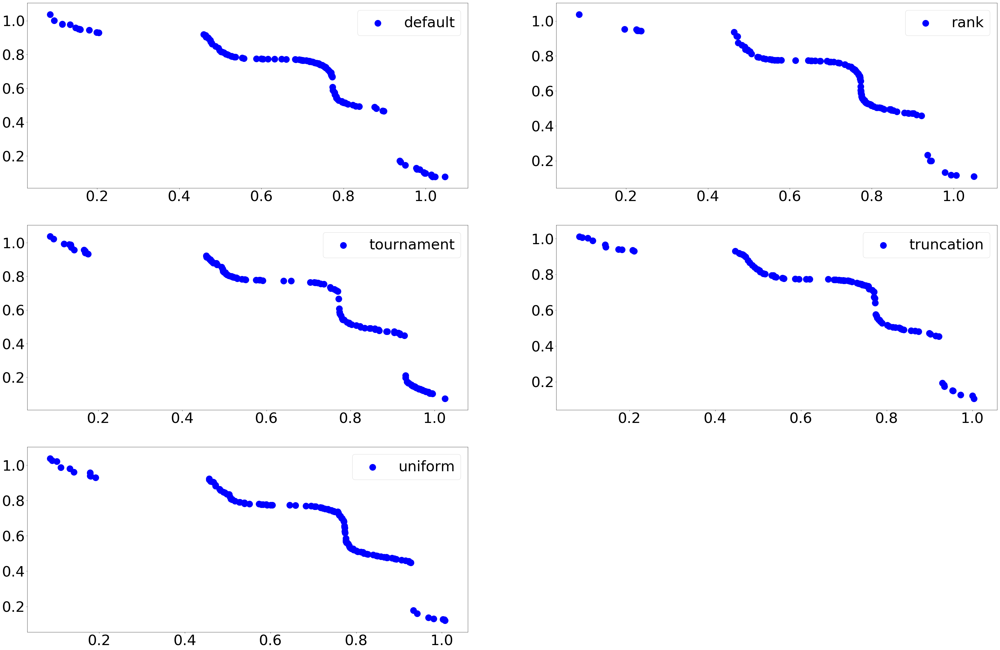

In [122]:
display_graph_3_selection(ea_default,ea_rank,ea_tournament,ea_truncation,ea_uniform)

### Comparison with Weighted sum ###

In [171]:
def NSGA2():
    randseed = 12345
    prng = random.Random(randseed)
    ea = inspyred.ec.emo.NSGA2(prng)
    ea.variator = [inspyred.ec.variators.blend_crossover,
                   inspyred.ec.variators.gaussian_mutation]
    ea.terminator = inspyred.ec.terminators.evaluation_termination
    ea.observer = [inspyred.ec.observers.archive_observer]
    final_pop = ea.evolve(generator=my_generator,
                          evaluator=my_evaluator_0_10,
                          pop_size=100,
                          maximize=False,
                          bounder=inspyred.ec.Bounder(1e-32, 3.14),
                          max_evaluations=5000)
    return ea

In [172]:
NSGA2()

----------------------------------------------------------------------------
                         Archive (    1 individuals)
----------------------------------------------------------------------------
[1.0027542609032862, 0.12815013213354015] : 0.12815013213354015
----------------------------------------------------------------------------


TypeError: object of type 'float' has no len()

In [173]:
tournament_selection = NSGA2_tournament_selection()

----------------------------------------------------------------------------
                         Archive (    4 individuals)
----------------------------------------------------------------------------
[0.513525119953246, 0.9052484115321475] : [0.513525119953246, 0.9052484115321475]
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[0.23701886249269838, 0.9446481996535763] : [0.23701886249269838, 0.9446481996535763]
[1.0027542609032862, 0.12815013213354015] : [1.0027542609032862, 0.12815013213354015]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (    4 individuals)
----------------------------------------------------------------------------
[0.513525119953246, 0.9052484115321475] : [0.513525119953246, 0.9052484115321475]
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[

----------------------------------------------------------------------------
                         Archive (   20 individuals)
----------------------------------------------------------------------------
[0.513525119953246, 0.9052484115321475] : [0.513525119953246, 0.9052484115321475]
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[0.23701886249269838, 0.9446481996535763] : [0.23701886249269838, 0.9446481996535763]
[1.0027542609032862, 0.12815013213354015] : [1.0027542609032862, 0.12815013213354015]
[0.9940779086608862, 0.1319702346616637] : [0.9940779086608862, 0.1319702346616637]
[0.5181448504485628, 0.8068550505638954] : [0.5181448504485628, 0.8068550505638954]
[0.9446766425048546, 0.1552156731413402] : [0.9446766425048546, 0.1552156731413402]
[0.8744736489970031, 0.5998390268166689] : [0.8744736489970031, 0.5998390268166689]
[0.6359159837694814, 0.773958418105087] : [0.6359159837694814, 0.773958418105087]
[0.9685786685986764, 0.154067056284

----------------------------------------------------------------------------
                         Archive (   28 individuals)
----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[0.23701886249269838, 0.9446481996535763] : [0.23701886249269838, 0.9446481996535763]
[0.5181448504485628, 0.8068550505638954] : [0.5181448504485628, 0.8068550505638954]
[0.9446766425048546, 0.1552156731413402] : [0.9446766425048546, 0.1552156731413402]
[0.6359159837694814, 0.773958418105087] : [0.6359159837694814, 0.773958418105087]
[1.0415849295641815, 0.09446778782976598] : [1.0415849295641815, 0.09446778782976598]
[0.24084742105036255, 0.9402983337329801] : [0.24084742105036255, 0.9402983337329801]
[0.7795456213044292, 0.6031749919689239] : [0.7795456213044292, 0.6031749919689239]
[0.8043216109217299, 0.5180235760194029] : [0.8043216109217299, 0.5180235760194029]
[0.9672134714538443, 0.12998063

[0.8043216109217299, 0.5180235760194029] : [0.8043216109217299, 0.5180235760194029]
[0.9672134714538443, 0.12998063894999656] : [0.9672134714538443, 0.12998063894999656]
[0.9044148745210909, 0.46592909215452427] : [0.9044148745210909, 0.46592909215452427]
[0.56600665151736, 0.7873217556341853] : [0.56600665151736, 0.7873217556341853]
[0.9563756914291822, 0.1391748649813662] : [0.9563756914291822, 0.1391748649813662]
[0.886065322222171, 0.4775594417984014] : [0.886065322222171, 0.4775594417984014]
[0.8433489883641045, 0.517687809430305] : [0.8433489883641045, 0.517687809430305]
[0.5074898457953639, 0.811851536814689] : [0.5074898457953639, 0.811851536814689]
[0.17372390344002597, 1.0002164934799243] : [0.17372390344002597, 1.0002164934799243]
[0.9949996666297514, 0.1025903301755402] : [0.9949996666297514, 0.1025903301755402]
[0.7812855902389434, 0.5973216350188923] : [0.7812855902389434, 0.5973216350188923]
[0.9344606549839003, 0.17349011639945522] : [0.9344606549839003, 0.1734901163994

[0.17372390344002597, 1.0002164934799243] : [0.17372390344002597, 1.0002164934799243]
[0.9949996666297514, 0.1025903301755402] : [0.9949996666297514, 0.1025903301755402]
[0.9344606549839003, 0.17349011639945522] : [0.9344606549839003, 0.17349011639945522]
[0.953512903756947, 0.14486049745459792] : [0.953512903756947, 0.14486049745459792]
[0.8667937932703573, 0.4830112478422478] : [0.8667937932703573, 0.4830112478422478]
[0.9713522101872003, 0.12475173185718222] : [0.9713522101872003, 0.12475173185718222]
[0.4631050697091216, 0.9144679146839036] : [0.4631050697091216, 0.9144679146839036]
[0.9435320012825912, 0.1676808580412204] : [0.9435320012825912, 0.1676808580412204]
[0.9629661031021342, 0.130810105895683] : [0.9629661031021342, 0.130810105895683]
[0.9519273225405694, 0.14750588123610986] : [0.9519273225405694, 0.14750588123610986]
[0.9685271798818021, 0.12625891172973921] : [0.9685271798818021, 0.12625891172973921]
[0.7524889339765513, 0.7535523247409964] : [0.7524889339765513, 0.75

[0.23701886249269838, 0.9446481996535763] : [0.23701886249269838, 0.9446481996535763]
[0.5181448504485628, 0.8068550505638954] : [0.5181448504485628, 0.8068550505638954]
[0.9446766425048546, 0.1552156731413402] : [0.9446766425048546, 0.1552156731413402]
[0.6359159837694814, 0.773958418105087] : [0.6359159837694814, 0.773958418105087]
[1.0415849295641815, 0.09446778782976598] : [1.0415849295641815, 0.09446778782976598]
[0.24084742105036255, 0.9402983337329801] : [0.24084742105036255, 0.9402983337329801]
[0.8043216109217299, 0.5180235760194029] : [0.8043216109217299, 0.5180235760194029]
[0.9672134714538443, 0.12998063894999656] : [0.9672134714538443, 0.12998063894999656]
[0.9044148745210909, 0.46592909215452427] : [0.9044148745210909, 0.46592909215452427]
[0.56600665151736, 0.7873217556341853] : [0.56600665151736, 0.7873217556341853]
[0.9563756914291822, 0.1391748649813662] : [0.9563756914291822, 0.1391748649813662]
[0.886065322222171, 0.4775594417984014] : [0.886065322222171, 0.47755944

[0.4631050697091216, 0.9144679146839036] : [0.4631050697091216, 0.9144679146839036]
[0.9629661031021342, 0.130810105895683] : [0.9629661031021342, 0.130810105895683]
[0.9685271798818021, 0.12625891172973921] : [0.9685271798818021, 0.12625891172973921]
[0.7524889339765513, 0.7535523247409964] : [0.7524889339765513, 0.7535523247409964]
[0.8239477363864007, 0.5174701214650229] : [0.8239477363864007, 0.5174701214650229]
[0.7779720598513781, 0.5847729393261809] : [0.7779720598513781, 0.5847729393261809]
[0.824092927518145, 0.5047342118930584] : [0.824092927518145, 0.5047342118930584]
[0.9869561023666245, 0.11805992621172143] : [0.9869561023666245, 0.11805992621172143]
[0.784704311422317, 0.5404565589470728] : [0.784704311422317, 0.5404565589470728]
[0.49567189410874646, 0.8449914734610389] : [0.49567189410874646, 0.8449914734610389]
[0.1324611130764476, 1.0316066172562595] : [0.1324611130764476, 1.0316066172562595]
[0.48970873386154457, 0.8784643784462944] : [0.48970873386154457, 0.87846437

[0.9044148745210909, 0.46592909215452427] : [0.9044148745210909, 0.46592909215452427]
[0.9563756914291822, 0.1391748649813662] : [0.9563756914291822, 0.1391748649813662]
[0.886065322222171, 0.4775594417984014] : [0.886065322222171, 0.4775594417984014]
[0.5074898457953639, 0.811851536814689] : [0.5074898457953639, 0.811851536814689]
[0.9949996666297514, 0.1025903301755402] : [0.9949996666297514, 0.1025903301755402]
[0.9344606549839003, 0.17349011639945522] : [0.9344606549839003, 0.17349011639945522]
[0.953512903756947, 0.14486049745459792] : [0.953512903756947, 0.14486049745459792]
[0.8667937932703573, 0.4830112478422478] : [0.8667937932703573, 0.4830112478422478]
[0.9713522101872003, 0.12475173185718222] : [0.9713522101872003, 0.12475173185718222]
[0.4631050697091216, 0.9144679146839036] : [0.4631050697091216, 0.9144679146839036]
[0.9629661031021342, 0.130810105895683] : [0.9629661031021342, 0.130810105895683]
[0.9685271798818021, 0.12625891172973921] : [0.9685271798818021, 0.126258911

[0.49567189410874646, 0.8449914734610389] : [0.49567189410874646, 0.8449914734610389]
[0.48970873386154457, 0.8784643784462944] : [0.48970873386154457, 0.8784643784462944]
[0.949816536479039, 0.15080906339824618] : [0.949816536479039, 0.15080906339824618]
[0.9540026985098125, 0.14432410638282855] : [0.9540026985098125, 0.14432410638282855]
[0.8495196892071321, 0.4907540458452065] : [0.8495196892071321, 0.4907540458452065]
[0.9356307390247763, 0.17077700853279923] : [0.9356307390247763, 0.17077700853279923]
[0.9720930679046745, 0.12250819244583348] : [0.9720930679046745, 0.12250819244583348]
[0.7738679618004469, 0.5878089817638413] : [0.7738679618004469, 0.5878089817638413]
[0.7457579591816267, 0.755485107607513] : [0.7457579591816267, 0.755485107607513]
[0.4951787019822323, 0.8608574242773607] : [0.4951787019822323, 0.8608574242773607]
[0.950458236097592, 0.14675954900333762] : [0.950458236097592, 0.14675954900333762]
[0.969535434519654, 0.12488182200709662] : [0.969535434519654, 0.124

[0.5322480242699189, 0.7936497770955608] : [0.5322480242699189, 0.7936497770955608]
[0.6053110286947647, 0.7746629774064232] : [0.6053110286947647, 0.7746629774064232]
[0.9458293379569012, 0.1526558176279152] : [0.9458293379569012, 0.1526558176279152]
[0.9499900151457811, 0.1477504311773782] : [0.9499900151457811, 0.1477504311773782]
[0.7598693881114256, 0.7298879565590847] : [0.7598693881114256, 0.7298879565590847]
[0.12960059023915724, 1.0222926530901937] : [0.12960059023915724, 1.0222926530901937]
[0.9589676608583416, 0.13818499634531956] : [0.9589676608583416, 0.13818499634531956]
[1.036448287170521, 0.0917357910090753] : [1.036448287170521, 0.0917357910090753]
[0.9499281727308392, 0.14999716618573136] : [0.9499281727308392, 0.14999716618573136]
[0.9043918993918851, 0.4696774000014828] : [0.9043918993918851, 0.4696774000014828]
[0.7040181451443231, 0.7648753374730456] : [0.7040181451443231, 0.7648753374730456]
[0.19433631184400682, 0.9471345940216409] : [0.19433631184400682, 0.9471

[1.0292413596962888, 0.10253263230056059] : [1.0292413596962888, 0.10253263230056059]
[0.7738484132519866, 0.6439184400455611] : [0.7738484132519866, 0.6439184400455611]
[0.9847368406149525, 0.11917961846094668] : [0.9847368406149525, 0.11917961846094668]
[0.9307653016044772, 0.211174082642426] : [0.9307653016044772, 0.211174082642426]
[0.8224687280419977, 0.5177192924554098] : [0.8224687280419977, 0.5177192924554098]
[0.17688204184880893, 0.955789835309386] : [0.17688204184880893, 0.955789835309386]
[0.7668192939763041, 0.7218136726987341] : [0.7668192939763041, 0.7218136726987341]
[0.9372140469459367, 0.16671415028349734] : [0.9372140469459367, 0.16671415028349734]
[0.9893867042781297, 0.10629311833015231] : [0.9893867042781297, 0.10629311833015231]
[0.5322480242699189, 0.7936497770955608] : [0.5322480242699189, 0.7936497770955608]
[0.6053110286947647, 0.7746629774064232] : [0.6053110286947647, 0.7746629774064232]
[0.9458293379569012, 0.1526558176279152] : [0.9458293379569012, 0.1526

[0.9869561023666245, 0.11805992621172143] : [0.9869561023666245, 0.11805992621172143]
[0.784704311422317, 0.5404565589470728] : [0.784704311422317, 0.5404565589470728]
[0.49567189410874646, 0.8449914734610389] : [0.49567189410874646, 0.8449914734610389]
[0.48970873386154457, 0.8784643784462944] : [0.48970873386154457, 0.8784643784462944]
[0.949816536479039, 0.15080906339824618] : [0.949816536479039, 0.15080906339824618]
[0.9540026985098125, 0.14432410638282855] : [0.9540026985098125, 0.14432410638282855]
[0.8495196892071321, 0.4907540458452065] : [0.8495196892071321, 0.4907540458452065]
[0.9356307390247763, 0.17077700853279923] : [0.9356307390247763, 0.17077700853279923]
[0.9720930679046745, 0.12250819244583348] : [0.9720930679046745, 0.12250819244583348]
[0.7738679618004469, 0.5878089817638413] : [0.7738679618004469, 0.5878089817638413]
[0.7457579591816267, 0.755485107607513] : [0.7457579591816267, 0.755485107607513]
[0.4951787019822323, 0.8608574242773607] : [0.4951787019822323, 0.86

[0.12960059023915724, 1.0222926530901937] : [0.12960059023915724, 1.0222926530901937]
[1.036448287170521, 0.0917357910090753] : [1.036448287170521, 0.0917357910090753]
[0.9499281727308392, 0.14999716618573136] : [0.9499281727308392, 0.14999716618573136]
[0.9043918993918851, 0.4696774000014828] : [0.9043918993918851, 0.4696774000014828]
[0.7040181451443231, 0.7648753374730456] : [0.7040181451443231, 0.7648753374730456]
[0.14251137603399755, 0.9563235559072146] : [0.14251137603399755, 0.9563235559072146]
[0.4570445623511165, 0.921225817581277] : [0.4570445623511165, 0.921225817581277]
[0.46888166422455313, 0.8911162584286141] : [0.46888166422455313, 0.8911162584286141]
[0.9282365673547597, 0.4482820192466724] : [0.9282365673547597, 0.4482820192466724]
[0.952621117210831, 0.14480038866728934] : [0.952621117210831, 0.14480038866728934]
[0.9217683960324068, 0.45763329895481425] : [0.9217683960324068, 0.45763329895481425]
[0.9170340940082132, 0.46028065757056985] : [0.9170340940082132, 0.460

[0.9140527944801479, 0.4641162196266698] : [0.9140527944801479, 0.4641162196266698]
[0.16879547299425046, 0.940187008106012] : [0.16879547299425046, 0.940187008106012]
[0.7815913206039058, 0.5426445147875497] : [0.7815913206039058, 0.5426445147875497]
[0.7360842414387075, 0.7632353794790541] : [0.7360842414387075, 0.7632353794790541]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (   83 individuals)
----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[0.5181448504485628, 0.8068550505638954] : [0.5181448504485628, 0.8068550505638954]
[0.9446766425048546, 0.1552156731413402] : [0.9446766425048546, 0.1552156731413402]
[0.6359159837694814, 0.773958418105087] : [0.6359159837694814, 0.773958418105087]
[0.9044148745210909, 0.46592909215452427] : 

[0.9629661031021342, 0.130810105895683] : [0.9629661031021342, 0.130810105895683]
[0.9685271798818021, 0.12625891172973921] : [0.9685271798818021, 0.12625891172973921]
[0.7524889339765513, 0.7535523247409964] : [0.7524889339765513, 0.7535523247409964]
[0.824092927518145, 0.5047342118930584] : [0.824092927518145, 0.5047342118930584]
[0.784704311422317, 0.5404565589470728] : [0.784704311422317, 0.5404565589470728]
[0.49567189410874646, 0.8449914734610389] : [0.49567189410874646, 0.8449914734610389]
[0.949816536479039, 0.15080906339824618] : [0.949816536479039, 0.15080906339824618]
[0.9540026985098125, 0.14432410638282855] : [0.9540026985098125, 0.14432410638282855]
[0.8495196892071321, 0.4907540458452065] : [0.8495196892071321, 0.4907540458452065]
[0.9356307390247763, 0.17077700853279923] : [0.9356307390247763, 0.17077700853279923]
[0.9720930679046745, 0.12250819244583348] : [0.9720930679046745, 0.12250819244583348]
[0.7738679618004469, 0.5878089817638413] : [0.7738679618004469, 0.587808

[0.9344606549839003, 0.17349011639945522] : [0.9344606549839003, 0.17349011639945522]
[0.8667937932703573, 0.4830112478422478] : [0.8667937932703573, 0.4830112478422478]
[0.9713522101872003, 0.12475173185718222] : [0.9713522101872003, 0.12475173185718222]
[0.9629661031021342, 0.130810105895683] : [0.9629661031021342, 0.130810105895683]
[0.9685271798818021, 0.12625891172973921] : [0.9685271798818021, 0.12625891172973921]
[0.7524889339765513, 0.7535523247409964] : [0.7524889339765513, 0.7535523247409964]
[0.824092927518145, 0.5047342118930584] : [0.824092927518145, 0.5047342118930584]
[0.784704311422317, 0.5404565589470728] : [0.784704311422317, 0.5404565589470728]
[0.49567189410874646, 0.8449914734610389] : [0.49567189410874646, 0.8449914734610389]
[0.949816536479039, 0.15080906339824618] : [0.949816536479039, 0.15080906339824618]
[0.9540026985098125, 0.14432410638282855] : [0.9540026985098125, 0.14432410638282855]
[0.8495196892071321, 0.4907540458452065] : [0.8495196892071321, 0.490754

[0.7387341710864821, 0.7571321313593886] : [0.7387341710864821, 0.7571321313593886]
[0.9137888208003817, 0.46412886307249845] : [0.9137888208003817, 0.46412886307249845]
[0.7777553984621094, 0.5705324854187978] : [0.7777553984621094, 0.5705324854187978]
[0.4569866818890793, 0.9221035896427298] : [0.4569866818890793, 0.9221035896427298]
[0.5114855235920757, 0.8053466631214483] : [0.5114855235920757, 0.8053466631214483]
[0.7572682905135804, 0.728614712304887] : [0.7572682905135804, 0.728614712304887]
[0.4576488160544343, 0.9129759563268355] : [0.4576488160544343, 0.9129759563268355]
[0.4609802589695281, 0.9106789577265867] : [0.4609802589695281, 0.9106789577265867]
[0.9713989613352009, 0.12421598556285686] : [0.9713989613352009, 0.12421598556285686]
[0.5205013617250782, 0.7947025306254502] : [0.5205013617250782, 0.7947025306254502]
[0.9623328308928549, 0.13173233956247643] : [0.9623328308928549, 0.13173233956247643]
[0.7521653932800553, 0.7352693905758099] : [0.7521653932800553, 0.735269

[0.9949996666297514, 0.1025903301755402] : [0.9949996666297514, 0.1025903301755402]
[0.9344606549839003, 0.17349011639945522] : [0.9344606549839003, 0.17349011639945522]
[0.8667937932703573, 0.4830112478422478] : [0.8667937932703573, 0.4830112478422478]
[0.9713522101872003, 0.12475173185718222] : [0.9713522101872003, 0.12475173185718222]
[0.9629661031021342, 0.130810105895683] : [0.9629661031021342, 0.130810105895683]
[0.9685271798818021, 0.12625891172973921] : [0.9685271798818021, 0.12625891172973921]
[0.824092927518145, 0.5047342118930584] : [0.824092927518145, 0.5047342118930584]
[0.784704311422317, 0.5404565589470728] : [0.784704311422317, 0.5404565589470728]
[0.49567189410874646, 0.8449914734610389] : [0.49567189410874646, 0.8449914734610389]
[0.8495196892071321, 0.4907540458452065] : [0.8495196892071321, 0.4907540458452065]
[0.9356307390247763, 0.17077700853279923] : [0.9356307390247763, 0.17077700853279923]
[0.9720930679046745, 0.12250819244583348] : [0.9720930679046745, 0.12250

[0.18693919895611422, 0.9350947038383778] : [0.18693919895611422, 0.9350947038383778]
[0.9394389987095466, 0.16421254964541432] : [0.9394389987095466, 0.16421254964541432]
[0.9875147391093336, 0.10621495282313109] : [0.9875147391093336, 0.10621495282313109]
[0.9852282188788863, 0.1128522535784658] : [0.9852282188788863, 0.1128522535784658]
[0.924604827634795, 0.4555428244001445] : [0.924604827634795, 0.4555428244001445]
[0.8683652784876569, 0.4776568782458468] : [0.8683652784876569, 0.4776568782458468]
[0.13414473005834698, 0.9872883615947192] : [0.13414473005834698, 0.9872883615947192]
[0.9570576727868733, 0.13737115561829513] : [0.9570576727868733, 0.13737115561829513]
[0.5945980297312583, 0.7750965452197958] : [0.5945980297312583, 0.7750965452197958]
[0.478657046567775, 0.8780601256865272] : [0.478657046567775, 0.8780601256865272]
[0.9140527944801479, 0.4641162196266698] : [0.9140527944801479, 0.4641162196266698]
[0.16879547299425046, 0.940187008106012] : [0.16879547299425046, 0.940

[0.9661456331799091, 0.12965402650408156] : [0.9661456331799091, 0.12965402650408156]
[0.8208894135222109, 0.5104973784546766] : [0.8208894135222109, 0.5104973784546766]
[0.18693919895611422, 0.9350947038383778] : [0.18693919895611422, 0.9350947038383778]
[0.9394389987095466, 0.16421254964541432] : [0.9394389987095466, 0.16421254964541432]
[0.9875147391093336, 0.10621495282313109] : [0.9875147391093336, 0.10621495282313109]
[0.9852282188788863, 0.1128522535784658] : [0.9852282188788863, 0.1128522535784658]
[0.924604827634795, 0.4555428244001445] : [0.924604827634795, 0.4555428244001445]
[0.8683652784876569, 0.4776568782458468] : [0.8683652784876569, 0.4776568782458468]
[0.13414473005834698, 0.9872883615947192] : [0.13414473005834698, 0.9872883615947192]
[0.9570576727868733, 0.13737115561829513] : [0.9570576727868733, 0.13737115561829513]
[0.5945980297312583, 0.7750965452197958] : [0.5945980297312583, 0.7750965452197958]
[0.478657046567775, 0.8780601256865272] : [0.478657046567775, 0.87

[0.924604827634795, 0.4555428244001445] : [0.924604827634795, 0.4555428244001445]
[0.8683652784876569, 0.4776568782458468] : [0.8683652784876569, 0.4776568782458468]
[0.13414473005834698, 0.9872883615947192] : [0.13414473005834698, 0.9872883615947192]
[0.9570576727868733, 0.13737115561829513] : [0.9570576727868733, 0.13737115561829513]
[0.5945980297312583, 0.7750965452197958] : [0.5945980297312583, 0.7750965452197958]
[0.478657046567775, 0.8780601256865272] : [0.478657046567775, 0.8780601256865272]
[0.9140527944801479, 0.4641162196266698] : [0.9140527944801479, 0.4641162196266698]
[0.16879547299425046, 0.940187008106012] : [0.16879547299425046, 0.940187008106012]
[0.7815913206039058, 0.5426445147875497] : [0.7815913206039058, 0.5426445147875497]
[0.464240678233725, 0.9022504864905279] : [0.464240678233725, 0.9022504864905279]
[1.0245820554604936, 0.07306302884628209] : [1.0245820554604936, 0.07306302884628209]
[0.7972218854638855, 0.5182950089638007] : [0.7972218854638855, 0.5182950089

[0.9563756914291822, 0.1391748649813662] : [0.9563756914291822, 0.1391748649813662]
[0.886065322222171, 0.4775594417984014] : [0.886065322222171, 0.4775594417984014]
[0.9949996666297514, 0.1025903301755402] : [0.9949996666297514, 0.1025903301755402]
[0.9344606549839003, 0.17349011639945522] : [0.9344606549839003, 0.17349011639945522]
[0.8667937932703573, 0.4830112478422478] : [0.8667937932703573, 0.4830112478422478]
[0.9713522101872003, 0.12475173185718222] : [0.9713522101872003, 0.12475173185718222]
[0.9629661031021342, 0.130810105895683] : [0.9629661031021342, 0.130810105895683]
[0.9685271798818021, 0.12625891172973921] : [0.9685271798818021, 0.12625891172973921]
[0.824092927518145, 0.5047342118930584] : [0.824092927518145, 0.5047342118930584]
[0.784704311422317, 0.5404565589470728] : [0.784704311422317, 0.5404565589470728]
[0.49567189410874646, 0.8449914734610389] : [0.49567189410874646, 0.8449914734610389]
[0.8495196892071321, 0.4907540458452065] : [0.8495196892071321, 0.4907540458

[0.478657046567775, 0.8780601256865272] : [0.478657046567775, 0.8780601256865272]
[0.9140527944801479, 0.4641162196266698] : [0.9140527944801479, 0.4641162196266698]
[0.16879547299425046, 0.940187008106012] : [0.16879547299425046, 0.940187008106012]
[0.7815913206039058, 0.5426445147875497] : [0.7815913206039058, 0.5426445147875497]
[0.464240678233725, 0.9022504864905279] : [0.464240678233725, 0.9022504864905279]
[1.0245820554604936, 0.07306302884628209] : [1.0245820554604936, 0.07306302884628209]
[0.7972218854638855, 0.5182950089638007] : [0.7972218854638855, 0.5182950089638007]
[0.9137888208003817, 0.46412886307249845] : [0.9137888208003817, 0.46412886307249845]
[0.7777553984621094, 0.5705324854187978] : [0.7777553984621094, 0.5705324854187978]
[0.4569866818890793, 0.9221035896427298] : [0.4569866818890793, 0.9221035896427298]
[0.5114855235920757, 0.8053466631214483] : [0.5114855235920757, 0.8053466631214483]
[0.7572682905135804, 0.728614712304887] : [0.7572682905135804, 0.72861471230

[0.6060377864103568, 0.7744636368607669] : [0.6060377864103568, 0.7744636368607669]
[0.6042616440180243, 0.7746366351418211] : [0.6042616440180243, 0.7746366351418211]
[0.7154205564996576, 0.762668348316895] : [0.7154205564996576, 0.762668348316895]
[0.4800233773115863, 0.8777674473716456] : [0.4800233773115863, 0.8777674473716456]
[0.5446897232805308, 0.7861602848132845] : [0.5446897232805308, 0.7861602848132845]
[0.6591235073648215, 0.7721248293715859] : [0.6591235073648215, 0.7721248293715859]
[0.9790136761480177, 0.11542817732165468] : [0.9790136761480177, 0.11542817732165468]
[0.5423693562813136, 0.7900528044971618] : [0.5423693562813136, 0.7900528044971618]
[0.7174886797858341, 0.7624144372420861] : [0.7174886797858341, 0.7624144372420861]
[0.9924747105275389, 0.1044063337100748] : [0.9924747105275389, 0.1044063337100748]
[0.7292274380671189, 0.7549064053013187] : [0.7292274380671189, 0.7549064053013187]
[0.8583380894578342, 0.4892537419404215] : [0.8583380894578342, 0.4892537419

[0.9217683960324068, 0.45763329895481425] : [0.9217683960324068, 0.45763329895481425]
[0.9170340940082132, 0.46028065757056985] : [0.9170340940082132, 0.46028065757056985]
[0.9042266663893731, 0.47149251396777164] : [0.9042266663893731, 0.47149251396777164]
[0.5484580076778668, 0.7823347468992851] : [0.5484580076778668, 0.7823347468992851]
[0.5038973057634868, 0.8133008966636578] : [0.5038973057634868, 0.8133008966636578]
[0.7963276145914848, 0.5245965627583606] : [0.7963276145914848, 0.5245965627583606]
[0.7733790912916645, 0.7041415076196202] : [0.7733790912916645, 0.7041415076196202]
[0.5055284401568257, 0.8115045236090657] : [0.5055284401568257, 0.8115045236090657]
[0.9330537079357243, 0.2070675749520614] : [0.9330537079357243, 0.2070675749520614]
[0.7744667822633957, 0.5777116462154724] : [0.7744667822633957, 0.5777116462154724]
[0.8027360807111844, 0.5140361020661318] : [0.8027360807111844, 0.5140361020661318]
[0.7665505132178452, 0.7156470434559445] : [0.7665505132178452, 0.7156

[0.5322480242699189, 0.7936497770955608] : [0.5322480242699189, 0.7936497770955608]
[0.9458293379569012, 0.1526558176279152] : [0.9458293379569012, 0.1526558176279152]
[0.12960059023915724, 1.0222926530901937] : [0.12960059023915724, 1.0222926530901937]
[0.9043918993918851, 0.4696774000014828] : [0.9043918993918851, 0.4696774000014828]
[0.7040181451443231, 0.7648753374730456] : [0.7040181451443231, 0.7648753374730456]
[0.14251137603399755, 0.9563235559072146] : [0.14251137603399755, 0.9563235559072146]
[0.4570445623511165, 0.921225817581277] : [0.4570445623511165, 0.921225817581277]
[0.46888166422455313, 0.8911162584286141] : [0.46888166422455313, 0.8911162584286141]
[0.9282365673547597, 0.4482820192466724] : [0.9282365673547597, 0.4482820192466724]
[0.952621117210831, 0.14480038866728934] : [0.952621117210831, 0.14480038866728934]
[0.9217683960324068, 0.45763329895481425] : [0.9217683960324068, 0.45763329895481425]
[0.9170340940082132, 0.46028065757056985] : [0.9170340940082132, 0.460

[0.5414269138808483, 0.789526273537772] : [0.5414269138808483, 0.789526273537772]
[0.5916056672941956, 0.7738152183973106] : [0.5916056672941956, 0.7738152183973106]
[0.8852576499082098, 0.4716273358494029] : [0.8852576499082098, 0.4716273358494029]
[0.9479177419627902, 0.14982715798086668] : [0.9479177419627902, 0.14982715798086668]
[0.5106459070466522, 0.8042058820325516] : [0.5106459070466522, 0.8042058820325516]
[0.17441351533371643, 0.9346824250758785] : [0.17441351533371643, 0.9346824250758785]
[0.541907527894786, 0.78311775159517] : [0.541907527894786, 0.78311775159517]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (  112 individuals)
----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[0.9446766425048546, 0.1552156731413402] : [0.

[0.9344606549839003, 0.17349011639945522] : [0.9344606549839003, 0.17349011639945522]
[0.8667937932703573, 0.4830112478422478] : [0.8667937932703573, 0.4830112478422478]
[0.9713522101872003, 0.12475173185718222] : [0.9713522101872003, 0.12475173185718222]
[0.9629661031021342, 0.130810105895683] : [0.9629661031021342, 0.130810105895683]
[0.9685271798818021, 0.12625891172973921] : [0.9685271798818021, 0.12625891172973921]
[0.824092927518145, 0.5047342118930584] : [0.824092927518145, 0.5047342118930584]
[0.784704311422317, 0.5404565589470728] : [0.784704311422317, 0.5404565589470728]
[0.49567189410874646, 0.8449914734610389] : [0.49567189410874646, 0.8449914734610389]
[0.8495196892071321, 0.4907540458452065] : [0.8495196892071321, 0.4907540458452065]
[0.9356307390247763, 0.17077700853279923] : [0.9356307390247763, 0.17077700853279923]
[0.9720930679046745, 0.12250819244583348] : [0.9720930679046745, 0.12250819244583348]
[0.7738679618004469, 0.5878089817638413] : [0.7738679618004469, 0.5878

[0.9720930679046745, 0.12250819244583348] : [0.9720930679046745, 0.12250819244583348]
[0.7738679618004469, 0.5878089817638413] : [0.7738679618004469, 0.5878089817638413]
[0.950458236097592, 0.14675954900333762] : [0.950458236097592, 0.14675954900333762]
[0.969535434519654, 0.12488182200709662] : [0.969535434519654, 0.12488182200709662]
[0.9307653016044772, 0.211174082642426] : [0.9307653016044772, 0.211174082642426]
[0.9372140469459367, 0.16671415028349734] : [0.9372140469459367, 0.16671415028349734]
[0.9458293379569012, 0.1526558176279152] : [0.9458293379569012, 0.1526558176279152]
[0.12960059023915724, 1.0222926530901937] : [0.12960059023915724, 1.0222926530901937]
[0.9043918993918851, 0.4696774000014828] : [0.9043918993918851, 0.4696774000014828]
[0.7040181451443231, 0.7648753374730456] : [0.7040181451443231, 0.7648753374730456]
[0.14251137603399755, 0.9563235559072146] : [0.14251137603399755, 0.9563235559072146]
[0.4570445623511165, 0.921225817581277] : [0.4570445623511165, 0.92122

[0.8027360807111844, 0.5140361020661318] : [0.8027360807111844, 0.5140361020661318]
[0.7665505132178452, 0.7156470434559445] : [0.7665505132178452, 0.7156470434559445]
[0.9661456331799091, 0.12965402650408156] : [0.9661456331799091, 0.12965402650408156]
[0.9394389987095466, 0.16421254964541432] : [0.9394389987095466, 0.16421254964541432]
[0.9875147391093336, 0.10621495282313109] : [0.9875147391093336, 0.10621495282313109]
[0.9852282188788863, 0.1128522535784658] : [0.9852282188788863, 0.1128522535784658]
[0.924604827634795, 0.4555428244001445] : [0.924604827634795, 0.4555428244001445]
[0.8683652784876569, 0.4776568782458468] : [0.8683652784876569, 0.4776568782458468]
[0.13414473005834698, 0.9872883615947192] : [0.13414473005834698, 0.9872883615947192]
[0.9570576727868733, 0.13737115561829513] : [0.9570576727868733, 0.13737115561829513]
[0.478657046567775, 0.8780601256865272] : [0.478657046567775, 0.8780601256865272]
[0.9140527944801479, 0.4641162196266698] : [0.9140527944801479, 0.4641

[0.7732753613387405, 0.6947155709663773] : [0.7732753613387405, 0.6947155709663773]
[0.5282489693524541, 0.7915552527161651] : [0.5282489693524541, 0.7915552527161651]
[0.7801796521506843, 0.5492992577333138] : [0.7801796521506843, 0.5492992577333138]
[0.8877959451593312, 0.4715742412610852] : [0.8877959451593312, 0.4715742412610852]
----------------------------------------------------------------------------
----------------------------------------------------------------------------
                         Archive (  122 individuals)
----------------------------------------------------------------------------
[0.08564574219993279, 1.0376627598145327] : [0.08564574219993279, 1.0376627598145327]
[0.9446766425048546, 0.1552156731413402] : [0.9446766425048546, 0.1552156731413402]
[0.9044148745210909, 0.46592909215452427] : [0.9044148745210909, 0.46592909215452427]
[0.9949996666297514, 0.1025903301755402] : [0.9949996666297514, 0.1025903301755402]
[0.9344606549839003, 0.17349011639945522

[0.950458236097592, 0.14675954900333762] : [0.950458236097592, 0.14675954900333762]
[0.969535434519654, 0.12488182200709662] : [0.969535434519654, 0.12488182200709662]
[0.9307653016044772, 0.211174082642426] : [0.9307653016044772, 0.211174082642426]
[0.9372140469459367, 0.16671415028349734] : [0.9372140469459367, 0.16671415028349734]
[0.9458293379569012, 0.1526558176279152] : [0.9458293379569012, 0.1526558176279152]
[0.12960059023915724, 1.0222926530901937] : [0.12960059023915724, 1.0222926530901937]
[0.9043918993918851, 0.4696774000014828] : [0.9043918993918851, 0.4696774000014828]
[0.7040181451443231, 0.7648753374730456] : [0.7040181451443231, 0.7648753374730456]
[0.14251137603399755, 0.9563235559072146] : [0.14251137603399755, 0.9563235559072146]
[0.4570445623511165, 0.921225817581277] : [0.4570445623511165, 0.921225817581277]
[0.46888166422455313, 0.8911162584286141] : [0.46888166422455313, 0.8911162584286141]
[0.9282365673547597, 0.4482820192466724] : [0.9282365673547597, 0.448282

[0.5038973057634868, 0.8133008966636578] : [0.5038973057634868, 0.8133008966636578]
[0.7963276145914848, 0.5245965627583606] : [0.7963276145914848, 0.5245965627583606]
[0.5055284401568257, 0.8115045236090657] : [0.5055284401568257, 0.8115045236090657]
[0.7744667822633957, 0.5777116462154724] : [0.7744667822633957, 0.5777116462154724]
[0.8027360807111844, 0.5140361020661318] : [0.8027360807111844, 0.5140361020661318]
[0.7665505132178452, 0.7156470434559445] : [0.7665505132178452, 0.7156470434559445]
[0.9661456331799091, 0.12965402650408156] : [0.9661456331799091, 0.12965402650408156]
[0.9394389987095466, 0.16421254964541432] : [0.9394389987095466, 0.16421254964541432]
[0.9875147391093336, 0.10621495282313109] : [0.9875147391093336, 0.10621495282313109]
[0.9852282188788863, 0.1128522535784658] : [0.9852282188788863, 0.1128522535784658]
[0.924604827634795, 0.4555428244001445] : [0.924604827634795, 0.4555428244001445]
[0.8683652784876569, 0.4776568782458468] : [0.8683652784876569, 0.477656

[0.9356307390247763, 0.17077700853279923] : [0.9356307390247763, 0.17077700853279923]
[0.9720930679046745, 0.12250819244583348] : [0.9720930679046745, 0.12250819244583348]
[0.7738679618004469, 0.5878089817638413] : [0.7738679618004469, 0.5878089817638413]
[0.950458236097592, 0.14675954900333762] : [0.950458236097592, 0.14675954900333762]
[0.969535434519654, 0.12488182200709662] : [0.969535434519654, 0.12488182200709662]
[0.9307653016044772, 0.211174082642426] : [0.9307653016044772, 0.211174082642426]
[0.9372140469459367, 0.16671415028349734] : [0.9372140469459367, 0.16671415028349734]
[0.9458293379569012, 0.1526558176279152] : [0.9458293379569012, 0.1526558176279152]
[0.12960059023915724, 1.0222926530901937] : [0.12960059023915724, 1.0222926530901937]
[0.9043918993918851, 0.4696774000014828] : [0.9043918993918851, 0.4696774000014828]
[0.7040181451443231, 0.7648753374730456] : [0.7040181451443231, 0.7648753374730456]
[0.14251137603399755, 0.9563235559072146] : [0.14251137603399755, 0.95

[0.12960059023915724, 1.0222926530901937] : [0.12960059023915724, 1.0222926530901937]
[0.9043918993918851, 0.4696774000014828] : [0.9043918993918851, 0.4696774000014828]
[0.7040181451443231, 0.7648753374730456] : [0.7040181451443231, 0.7648753374730456]
[0.14251137603399755, 0.9563235559072146] : [0.14251137603399755, 0.9563235559072146]
[0.4570445623511165, 0.921225817581277] : [0.4570445623511165, 0.921225817581277]
[0.46888166422455313, 0.8911162584286141] : [0.46888166422455313, 0.8911162584286141]
[0.9282365673547597, 0.4482820192466724] : [0.9282365673547597, 0.4482820192466724]
[0.952621117210831, 0.14480038866728934] : [0.952621117210831, 0.14480038866728934]
[0.9217683960324068, 0.45763329895481425] : [0.9217683960324068, 0.45763329895481425]
[0.9170340940082132, 0.46028065757056985] : [0.9170340940082132, 0.46028065757056985]
[0.9042266663893731, 0.47149251396777164] : [0.9042266663893731, 0.47149251396777164]
[0.5484580076778668, 0.7823347468992851] : [0.5484580076778668, 0.

[0.9720930679046745, 0.12250819244583348] : [0.9720930679046745, 0.12250819244583348]
[0.7738679618004469, 0.5878089817638413] : [0.7738679618004469, 0.5878089817638413]
[0.950458236097592, 0.14675954900333762] : [0.950458236097592, 0.14675954900333762]
[0.969535434519654, 0.12488182200709662] : [0.969535434519654, 0.12488182200709662]
[0.9307653016044772, 0.211174082642426] : [0.9307653016044772, 0.211174082642426]
[0.9372140469459367, 0.16671415028349734] : [0.9372140469459367, 0.16671415028349734]
[0.9458293379569012, 0.1526558176279152] : [0.9458293379569012, 0.1526558176279152]
[0.9043918993918851, 0.4696774000014828] : [0.9043918993918851, 0.4696774000014828]
[0.7040181451443231, 0.7648753374730456] : [0.7040181451443231, 0.7648753374730456]
[0.14251137603399755, 0.9563235559072146] : [0.14251137603399755, 0.9563235559072146]
[0.4570445623511165, 0.921225817581277] : [0.4570445623511165, 0.921225817581277]
[0.46888166422455313, 0.8911162584286141] : [0.46888166422455313, 0.891116

[0.9888346201279585, 0.10530495381645325] : [0.9888346201279585, 0.10530495381645325]
[0.9523754870501644, 0.14581845541903415] : [0.9523754870501644, 0.14581845541903415]
[0.9534475280200626, 0.14430660784231897] : [0.9534475280200626, 0.14430660784231897]
[0.944895462924092, 0.15430558501208644] : [0.944895462924092, 0.15430558501208644]
[0.4731618451152314, 0.8788259756568726] : [0.4731618451152314, 0.8788259756568726]
[0.9491293198484623, 0.1473517046574529] : [0.9491293198484623, 0.1473517046574529]
[0.7154205564996576, 0.762668348316895] : [0.7154205564996576, 0.762668348316895]
[0.4800233773115863, 0.8777674473716456] : [0.4800233773115863, 0.8777674473716456]
[0.6591235073648215, 0.7721248293715859] : [0.6591235073648215, 0.7721248293715859]
[0.9790136761480177, 0.11542817732165468] : [0.9790136761480177, 0.11542817732165468]
[0.7174886797858341, 0.7624144372420861] : [0.7174886797858341, 0.7624144372420861]
[0.9924747105275389, 0.1044063337100748] : [0.9924747105275389, 0.1044

[0.4706375404189532, 0.8862037568138784] : [0.4706375404189532, 0.8862037568138784]
[0.7137786609293708, 0.7642373076243704] : [0.7137786609293708, 0.7642373076243704]
[0.9558732648565109, 0.1391130019793375] : [0.9558732648565109, 0.1391130019793375]
[0.7809055463328269, 0.5484066971200942] : [0.7809055463328269, 0.5484066971200942]
[0.4674758152965456, 0.8949471948203596] : [0.4674758152965456, 0.8949471948203596]
[0.791573996578404, 0.5275242670990842] : [0.791573996578404, 0.5275242670990842]
[0.5066581792361652, 0.8103645423042913] : [0.5066581792361652, 0.8103645423042913]
[0.9550440908590394, 0.14025145532600863] : [0.9550440908590394, 0.14025145532600863]
[0.17579623307759107, 0.9332134858820662] : [0.17579623307759107, 0.9332134858820662]
[0.5916056672941956, 0.7738152183973106] : [0.5916056672941956, 0.7738152183973106]
[0.8852576499082098, 0.4716273358494029] : [0.8852576499082098, 0.4716273358494029]
[0.9479177419627902, 0.14982715798086668] : [0.9479177419627902, 0.1498271

[0.9307653016044772, 0.211174082642426] : [0.9307653016044772, 0.211174082642426]
[0.9372140469459367, 0.16671415028349734] : [0.9372140469459367, 0.16671415028349734]
[0.9458293379569012, 0.1526558176279152] : [0.9458293379569012, 0.1526558176279152]
[0.9043918993918851, 0.4696774000014828] : [0.9043918993918851, 0.4696774000014828]
[0.7040181451443231, 0.7648753374730456] : [0.7040181451443231, 0.7648753374730456]
[0.14251137603399755, 0.9563235559072146] : [0.14251137603399755, 0.9563235559072146]
[0.4570445623511165, 0.921225817581277] : [0.4570445623511165, 0.921225817581277]
[0.46888166422455313, 0.8911162584286141] : [0.46888166422455313, 0.8911162584286141]
[0.9282365673547597, 0.4482820192466724] : [0.9282365673547597, 0.4482820192466724]
[0.952621117210831, 0.14480038866728934] : [0.952621117210831, 0.14480038866728934]
[0.9170340940082132, 0.46028065757056985] : [0.9170340940082132, 0.46028065757056985]
[0.9042266663893731, 0.47149251396777164] : [0.9042266663893731, 0.47149

[0.8852576499082098, 0.4716273358494029] : [0.8852576499082098, 0.4716273358494029]
[0.9479177419627902, 0.14982715798086668] : [0.9479177419627902, 0.14982715798086668]
[0.5106459070466522, 0.8042058820325516] : [0.5106459070466522, 0.8042058820325516]
[0.17441351533371643, 0.9346824250758785] : [0.17441351533371643, 0.9346824250758785]
[0.541907527894786, 0.78311775159517] : [0.541907527894786, 0.78311775159517]
[0.5026307691334927, 0.8221327071995923] : [0.5026307691334927, 0.8221327071995923]
[0.4968391783415034, 0.829701179052359] : [0.4968391783415034, 0.829701179052359]
[0.46813201632646984, 0.8932169320917953] : [0.46813201632646984, 0.8932169320917953]
[0.4667072802001328, 0.8996703098438064] : [0.4667072802001328, 0.8996703098438064]
[0.9312639356337636, 0.1964701159666623] : [0.9312639356337636, 0.1964701159666623]
[0.48125730606742384, 0.8771984643912276] : [0.48125730606742384, 0.8771984643912276]
[0.5850780918137926, 0.7774464739105766] : [0.5850780918137926, 0.7774464739

In [186]:
def display_graph(ea):
    final_arc = ea.archive
    x = []
    y = []
    for f in final_arc:
        x.append(f.fitness[0])
        y.append(f.fitness[1])
    _=plt.scatter(x, y, color='b')
    _=plt.scatter([0.0856,1.0377],[1.0027,0.1282],marker="h",color='r',s=50**2)
    _=plt.xlabel("Function 1")
    _=plt.ylabel("Function 2")
    plt.show()

In [187]:
pylab.rcParams['figure.figsize'] = 30, 20  # that's default image size for this interactive session

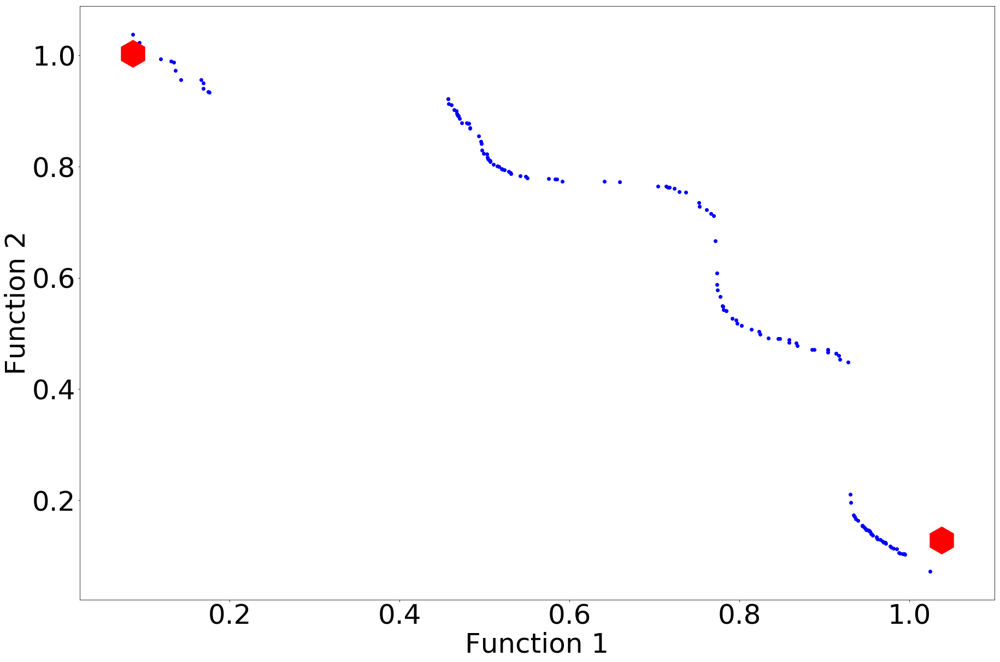

In [188]:
display_graph(tournament_selection)

### Accessory Functions ###

In [101]:
def NSGA2_default_selection():
    randseed = 12345
    prng = random.Random(randseed)
    ea = inspyred.ec.emo.NSGA2(prng)
    ea.selector = inspyred.ec.selectors.default_selection
    ea.variator = [inspyred.ec.variators.blend_crossover,
                   inspyred.ec.variators.gaussian_mutation]
    ea.terminator = inspyred.ec.terminators.evaluation_termination
    ea.observer = [inspyred.ec.observers.archive_observer]
    final_pop = ea.evolve(generator=my_generator,
                          evaluator=my_evaluator,
                          pop_size=100,
                          maximize=False,
                          bounder=inspyred.ec.Bounder(1e-32, 3.14),
                          max_evaluations=5000)
    return ea

In [102]:
def NSGA2_fitness_proportionate_selection():
    randseed = 12345
    prng = random.Random(randseed)
    ea = inspyred.ec.emo.NSGA2(prng)
    ea.selector = inspyred.ec.selectors.fitness_proportionate_selection
    ea.variator = [inspyred.ec.variators.blend_crossover,
                   inspyred.ec.variators.gaussian_mutation]
    ea.terminator = inspyred.ec.terminators.evaluation_termination
    ea.observer = [inspyred.ec.observers.archive_observer]
    final_pop = ea.evolve(generator=my_generator,
                          evaluator=my_evaluator,
                          pop_size=100,
                          num_selected = 10,
                          maximize=False,
                          bounder=inspyred.ec.Bounder(1e-32, 3.14),
                          max_evaluations=5000)
    return ea

In [103]:
def NSGA2_rank_selection():
    randseed = 12345
    prng = random.Random(randseed)
    ea = inspyred.ec.emo.NSGA2(prng)
    ea.selector = inspyred.ec.selectors.rank_selection
    ea.variator = [inspyred.ec.variators.blend_crossover,
                   inspyred.ec.variators.gaussian_mutation]
    ea.terminator = inspyred.ec.terminators.evaluation_termination
    ea.observer = [inspyred.ec.observers.archive_observer]
    final_pop = ea.evolve(generator=my_generator,
                          evaluator=my_evaluator,
                          pop_size=100,
                          num_selected = 10,
                          maximize=False,
                          bounder=inspyred.ec.Bounder(1e-32, 3.14),
                          max_evaluations=5000)
    return ea

In [104]:
def NSGA2_truncation_selection():
    randseed = 12345
    prng = random.Random(randseed)
    ea = inspyred.ec.emo.NSGA2(prng)
    ea.selector = inspyred.ec.selectors.truncation_selection
    ea.variator = [inspyred.ec.variators.blend_crossover,
                   inspyred.ec.variators.gaussian_mutation]
    ea.terminator = inspyred.ec.terminators.evaluation_termination
    ea.observer = [inspyred.ec.observers.archive_observer]
    final_pop = ea.evolve(generator=my_generator,
                          evaluator=my_evaluator,
                          pop_size=100,
                          num_selected = 10,
                          maximize=False,
                          bounder=inspyred.ec.Bounder(1e-32, 3.14),
                          max_evaluations=5000)
    return ea

In [105]:
def NSGA2_uniform_selection():
    randseed = 12345
    prng = random.Random(randseed)
    ea = inspyred.ec.emo.NSGA2(prng)
    ea.selector = inspyred.ec.selectors.uniform_selection
    ea.variator = [inspyred.ec.variators.blend_crossover,
                   inspyred.ec.variators.gaussian_mutation]
    ea.terminator = inspyred.ec.terminators.evaluation_termination
    ea.observer = [inspyred.ec.observers.archive_observer]
    final_pop = ea.evolve(generator=my_generator,
                          evaluator=my_evaluator,
                          pop_size=100,
                          num_selected = 10,
                          maximize=False,
                          bounder=inspyred.ec.Bounder(1e-32, 3.14),
                          max_evaluations=5000)
    return ea

In [106]:
def NSGA2_tournament_selection():
    randseed = 12345
    prng = random.Random(randseed)
    ea = inspyred.ec.emo.NSGA2(prng)
    ea.selector = inspyred.ec.selectors.tournament_selection
    ea.variator = [inspyred.ec.variators.blend_crossover,
                   inspyred.ec.variators.gaussian_mutation]
    ea.terminator = inspyred.ec.terminators.evaluation_termination
    ea.observer = [inspyred.ec.observers.archive_observer]
    final_pop = ea.evolve(generator=my_generator,
                          evaluator=my_evaluator,
                          pop_size=100,
                          num_selected = 10,
                          tournament_size=5,
                          maximize=False,
                          bounder=inspyred.ec.Bounder(1e-32, 3.14),
                          max_evaluations=5000)
    return ea

In [133]:
@inspyred.ec.evaluators.evaluator
def my_evaluator_1_9(candidate, args):
    x1 = candidate[0]
    x2 = candidate[1]
    c1 = x1 ** 2 + x2 ** 2 - 1 - 0.1 * math.cos(16*math.atan(x1/x2))
    c2 = (x1 - 0.5) ** 2 + (x2 - 0.5) ** 2
    
    if c1 < 0:
        x1 += 3.14 + abs(c1)
        x2 += 3.14 + abs(c1)
    if c2 > 0.5:
        x1 += 3.14 + (c2 - 0.5)
        x2 += 3.14 + (c2 - 0.5)
    return 0.1*x1+0.9*x2

In [134]:
@inspyred.ec.evaluators.evaluator
def my_evaluator_2_8(candidate, args):
    x1 = candidate[0]
    x2 = candidate[1]
    c1 = x1 ** 2 + x2 ** 2 - 1 - 0.1 * math.cos(16*math.atan(x1/x2))
    c2 = (x1 - 0.5) ** 2 + (x2 - 0.5) ** 2
    
    if c1 < 0:
        x1 += 3.14 + abs(c1)
        x2 += 3.14 + abs(c1)
    if c2 > 0.5:
        x1 += 3.14 + (c2 - 0.5)
        x2 += 3.14 + (c2 - 0.5)
    return 0.2*x1+0.8*x2

In [135]:
@inspyred.ec.evaluators.evaluator
def my_evaluator_3_7(candidate, args):
    x1 = candidate[0]
    x2 = candidate[1]
    c1 = x1 ** 2 + x2 ** 2 - 1 - 0.1 * math.cos(16*math.atan(x1/x2))
    c2 = (x1 - 0.5) ** 2 + (x2 - 0.5) ** 2
    
    if c1 < 0:
        x1 += 3.14 + abs(c1)
        x2 += 3.14 + abs(c1)
    if c2 > 0.5:
        x1 += 3.14 + (c2 - 0.5)
        x2 += 3.14 + (c2 - 0.5)
    return 0.3*x1+0.7*x2

In [136]:
@inspyred.ec.evaluators.evaluator
def my_evaluator_4_6(candidate, args):
    x1 = candidate[0]
    x2 = candidate[1]
    c1 = x1 ** 2 + x2 ** 2 - 1 - 0.1 * math.cos(16*math.atan(x1/x2))
    c2 = (x1 - 0.5) ** 2 + (x2 - 0.5) ** 2
    
    if c1 < 0:
        x1 += 3.14 + abs(c1)
        x2 += 3.14 + abs(c1)
    if c2 > 0.5:
        x1 += 3.14 + (c2 - 0.5)
        x2 += 3.14 + (c2 - 0.5)
    return 0.4*x1+0.6*x2

In [137]:
@inspyred.ec.evaluators.evaluator
def my_evaluator_5_5(candidate, args):
    x1 = candidate[0]
    x2 = candidate[1]
    c1 = x1 ** 2 + x2 ** 2 - 1 - 0.1 * math.cos(16*math.atan(x1/x2))
    c2 = (x1 - 0.5) ** 2 + (x2 - 0.5) ** 2
    
    if c1 < 0:
        x1 += 3.14 + abs(c1)
        x2 += 3.14 + abs(c1)
    if c2 > 0.5:
        x1 += 3.14 + (c2 - 0.5)
        x2 += 3.14 + (c2 - 0.5)
    return 0.5*x1+0.5*x2

In [138]:
@inspyred.ec.evaluators.evaluator
def my_evaluator_6_4(candidate, args):
    x1 = candidate[0]
    x2 = candidate[1]
    c1 = x1 ** 2 + x2 ** 2 - 1 - 0.1 * math.cos(16*math.atan(x1/x2))
    c2 = (x1 - 0.5) ** 2 + (x2 - 0.5) ** 2
    
    if c1 < 0:
        x1 += 3.14 + abs(c1)
        x2 += 3.14 + abs(c1)
    if c2 > 0.5:
        x1 += 3.14 + (c2 - 0.5)
        x2 += 3.14 + (c2 - 0.5)
    return 0.6*x1+0.4*x2

In [139]:
@inspyred.ec.evaluators.evaluator
def my_evaluator_7_3(candidate, args):
    x1 = candidate[0]
    x2 = candidate[1]
    c1 = x1 ** 2 + x2 ** 2 - 1 - 0.1 * math.cos(16*math.atan(x1/x2))
    c2 = (x1 - 0.5) ** 2 + (x2 - 0.5) ** 2
    
    if c1 < 0:
        x1 += 3.14 + abs(c1)
        x2 += 3.14 + abs(c1)
    if c2 > 0.5:
        x1 += 3.14 + (c2 - 0.5)
        x2 += 3.14 + (c2 - 0.5)
    return 0.7*x1+0.3*x2

In [140]:
@inspyred.ec.evaluators.evaluator
def my_evaluator_8_2(candidate, args):
    x1 = candidate[0]
    x2 = candidate[1]
    c1 = x1 ** 2 + x2 ** 2 - 1 - 0.1 * math.cos(16*math.atan(x1/x2))
    c2 = (x1 - 0.5) ** 2 + (x2 - 0.5) ** 2
    
    if c1 < 0:
        x1 += 3.14 + abs(c1)
        x2 += 3.14 + abs(c1)
    if c2 > 0.5:
        x1 += 3.14 + (c2 - 0.5)
        x2 += 3.14 + (c2 - 0.5)
    return 0.8*x1+0.2*x2

In [141]:
@inspyred.ec.evaluators.evaluator
def my_evaluator_9_1(candidate, args):
    x1 = candidate[0]
    x2 = candidate[1]
    c1 = x1 ** 2 + x2 ** 2 - 1 - 0.1 * math.cos(16*math.atan(x1/x2))
    c2 = (x1 - 0.5) ** 2 + (x2 - 0.5) ** 2
    
    if c1 < 0:
        x1 += 3.14 + abs(c1)
        x2 += 3.14 + abs(c1)
    if c2 > 0.5:
        x1 += 3.14 + (c2 - 0.5)
        x2 += 3.14 + (c2 - 0.5)
    return 0.9*x1+0.1*x2

In [142]:
@inspyred.ec.evaluators.evaluator
def my_evaluator_10_0(candidate, args):
    x1 = candidate[0]
    x2 = candidate[1]
    c1 = x1 ** 2 + x2 ** 2 - 1 - 0.1 * math.cos(16*math.atan(x1/x2))
    c2 = (x1 - 0.5) ** 2 + (x2 - 0.5) ** 2
    
    if c1 < 0:
        x1 += 3.14 + abs(c1)
        x2 += 3.14 + abs(c1)
    if c2 > 0.5:
        x1 += 3.14 + (c2 - 0.5)
        x2 += 3.14 + (c2 - 0.5)
    return 1.0*x1+0.0*x2

In [143]:
@inspyred.ec.evaluators.evaluator
def my_evaluator_0_10(candidate, args):
    x1 = candidate[0]
    x2 = candidate[1]
    c1 = x1 ** 2 + x2 ** 2 - 1 - 0.1 * math.cos(16*math.atan(x1/x2))
    c2 = (x1 - 0.5) ** 2 + (x2 - 0.5) ** 2
    
    if c1 < 0:
        x1 += 3.14 + abs(c1)
        x2 += 3.14 + abs(c1)
    if c2 > 0.5:
        x1 += 3.14 + (c2 - 0.5)
        x2 += 3.14 + (c2 - 0.5)
    return 0.0*x1+1.0*x2